This Imports all the necessary python libraries

In [2]:
import pyAgrum as gum
from pyAgrum import MarkovRandomField
import pyAgrum.lib.notebook as gnb
import random
from random import randint, sample
import time
from pgmpy.inference import VariableElimination
from pgmpy.models import BayesianNetwork
import numpy as np

Below we have the code to create a random Bayesian network with n nodes and maximum of m parents for each node.

In [3]:
def create_random_bn(n, m, cpt):
    bn = gum.BayesNet()
    # Create nodes
    nodes = []
    for i in range(n):
        node_name = f'Node{i}'
        nodes.append(bn.add(gum.LabelizedVariable(node_name, node_name, 2)))  # Binary nodes (2 states: True/False)

    # Add random parents to each node
    for i in range(1, n):
        node = nodes[i]
        num_parents = random.randint(1, min(m, i))  # Randomly select the number of parents

        # Randomly select parent nodes
        parent_nodes = random.sample(range(i), num_parents)

        # Add edges from parents to current node
        for parent in parent_nodes:
            parent_node = nodes[parent]
            bn.addArc(parent_node, node)

    if cpt:
        bn.generateCPTs()
        
    return bn

This code creates k subnetworks each of size n and returns a list of the subnetworks and a network which represents the high level representation of the entire network

In [4]:
def create_k_subnetworks(k, n, m):
    high_level_representation = create_random_bn(k, 4, cpt=False)
    sns = []
    entire_bn = gum.BayesNet()
    nodes_entire = []
    for j in range(k):
        bn = gum.BayesNet()
        # Create nodes
        nodes = []
        for i in range(n):
            node_name = f'sn_{j}_Node{i}'
            node_name_entire = f'Node{i + j*n}'
            nodes.append(bn.add(gum.LabelizedVariable(node_name, node_name, 2)))  # Binary nodes (2 states: True/False)
            nodes_entire.append(entire_bn.add(gum.LabelizedVariable(node_name_entire, node_name_entire, 2)))

        # Add random parents to each node
        for i in range(1, n):
            node = nodes[i]
            num_parents = random.randint(1, min(m, i))  # Randomly select the number of parents

            # Randomly select parent nodes
            parent_nodes = random.sample(range(i), num_parents)

            # Add edges from parents to current node
            for parent in parent_nodes:
                parent_node = nodes[parent]
                bn.addArc(parent_node, node)
                entire_bn.addArc(nodes_entire[parent + j*n], nodes_entire[i + j*n])

            """node_cpt = bn.cpt(node)
            node_cpt.fillWith(random.random())
            bn.cpt(node).fillWith(node_cpt)"""
            bn.generateCPTs()
            entire_bn.generateCPTs()
                
        sns.append(bn)
    
    for i in range(1, k):
        # Get the parent subnetworks for each subnetwork
        parents = high_level_representation.parents(i)
        
        for parent in parents:
            # For each parent subnetwork get a random node from this subnetwork and assign it 
            #as the parent for a random node in the child subnetwork.
            node_a = random.randint(0, n-1)
            node_b = random.choice(list(sns[i].nodes())[:n-1])
            new_node = sns[i].add(f"sn_{parent}_Node{node_a}")
            sns[i].addArc(new_node, node_b)
            entire_bn.addArc(nodes_entire[node_a + parent*n], nodes_entire[node_b + i*n])
            #To do this we add a node to the childs subnetwork
    return sns, high_level_representation, entire_bn

This creates a random network where the network has clusters which are each connected via a single arc

In [6]:
def create_clustered_network(num_of_nodes, num_of_clusters, hlr):
    bn = gum.BayesNet()
    nodes = []
    cluster_size = int(num_of_nodes / num_of_clusters)
    
    for i in range(num_of_nodes):
        node_name = f'Node{i}'
        nodes.append(bn.add(gum.LabelizedVariable(node_name, node_name, 2)))
        
    for j in range(num_of_clusters):
        for i in range(1, cluster_size):
            node = nodes[i + cluster_size*j]
            num_parents = random.randint(1, min(3, i))  # We have set m = 3

            # Randomly select parent nodes
            parent_nodes = random.sample(range(cluster_size*j, i + cluster_size*j), num_parents)

            # Add edges from parents to current node
            for parent in parent_nodes:
                parent_node = nodes[parent]
                bn.addArc(parent_node, node)
                
    for i in range(num_of_clusters):
        hlr_nodes = hlr.nodes()
        for child in hlr.children(i):
            nodeA = random.randint(i * cluster_size, (i+1)*cluster_size - 1)
            nodeB = select_nodeB(bn, child, cluster_size, 3)
            bn.addArc(nodes[nodeA], nodes[nodeB])
            
    bn.generateCPTs()
    return bn

def select_nodeB(bn, child, cluster_size, m):
    nodeB = random.randint(child * cluster_size, (child+1)*cluster_size - 1)
    while len(bn.parents(nodeB)) >= m:
        nodeB = random.randint(child * cluster_size, (child+1)*cluster_size - 1)
    return nodeB

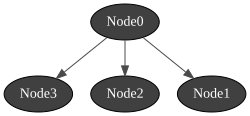

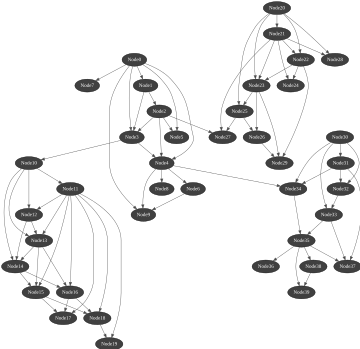

In [7]:
hlr = create_random_bn(4, 2, False)
gnb.showBN(hlr)
clustered_network = create_clustered_network(40, 4, hlr)
gnb.showBN(clustered_network)

The code used to perform compositional inference on a list of subnetworks

In [13]:
def inference(sn):
    mrf = MarkovRandomField.fromBN(sn)
    inf_engine = gum.ShaferShenoyMRFInference(mrf)
    #inf_engine = gum.LoopyBeliefPropagation(sn)
    #inf_engine = gum.ShaferShenoyInference(sn)
    #inf_engine = gum.LoopyGibbsSampling(sn)
    #inf_engine.setPeriodSize(400)
    inf_engine.makeInference()
    for node in sn.names():
        print(inf_engine.posterior(node))
    return inf_engine
        
def update_children(sns, i, inf_engine, hlr):
    children = []
    for sn in hlr.nodes():
        if i in hlr.parents(sn):
            children.append(sn)
    for child in children:
        node = find_node(sns[child], i)
        prob = inf_engine.posterior(node)
        sns[child].cpt(node).fillWith([prob[0], prob[1]])
        
def find_node(subnetwork, i):
    for node in subnetwork.names():
        if node.startswith(f"sn_{i}_"):
            found_node = node
            break
    return found_node

def compositional_analysis(sns, hlr):
    n = len(sns)
    analysis_computed = np.zeros(n)
    analysis_enabled = np.zeros(n)
    
    hl_nodes = hlr.nodes()
    
    for i in range(n):
        if len(hlr.parents(i)) == 0:
            analysis_enabled[i] = 1
    
    while not np.all(analysis_computed):
        for i in range(n):
            for x in hlr.parents(i):
                if analysis_computed[x] == 1:
                    analysis_enabled[i] = 1
                else:
                    analysis_enabled[i] = 0
                    break
            
            if analysis_enabled[i] == 1 and analysis_computed[i] == 0:
                inf_engine = inference(sns[i])
                update_children(sns, i, inf_engine, hlr)
                analysis_computed[i] = 1

Examples of how to show a Bayesian Network

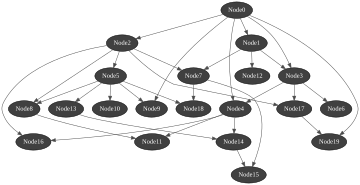

In [15]:
n = 20  # Number of nodes
m = 2  # Maximum number of parents per node

bn = create_random_bn(n, m, True)

gnb.showBN(bn)

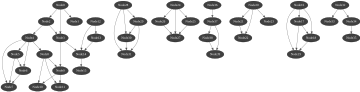

In [19]:
hlr = create_random_bn(4, 2, False)
clustered_network = create_clustered_network(40, 10, hlr)
gnb.showBN(clustered_network)

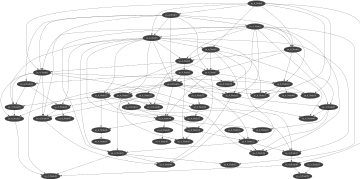

In [9]:
#subnetwork_size = 4
#bn = create_random_bn(4, 2)
#gnb.showBN(bn)
#bn.parents(3)
subnetworks, hlr = create_k_subnetworks(50, 50, 4)

gnb.showBN(subnetworks[4])

#for sn in subnetworks:
#    gnb.showBN(sn)

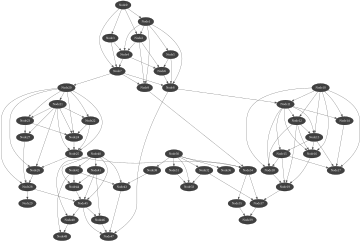

In [10]:
n = 50

high_level = create_random_bn(int(n/10), 3, False)

test_bn = create_clustered_network(n, int(n/10), high_level)

gnb.showBN(test_bn)

In [13]:
sns, hl, _ = create_k_subnetworks(300, 25, 3)

print("Created Network")

start = time.time()
compositional_analysis(sns, hl)
end = time.time()

print(end-start)

Created Network

  sn_0_Node24      |
0        |1        |
---------|---------|
 0.4507  | 0.5493  |


  sn_0_Node0       |
0        |1        |
---------|---------|
 0.7275  | 0.2725  |


  sn_0_Node15      |
0        |1        |
---------|---------|
 0.3807  | 0.6193  |


  sn_0_Node11      |
0        |1        |
---------|---------|
 0.4213  | 0.5787  |


  sn_0_Node22      |
0        |1        |
---------|---------|
 0.2735  | 0.7265  |


  sn_0_Node20      |
0        |1        |
---------|---------|
 0.6095  | 0.3905  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.4315  | 0.5685  |


  sn_0_Node18      |
0        |1        |
---------|---------|
 0.6607  | 0.3393  |


  sn_0_Node4       |
0        |1        |
---------|---------|
 0.5107  | 0.4893  |


  sn_0_Node12      |
0        |1        |
---------|---------|
 0.3546  | 0.6454  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.4067  | 0.5933  |


  sn_0_Node13      |
0        |1     


  sn_18_Node16     |
0        |1        |
---------|---------|
 0.6370  | 0.3630  |


  sn_18_Node13     |
0        |1        |
---------|---------|
 0.4450  | 0.5550  |


  sn_18_Node8      |
0        |1        |
---------|---------|
 0.3952  | 0.6048  |


  sn_18_Node0      |
0        |1        |
---------|---------|
 0.2938  | 0.7062  |


  sn_18_Node7      |
0        |1        |
---------|---------|
 0.6900  | 0.3100  |


  sn_18_Node1      |
0        |1        |
---------|---------|
 0.5245  | 0.4755  |


  sn_18_Node5      |
0        |1        |
---------|---------|
 0.1422  | 0.8578  |


  sn_18_Node4      |
0        |1        |
---------|---------|
 0.4566  | 0.5434  |


  sn_9_Node22      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_18_Node10     |
0        |1        |
---------|---------|
 0.1868  | 0.8132  |


  sn_18_Node20     |
0        |1        |
---------|---------|
 0.4692  | 0.5308  |


  sn_18_Node15     |
0        |1        |
---------|-


  sn_36_Node4      |
0        |1        |
---------|---------|
 0.5052  | 0.4948  |


  sn_36_Node6      |
0        |1        |
---------|---------|
 0.4610  | 0.5390  |


  sn_36_Node10     |
0        |1        |
---------|---------|
 0.7265  | 0.2735  |


  sn_36_Node23     |
0        |1        |
---------|---------|
 0.3535  | 0.6465  |


  sn_36_Node17     |
0        |1        |
---------|---------|
 0.4335  | 0.5665  |


  sn_36_Node0      |
0        |1        |
---------|---------|
 0.6886  | 0.3114  |


  sn_37_Node17     |
0        |1        |
---------|---------|
 0.4985  | 0.5015  |


  sn_37_Node21     |
0        |1        |
---------|---------|
 0.3014  | 0.6986  |


  sn_37_Node4      |
0        |1        |
---------|---------|
 0.4840  | 0.5160  |


  sn_37_Node20     |
0        |1        |
---------|---------|
 0.4978  | 0.5022  |


  sn_37_Node6      |
0        |1        |
---------|---------|
 0.4291  | 0.5709  |


  sn_37_Node3      |
0        |1        |
---------|-


  sn_55_Node6      |
0        |1        |
---------|---------|
 0.4627  | 0.5373  |


  sn_55_Node8      |
0        |1        |
---------|---------|
 0.5164  | 0.4836  |


  sn_55_Node15     |
0        |1        |
---------|---------|
 0.3577  | 0.6423  |


  sn_55_Node20     |
0        |1        |
---------|---------|
 0.6096  | 0.3904  |


  sn_55_Node4      |
0        |1        |
---------|---------|
 0.3515  | 0.6485  |


  sn_55_Node19     |
0        |1        |
---------|---------|
 0.5384  | 0.4616  |


  sn_55_Node3      |
0        |1        |
---------|---------|
 0.2394  | 0.7606  |


  sn_55_Node24     |
0        |1        |
---------|---------|
 0.3382  | 0.6618  |


  sn_55_Node18     |
0        |1        |
---------|---------|
 0.4815  | 0.5185  |


  sn_55_Node2      |
0        |1        |
---------|---------|
 0.5866  | 0.4134  |


  sn_55_Node5      |
0        |1        |
---------|---------|
 0.3716  | 0.6284  |


  sn_21_Node20     |
0        |1        |
---------|-


  sn_73_Node23     |
0        |1        |
---------|---------|
 0.6867  | 0.3133  |


  sn_73_Node12     |
0        |1        |
---------|---------|
 0.5383  | 0.4617  |


  sn_73_Node11     |
0        |1        |
---------|---------|
 0.6522  | 0.3478  |


  sn_73_Node20     |
0        |1        |
---------|---------|
 0.5321  | 0.4679  |


  sn_73_Node14     |
0        |1        |
---------|---------|
 0.3622  | 0.6378  |


  sn_73_Node8      |
0        |1        |
---------|---------|
 0.4579  | 0.5421  |


  sn_73_Node10     |
0        |1        |
---------|---------|
 0.6135  | 0.3865  |


  sn_73_Node13     |
0        |1        |
---------|---------|
 0.6832  | 0.3168  |


  sn_73_Node18     |
0        |1        |
---------|---------|
 0.6823  | 0.3177  |


  sn_73_Node9      |
0        |1        |
---------|---------|
 0.5796  | 0.4204  |


  sn_73_Node2      |
0        |1        |
---------|---------|
 0.5589  | 0.4411  |


  sn_73_Node19     |
0        |1        |
---------|-


  sn_92_Node11     |
0        |1        |
---------|---------|
 0.4612  | 0.5388  |


  sn_92_Node21     |
0        |1        |
---------|---------|
 0.5323  | 0.4677  |


  sn_92_Node0      |
0        |1        |
---------|---------|
 0.1809  | 0.8191  |


  sn_92_Node7      |
0        |1        |
---------|---------|
 0.3387  | 0.6613  |


  sn_92_Node15     |
0        |1        |
---------|---------|
 0.5149  | 0.4851  |


  sn_92_Node17     |
0        |1        |
---------|---------|
 0.3764  | 0.6236  |


  sn_92_Node6      |
0        |1        |
---------|---------|
 0.5410  | 0.4590  |


  sn_92_Node23     |
0        |1        |
---------|---------|
 0.2104  | 0.7896  |


  sn_92_Node4      |
0        |1        |
---------|---------|
 0.5927  | 0.4073  |


  sn_92_Node18     |
0        |1        |
---------|---------|
 0.7173  | 0.2827  |


  sn_92_Node22     |
0        |1        |
---------|---------|
 0.6130  | 0.3870  |


  sn_92_Node20     |
0        |1        |
---------|-


  sn_111_Node10    |
0        |1        |
---------|---------|
 0.4306  | 0.5694  |


  sn_111_Node1     |
0        |1        |
---------|---------|
 0.1202  | 0.8798  |


  sn_111_Node21    |
0        |1        |
---------|---------|
 0.6681  | 0.3319  |


  sn_111_Node17    |
0        |1        |
---------|---------|
 0.6420  | 0.3580  |


  sn_111_Node14    |
0        |1        |
---------|---------|
 0.4700  | 0.5300  |


  sn_111_Node11    |
0        |1        |
---------|---------|
 0.4852  | 0.5148  |


  sn_111_Node16    |
0        |1        |
---------|---------|
 0.3988  | 0.6012  |


  sn_111_Node5     |
0        |1        |
---------|---------|
 0.3048  | 0.6952  |


  sn_111_Node4     |
0        |1        |
---------|---------|
 0.1833  | 0.8167  |


  sn_111_Node24    |
0        |1        |
---------|---------|
 0.3889  | 0.6111  |


  sn_111_Node12    |
0        |1        |
---------|---------|
 0.7028  | 0.2972  |


  sn_111_Node9     |
0        |1        |
---------|-


  sn_129_Node10    |
0        |1        |
---------|---------|
 0.4472  | 0.5528  |


  sn_130_Node15    |
0        |1        |
---------|---------|
 0.3605  | 0.6395  |


  sn_130_Node6     |
0        |1        |
---------|---------|
 0.4684  | 0.5316  |


  sn_130_Node4     |
0        |1        |
---------|---------|
 0.6429  | 0.3571  |


  sn_130_Node5     |
0        |1        |
---------|---------|
 0.5629  | 0.4371  |


  sn_130_Node23    |
0        |1        |
---------|---------|
 0.5993  | 0.4007  |


  sn_130_Node9     |
0        |1        |
---------|---------|
 0.4604  | 0.5396  |


  sn_130_Node24    |
0        |1        |
---------|---------|
 0.5380  | 0.4620  |


  sn_130_Node19    |
0        |1        |
---------|---------|
 0.5866  | 0.4134  |


  sn_130_Node11    |
0        |1        |
---------|---------|
 0.2569  | 0.7431  |


  sn_130_Node14    |
0        |1        |
---------|---------|
 0.4646  | 0.5354  |


  sn_29_Node5      |
0        |1        |
---------|-


  sn_149_Node16    |
0        |1        |
---------|---------|
 0.3805  | 0.6195  |


  sn_149_Node0     |
0        |1        |
---------|---------|
 0.6906  | 0.3094  |


  sn_149_Node8     |
0        |1        |
---------|---------|
 0.4036  | 0.5964  |


  sn_149_Node1     |
0        |1        |
---------|---------|
 0.4123  | 0.5877  |


  sn_149_Node3     |
0        |1        |
---------|---------|
 0.5697  | 0.4303  |


  sn_149_Node21    |
0        |1        |
---------|---------|
 0.3222  | 0.6778  |


  sn_149_Node6     |
0        |1        |
---------|---------|
 0.6410  | 0.3590  |


  sn_149_Node4     |
0        |1        |
---------|---------|
 0.3833  | 0.6167  |


  sn_149_Node11    |
0        |1        |
---------|---------|
 0.6050  | 0.3950  |


  sn_149_Node14    |
0        |1        |
---------|---------|
 0.3279  | 0.6721  |


  sn_149_Node22    |
0        |1        |
---------|---------|
 0.5016  | 0.4984  |


  sn_149_Node24    |
0        |1        |
---------|-


  sn_169_Node23    |
0        |1        |
---------|---------|
 0.4509  | 0.5491  |


  sn_169_Node3     |
0        |1        |
---------|---------|
 0.4824  | 0.5176  |


  sn_169_Node0     |
0        |1        |
---------|---------|
 0.0856  | 0.9144  |


  sn_169_Node1     |
0        |1        |
---------|---------|
 0.6053  | 0.3947  |


  sn_169_Node2     |
0        |1        |
---------|---------|
 0.6207  | 0.3793  |


  sn_160_Node3     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_169_Node20    |
0        |1        |
---------|---------|
 0.5794  | 0.4206  |


  sn_49_Node6      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_170_Node18    |
0        |1        |
---------|---------|
 0.4707  | 0.5293  |


  sn_170_Node0     |
0        |1        |
---------|---------|
 0.6111  | 0.3889  |


  sn_170_Node22    |
0        |1        |
---------|---------|
 0.6143  | 0.3857  |


  sn_170_Node12    |
0        |1        |
---------|-


  sn_187_Node1     |
0        |1        |
---------|---------|
 0.3985  | 0.6015  |


  sn_187_Node22    |
0        |1        |
---------|---------|
 0.4952  | 0.5048  |


  sn_187_Node19    |
0        |1        |
---------|---------|
 0.4240  | 0.5760  |


  sn_187_Node24    |
0        |1        |
---------|---------|
 0.3359  | 0.6641  |


  sn_187_Node12    |
0        |1        |
---------|---------|
 0.6042  | 0.3958  |


  sn_187_Node11    |
0        |1        |
---------|---------|
 0.7536  | 0.2464  |


  sn_187_Node13    |
0        |1        |
---------|---------|
 0.4368  | 0.5632  |


  sn_187_Node15    |
0        |1        |
---------|---------|
 0.6304  | 0.3696  |


  sn_187_Node2     |
0        |1        |
---------|---------|
 0.6382  | 0.3618  |


  sn_187_Node23    |
0        |1        |
---------|---------|
 0.5857  | 0.4143  |


  sn_187_Node5     |
0        |1        |
---------|---------|
 0.2214  | 0.7786  |


  sn_187_Node21    |
0        |1        |
---------|-


  sn_202_Node18    |
0        |1        |
---------|---------|
 0.5933  | 0.4067  |


  sn_202_Node0     |
0        |1        |
---------|---------|
 0.5828  | 0.4172  |


  sn_202_Node6     |
0        |1        |
---------|---------|
 0.5654  | 0.4346  |


  sn_202_Node1     |
0        |1        |
---------|---------|
 0.4898  | 0.5102  |


  sn_202_Node19    |
0        |1        |
---------|---------|
 0.2600  | 0.7400  |


  sn_202_Node23    |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_48_Node8      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_202_Node12    |
0        |1        |
---------|---------|
 0.2948  | 0.7052  |


  sn_202_Node3     |
0        |1        |
---------|---------|
 0.5098  | 0.4902  |


  sn_104_Node3     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_202_Node14    |
0        |1        |
---------|---------|
 0.3364  | 0.6636  |


  sn_203_Node0     |
0        |1        |
---------|-


  sn_217_Node7     |
0        |1        |
---------|---------|
 0.4120  | 0.5880  |


  sn_217_Node9     |
0        |1        |
---------|---------|
 0.5625  | 0.4375  |


  sn_217_Node21    |
0        |1        |
---------|---------|
 0.6981  | 0.3019  |


  sn_217_Node23    |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_217_Node20    |
0        |1        |
---------|---------|
 0.5895  | 0.4105  |


  sn_217_Node14    |
0        |1        |
---------|---------|
 0.3171  | 0.6829  |


  sn_217_Node11    |
0        |1        |
---------|---------|
 0.6688  | 0.3312  |


  sn_217_Node0     |
0        |1        |
---------|---------|
 0.3647  | 0.6353  |


  sn_217_Node6     |
0        |1        |
---------|---------|
 0.6441  | 0.3559  |


  sn_217_Node2     |
0        |1        |
---------|---------|
 0.6705  | 0.3295  |


  sn_149_Node24    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_217_Node1     |
0        |1        |
---------|-


  sn_235_Node20    |
0        |1        |
---------|---------|
 0.5340  | 0.4660  |


  sn_235_Node15    |
0        |1        |
---------|---------|
 0.5336  | 0.4664  |


  sn_235_Node24    |
0        |1        |
---------|---------|
 0.4732  | 0.5268  |


  sn_235_Node7     |
0        |1        |
---------|---------|
 0.5249  | 0.4751  |


  sn_235_Node3     |
0        |1        |
---------|---------|
 0.2707  | 0.7293  |


  sn_235_Node21    |
0        |1        |
---------|---------|
 0.4103  | 0.5897  |


  sn_235_Node14    |
0        |1        |
---------|---------|
 0.5578  | 0.4422  |


  sn_235_Node17    |
0        |1        |
---------|---------|
 0.4929  | 0.5071  |


  sn_235_Node23    |
0        |1        |
---------|---------|
 0.2893  | 0.7107  |


  sn_235_Node12    |
0        |1        |
---------|---------|
 0.7853  | 0.2147  |


  sn_235_Node19    |
0        |1        |
---------|---------|
 0.5220  | 0.4780  |


  sn_235_Node18    |
0        |1        |
---------|-


  sn_185_Node8     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_253_Node1     |
0        |1        |
---------|---------|
 0.2509  | 0.7491  |


  sn_253_Node3     |
0        |1        |
---------|---------|
 0.4985  | 0.5015  |


  sn_254_Node2     |
0        |1        |
---------|---------|
 0.5007  | 0.4993  |


  sn_254_Node3     |
0        |1        |
---------|---------|
 0.5232  | 0.4768  |


  sn_254_Node10    |
0        |1        |
---------|---------|
 0.5100  | 0.4900  |


  sn_254_Node1     |
0        |1        |
---------|---------|
 0.9611  | 0.0389  |


  sn_254_Node14    |
0        |1        |
---------|---------|
 0.4154  | 0.5846  |


  sn_254_Node21    |
0        |1        |
---------|---------|
 0.5409  | 0.4591  |


  sn_76_Node8      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_254_Node18    |
0        |1        |
---------|---------|
 0.5440  | 0.4560  |


  sn_254_Node19    |
0        |1        |
---------|-


  sn_273_Node22    |
0        |1        |
---------|---------|
 0.4840  | 0.5160  |


  sn_273_Node4     |
0        |1        |
---------|---------|
 0.2740  | 0.7260  |


  sn_273_Node11    |
0        |1        |
---------|---------|
 0.3483  | 0.6517  |


  sn_273_Node14    |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_203_Node14    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_273_Node9     |
0        |1        |
---------|---------|
 0.5627  | 0.4373  |


  sn_273_Node7     |
0        |1        |
---------|---------|
 0.5408  | 0.4592  |


  sn_273_Node13    |
0        |1        |
---------|---------|
 0.3601  | 0.6399  |


  sn_194_Node0     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_273_Node0     |
0        |1        |
---------|---------|
 0.8463  | 0.1537  |


  sn_273_Node5     |
0        |1        |
---------|---------|
 0.6480  | 0.3520  |


  sn_273_Node21    |
0        |1        |
---------|-


  sn_292_Node7     |
0        |1        |
---------|---------|
 0.5834  | 0.4166  |


  sn_292_Node11    |
0        |1        |
---------|---------|
 0.7253  | 0.2747  |


  sn_292_Node3     |
0        |1        |
---------|---------|
 0.3026  | 0.6974  |


  sn_292_Node1     |
0        |1        |
---------|---------|
 0.1871  | 0.8129  |


  sn_292_Node23    |
0        |1        |
---------|---------|
 0.4501  | 0.5499  |


  sn_292_Node9     |
0        |1        |
---------|---------|
 0.5733  | 0.4267  |


  sn_292_Node21    |
0        |1        |
---------|---------|
 0.5030  | 0.4970  |


  sn_292_Node4     |
0        |1        |
---------|---------|
 0.5816  | 0.4184  |


  sn_292_Node5     |
0        |1        |
---------|---------|
 0.7135  | 0.2865  |


  sn_292_Node0     |
0        |1        |
---------|---------|
 0.2753  | 0.7247  |


  sn_215_Node8     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_254_Node17    |
0        |1        |
---------|-

In [14]:
CMRF_times = []
num_of_nodes = list(range(1000, 15001, 1000))
for n in num_of_nodes:
    subnetworks, hlr, clustered_network = create_k_subnetworks(int(n/50), 50, 3)

    start = time.time()
    compositional_analysis(subnetworks, hlr)
    end = time.time()
    
    CMRF_times.append(end-start)


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5756  | 0.4244  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.2843  | 0.7157  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.7754  | 0.2246  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.8517  | 0.1483  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.4544  | 0.5456  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.7580  | 0.2420  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.6060  | 0.3940  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5344  | 0.4656  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.3829  | 0.6171  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.7517  | 0.2483  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.5199  | 0.4801  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.7135  | 0.2865  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.5206  | 0.4794  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.2271  | 0.7729  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.3179  | 0.6821  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.5900  | 0.4100  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.4097  | 0.5903  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.6121  | 0.3879  |


  sn_2_Node19      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.3881  | 0.6119  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.4251  | 0.5749  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.4218  | 0.5782  |


  sn_7_Node32      |
0        |1        |
---------|-


  sn_14_Node2      |
0        |1        |
---------|---------|
 0.5219  | 0.4781  |


  sn_3_Node20      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_14_Node44     |
0        |1        |
---------|---------|
 0.8072  | 0.1928  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 0.2875  | 0.7125  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 0.6436  | 0.3564  |


  sn_14_Node14     |
0        |1        |
---------|---------|
 0.6564  | 0.3436  |


  sn_4_Node3       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_14_Node21     |
0        |1        |
---------|---------|
 0.3776  | 0.6224  |


  sn_14_Node26     |
0        |1        |
---------|---------|
 0.5233  | 0.4767  |


  sn_14_Node25     |
0        |1        |
---------|---------|
 0.7193  | 0.2807  |


  sn_14_Node28     |
0        |1        |
---------|---------|
 0.5059  | 0.4941  |


  sn_14_Node32     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5903  | 0.4097  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5513  | 0.4487  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.2760  | 0.7240  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.5116  | 0.4884  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.5134  | 0.4866  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.4020  | 0.5980  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.2625  | 0.7375  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5305  | 0.4695  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4896  | 0.5104  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.5398  | 0.4602  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.3509  | 0.6491  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.5970  | 0.4030  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.5928  | 0.4072  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.5269  | 0.4731  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.5375  | 0.4625  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.5139  | 0.4861  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.4452  | 0.5548  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.4925  | 0.5075  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.8376  | 0.1624  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.5085  | 0.4915  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.5263  | 0.4737  |


  sn_7_Node32      |
0        |1        |
---------|---------|
 0.1943  | 0.8057  |


  sn_7_Node45      |
0        |1        |
---------|-


  sn_1_Node27      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_15_Node6      |
0        |1        |
---------|---------|
 0.5933  | 0.4067  |


  sn_15_Node32     |
0        |1        |
---------|---------|
 0.5240  | 0.4760  |


  sn_15_Node24     |
0        |1        |
---------|---------|
 0.4333  | 0.5667  |


  sn_15_Node5      |
0        |1        |
---------|---------|
 0.5831  | 0.4169  |


  sn_15_Node38     |
0        |1        |
---------|---------|
 0.5393  | 0.4607  |


  sn_15_Node10     |
0        |1        |
---------|---------|
 0.4323  | 0.5677  |


  sn_15_Node18     |
0        |1        |
---------|---------|
 0.3912  | 0.6088  |


  sn_4_Node31      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_15_Node36     |
0        |1        |
---------|---------|
 0.4881  | 0.5119  |


  sn_15_Node7      |
0        |1        |
---------|---------|
 0.5054  | 0.4946  |


  sn_15_Node17     |
0        |1        |
---------|-


  sn_25_Node10     |
0        |1        |
---------|---------|
 0.3685  | 0.6315  |


  sn_25_Node35     |
0        |1        |
---------|---------|
 0.4682  | 0.5318  |


  sn_25_Node14     |
0        |1        |
---------|---------|
 0.5886  | 0.4114  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_25_Node45     |
0        |1        |
---------|---------|
 0.7662  | 0.2338  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_25_Node30     |
0        |1        |
---------|---------|
 0.2645  | 0.7355  |


  sn_25_Node22     |
0        |1        |
---------|---------|
 0.3285  | 0.6715  |


  sn_25_Node47     |
0        |1        |
---------|---------|
 0.6111  | 0.3889  |


  sn_25_Node48     |
0        |1        |
---------|---------|
 0.3626  | 0.6374  |


  sn_25_Node2      |
0        |1        |
---------|---------|
 0.4835  | 0.5165  |


  sn_25_Node24     |
0        |1        |
---------|-


  sn_33_Node5      |
0        |1        |
---------|---------|
 0.3088  | 0.6912  |


  sn_25_Node35     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_33_Node13     |
0        |1        |
---------|---------|
 0.4839  | 0.5161  |


  sn_33_Node45     |
0        |1        |
---------|---------|
 0.1888  | 0.8112  |


  sn_33_Node1      |
0        |1        |
---------|---------|
 0.4143  | 0.5857  |


  sn_33_Node29     |
0        |1        |
---------|---------|
 0.5148  | 0.4852  |


  sn_33_Node42     |
0        |1        |
---------|---------|
 0.3660  | 0.6340  |


  sn_33_Node17     |
0        |1        |
---------|---------|
 0.4475  | 0.5525  |


  sn_33_Node6      |
0        |1        |
---------|---------|
 0.3518  | 0.6482  |


  sn_33_Node10     |
0        |1        |
---------|---------|
 0.5113  | 0.4887  |


  sn_33_Node35     |
0        |1        |
---------|---------|
 0.3657  | 0.6343  |


  sn_33_Node30     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.4906  | 0.5094  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5931  | 0.4069  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5344  | 0.4656  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.5855  | 0.4145  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.4997  | 0.5003  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.5025  | 0.4975  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.7157  | 0.2843  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.6363  | 0.3637  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.2183  | 0.7817  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.5959  | 0.4041  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.5298  | 0.4702  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node26      |
0        |1        |
---------|---------|
 0.6202  | 0.3798  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 0.4237  | 0.5763  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 0.3245  | 0.6755  |


  sn_6_Node32      |
0        |1        |
---------|---------|
 0.4902  | 0.5098  |


  sn_6_Node47      |
0        |1        |
---------|---------|
 0.3326  | 0.6674  |


  sn_6_Node1       |
0        |1        |
---------|---------|
 0.5735  | 0.4265  |


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.3726  | 0.6274  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.5220  | 0.4780  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.7721  | 0.2279  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.6057  | 0.3943  |


  sn_6_Node6       |
0        |1        |
---------|---------|
 0.4692  | 0.5308  |


  sn_6_Node43      |
0        |1        |
---------|-


  sn_13_Node5      |
0        |1        |
---------|---------|
 0.5090  | 0.4910  |


  sn_13_Node21     |
0        |1        |
---------|---------|
 0.4739  | 0.5261  |


  sn_13_Node2      |
0        |1        |
---------|---------|
 0.3804  | 0.6196  |


  sn_13_Node25     |
0        |1        |
---------|---------|
 0.7694  | 0.2306  |


  sn_13_Node48     |
0        |1        |
---------|---------|
 0.4510  | 0.5490  |


  sn_13_Node10     |
0        |1        |
---------|---------|
 0.5476  | 0.4524  |


  sn_13_Node29     |
0        |1        |
---------|---------|
 0.2680  | 0.7320  |


  sn_13_Node45     |
0        |1        |
---------|---------|
 0.5225  | 0.4775  |


  sn_13_Node8      |
0        |1        |
---------|---------|
 0.4759  | 0.5241  |


  sn_13_Node6      |
0        |1        |
---------|---------|
 0.5495  | 0.4505  |


  sn_13_Node37     |
0        |1        |
---------|---------|
 0.4251  | 0.5749  |


  sn_13_Node15     |
0        |1        |
---------|-


  sn_21_Node49     |
0        |1        |
---------|---------|
 0.3462  | 0.6538  |


  sn_21_Node10     |
0        |1        |
---------|---------|
 0.3862  | 0.6138  |


  sn_21_Node25     |
0        |1        |
---------|---------|
 0.4832  | 0.5168  |


  sn_21_Node26     |
0        |1        |
---------|---------|
 0.5656  | 0.4344  |


  sn_21_Node27     |
0        |1        |
---------|---------|
 0.3739  | 0.6261  |


  sn_21_Node44     |
0        |1        |
---------|---------|
 0.4089  | 0.5911  |


  sn_21_Node45     |
0        |1        |
---------|---------|
 0.3047  | 0.6953  |


  sn_21_Node24     |
0        |1        |
---------|---------|
 0.5939  | 0.4061  |


  sn_21_Node1      |
0        |1        |
---------|---------|
 0.2733  | 0.7267  |


  sn_21_Node21     |
0        |1        |
---------|---------|
 0.4556  | 0.5444  |


  sn_21_Node0      |
0        |1        |
---------|---------|
 0.3459  | 0.6541  |


  sn_21_Node43     |
0        |1        |
---------|-


  sn_32_Node24     |
0        |1        |
---------|---------|
 0.8366  | 0.1634  |


  sn_32_Node41     |
0        |1        |
---------|---------|
 0.4445  | 0.5555  |


  sn_32_Node9      |
0        |1        |
---------|---------|
 0.6019  | 0.3981  |


  sn_32_Node43     |
0        |1        |
---------|---------|
 0.3945  | 0.6055  |


  sn_32_Node36     |
0        |1        |
---------|---------|
 0.5759  | 0.4241  |


  sn_32_Node35     |
0        |1        |
---------|---------|
 0.4105  | 0.5895  |


  sn_32_Node25     |
0        |1        |
---------|---------|
 0.4272  | 0.5728  |


  sn_32_Node38     |
0        |1        |
---------|---------|
 0.5319  | 0.4681  |


  sn_32_Node49     |
0        |1        |
---------|---------|
 0.7008  | 0.2992  |


  sn_32_Node30     |
0        |1        |
---------|---------|
 0.3566  | 0.6434  |


  sn_32_Node20     |
0        |1        |
---------|---------|
 0.5069  | 0.4931  |


  sn_32_Node18     |
0        |1        |
---------|-


  sn_40_Node2      |
0        |1        |
---------|---------|
 0.4355  | 0.5645  |


  sn_40_Node15     |
0        |1        |
---------|---------|
 0.5508  | 0.4492  |


  sn_40_Node39     |
0        |1        |
---------|---------|
 0.4674  | 0.5326  |


  sn_40_Node45     |
0        |1        |
---------|---------|
 0.4699  | 0.5301  |


  sn_40_Node14     |
0        |1        |
---------|---------|
 0.4350  | 0.5650  |


  sn_40_Node0      |
0        |1        |
---------|---------|
 0.6102  | 0.3898  |


  sn_40_Node37     |
0        |1        |
---------|---------|
 0.4440  | 0.5560  |


  sn_40_Node41     |
0        |1        |
---------|---------|
 0.5008  | 0.4992  |


  sn_40_Node44     |
0        |1        |
---------|---------|
 0.6747  | 0.3253  |


  sn_40_Node46     |
0        |1        |
---------|---------|
 0.1608  | 0.8392  |


  sn_4_Node10      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_40_Node34     |
0        |1        |
---------|-


  sn_49_Node32     |
0        |1        |
---------|---------|
 0.3790  | 0.6210  |


  sn_49_Node18     |
0        |1        |
---------|---------|
 0.5142  | 0.4858  |


  sn_49_Node1      |
0        |1        |
---------|---------|
 0.9251  | 0.0749  |


  sn_37_Node36     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_49_Node19     |
0        |1        |
---------|---------|
 0.2865  | 0.7135  |


  sn_49_Node5      |
0        |1        |
---------|---------|
 0.4973  | 0.5027  |


  sn_49_Node29     |
0        |1        |
---------|---------|
 0.5677  | 0.4323  |


  sn_49_Node15     |
0        |1        |
---------|---------|
 0.5536  | 0.4464  |


  sn_49_Node22     |
0        |1        |
---------|---------|
 0.5411  | 0.4589  |


  sn_49_Node24     |
0        |1        |
---------|---------|
 0.5378  | 0.4622  |


  sn_49_Node27     |
0        |1        |
---------|---------|
 0.5553  | 0.4447  |


  sn_49_Node25     |
0        |1        |
---------|-


  sn_56_Node28     |
0        |1        |
---------|---------|
 0.5707  | 0.4293  |


  sn_56_Node20     |
0        |1        |
---------|---------|
 0.2858  | 0.7142  |


  sn_56_Node9      |
0        |1        |
---------|---------|
 0.4942  | 0.5058  |


  sn_56_Node25     |
0        |1        |
---------|---------|
 0.2681  | 0.7319  |


  sn_56_Node27     |
0        |1        |
---------|---------|
 0.5411  | 0.4589  |


  sn_56_Node14     |
0        |1        |
---------|---------|
 0.3292  | 0.6708  |


  sn_56_Node33     |
0        |1        |
---------|---------|
 0.4963  | 0.5037  |


  sn_56_Node17     |
0        |1        |
---------|---------|
 0.6493  | 0.3507  |


  sn_56_Node36     |
0        |1        |
---------|---------|
 0.5505  | 0.4495  |


  sn_56_Node37     |
0        |1        |
---------|---------|
 0.4535  | 0.5465  |


  sn_56_Node35     |
0        |1        |
---------|---------|
 0.5635  | 0.4365  |


  sn_56_Node45     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.4864  | 0.5136  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5735  | 0.4265  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.0781  | 0.9219  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.4132  | 0.5868  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.5472  | 0.4528  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.3981  | 0.6019  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.2989  | 0.7011  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5557  | 0.4443  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4549  | 0.5451  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.6463  | 0.3537  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.3740  | 0.6260  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.2509  | 0.7491  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.5250  | 0.4750  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.4790  | 0.5210  |


  sn_2_Node9       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.4316  | 0.5684  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.3366  | 0.6634  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.3936  | 0.6064  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.3479  | 0.6521  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.6293  | 0.3707  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.5136  | 0.4864  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.6055  | 0.3945  |


  sn_7_Node32      |
0        |1        |
---------|-


  sn_14_Node2      |
0        |1        |
---------|---------|
 0.9101  | 0.0899  |


  sn_14_Node44     |
0        |1        |
---------|---------|
 0.6720  | 0.3280  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 0.4545  | 0.5455  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 0.4244  | 0.5756  |


  sn_14_Node14     |
0        |1        |
---------|---------|
 0.6507  | 0.3493  |


  sn_14_Node21     |
0        |1        |
---------|---------|
 0.4873  | 0.5127  |


  sn_14_Node26     |
0        |1        |
---------|---------|
 0.5934  | 0.4066  |


  sn_14_Node25     |
0        |1        |
---------|---------|
 0.4214  | 0.5786  |


  sn_14_Node28     |
0        |1        |
---------|---------|
 0.3885  | 0.6115  |


  sn_14_Node32     |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_14_Node39     |
0        |1        |
---------|---------|
 0.3311  | 0.6689  |


  sn_14_Node23     |
0        |1        |
---------|-


  sn_21_Node49     |
0        |1        |
---------|---------|
 0.5408  | 0.4592  |


  sn_11_Node19     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_21_Node10     |
0        |1        |
---------|---------|
 0.6657  | 0.3343  |


  sn_21_Node25     |
0        |1        |
---------|---------|
 0.5645  | 0.4355  |


  sn_21_Node26     |
0        |1        |
---------|---------|
 0.5960  | 0.4040  |


  sn_21_Node27     |
0        |1        |
---------|---------|
 0.4438  | 0.5562  |


  sn_21_Node44     |
0        |1        |
---------|---------|
 0.3667  | 0.6333  |


  sn_21_Node45     |
0        |1        |
---------|---------|
 0.5688  | 0.4312  |


  sn_21_Node24     |
0        |1        |
---------|---------|
 0.4027  | 0.5973  |


  sn_21_Node1      |
0        |1        |
---------|---------|
 0.3546  | 0.6454  |


  sn_21_Node21     |
0        |1        |
---------|---------|
 0.5198  | 0.4802  |


  sn_21_Node0      |
0        |1        |
---------|-


  sn_28_Node25     |
0        |1        |
---------|---------|
 0.4526  | 0.5474  |


  sn_28_Node33     |
0        |1        |
---------|---------|
 0.5792  | 0.4208  |


  sn_28_Node4      |
0        |1        |
---------|---------|
 0.1654  | 0.8346  |


  sn_28_Node1      |
0        |1        |
---------|---------|
 0.4171  | 0.5829  |


  sn_28_Node12     |
0        |1        |
---------|---------|
 0.6658  | 0.3342  |


  sn_3_Node2       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_28_Node42     |
0        |1        |
---------|---------|
 0.3907  | 0.6093  |


  sn_28_Node14     |
0        |1        |
---------|---------|
 0.4961  | 0.5039  |


  sn_28_Node37     |
0        |1        |
---------|---------|
 0.3699  | 0.6301  |


  sn_28_Node2      |
0        |1        |
---------|---------|
 0.2714  | 0.7286  |


  sn_29_Node15     |
0        |1        |
---------|---------|
 0.5325  | 0.4675  |


  sn_29_Node32     |
0        |1        |
---------|-


  sn_36_Node15     |
0        |1        |
---------|---------|
 0.4647  | 0.5353  |


  sn_36_Node17     |
0        |1        |
---------|---------|
 0.3344  | 0.6656  |


  sn_36_Node32     |
0        |1        |
---------|---------|
 0.2680  | 0.7320  |


  sn_36_Node42     |
0        |1        |
---------|---------|
 0.5412  | 0.4588  |


  sn_36_Node36     |
0        |1        |
---------|---------|
 0.7368  | 0.2632  |


  sn_36_Node19     |
0        |1        |
---------|---------|
 0.5723  | 0.4277  |


  sn_36_Node7      |
0        |1        |
---------|---------|
 0.5873  | 0.4127  |


  sn_36_Node46     |
0        |1        |
---------|---------|
 0.5450  | 0.4550  |


  sn_36_Node43     |
0        |1        |
---------|---------|
 0.3135  | 0.6865  |


  sn_36_Node10     |
0        |1        |
---------|---------|
 0.5314  | 0.4686  |


  sn_36_Node28     |
0        |1        |
---------|---------|
 0.4330  | 0.5670  |


  sn_36_Node33     |
0        |1        |
---------|-


  sn_47_Node25     |
0        |1        |
---------|---------|
 0.4324  | 0.5676  |


  sn_47_Node21     |
0        |1        |
---------|---------|
 0.3188  | 0.6812  |


  sn_47_Node37     |
0        |1        |
---------|---------|
 0.3950  | 0.6050  |


  sn_47_Node32     |
0        |1        |
---------|---------|
 0.4853  | 0.5147  |


  sn_47_Node44     |
0        |1        |
---------|---------|
 0.3746  | 0.6254  |


  sn_47_Node42     |
0        |1        |
---------|---------|
 0.4578  | 0.5422  |


  sn_47_Node17     |
0        |1        |
---------|---------|
 0.5057  | 0.4943  |


  sn_47_Node30     |
0        |1        |
---------|---------|
 0.5168  | 0.4832  |


  sn_4_Node26      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_47_Node3      |
0        |1        |
---------|---------|
 0.6463  | 0.3537  |


  sn_47_Node9      |
0        |1        |
---------|---------|
 0.6515  | 0.3485  |


  sn_0_Node25      |
0        |1        |
---------|-


  sn_58_Node43     |
0        |1        |
---------|---------|
 0.6922  | 0.3078  |


  sn_51_Node30     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_58_Node16     |
0        |1        |
---------|---------|
 0.3375  | 0.6625  |


  sn_58_Node6      |
0        |1        |
---------|---------|
 0.4938  | 0.5062  |


  sn_58_Node33     |
0        |1        |
---------|---------|
 0.3414  | 0.6586  |


  sn_58_Node20     |
0        |1        |
---------|---------|
 0.4506  | 0.5494  |


  sn_58_Node31     |
0        |1        |
---------|---------|
 0.3953  | 0.6047  |


  sn_58_Node32     |
0        |1        |
---------|---------|
 0.4150  | 0.5850  |


  sn_58_Node41     |
0        |1        |
---------|---------|
 0.5072  | 0.4928  |


  sn_58_Node0      |
0        |1        |
---------|---------|
 0.2326  | 0.7674  |


  sn_58_Node29     |
0        |1        |
---------|---------|
 0.4310  | 0.5690  |


  sn_58_Node34     |
0        |1        |
---------|-


  sn_65_Node24     |
0        |1        |
---------|---------|
 0.5898  | 0.4102  |


  sn_65_Node38     |
0        |1        |
---------|---------|
 0.5243  | 0.4757  |


  sn_65_Node48     |
0        |1        |
---------|---------|
 0.4667  | 0.5333  |


  sn_65_Node29     |
0        |1        |
---------|---------|
 0.2910  | 0.7090  |


  sn_65_Node12     |
0        |1        |
---------|---------|
 0.5436  | 0.4564  |


  sn_65_Node13     |
0        |1        |
---------|---------|
 0.4071  | 0.5929  |


  sn_65_Node46     |
0        |1        |
---------|---------|
 0.5839  | 0.4161  |


  sn_65_Node42     |
0        |1        |
---------|---------|
 0.5029  | 0.4971  |


  sn_65_Node44     |
0        |1        |
---------|---------|
 0.7291  | 0.2709  |


  sn_65_Node41     |
0        |1        |
---------|---------|
 0.3708  | 0.6292  |


  sn_65_Node3      |
0        |1        |
---------|---------|
 0.6792  | 0.3208  |


  sn_65_Node45     |
0        |1        |
---------|-


  sn_72_Node11     |
0        |1        |
---------|---------|
 0.3911  | 0.6089  |


  sn_72_Node42     |
0        |1        |
---------|---------|
 0.4129  | 0.5871  |


  sn_72_Node48     |
0        |1        |
---------|---------|
 0.3294  | 0.6706  |


  sn_72_Node29     |
0        |1        |
---------|---------|
 0.5377  | 0.4623  |


  sn_72_Node44     |
0        |1        |
---------|---------|
 0.5107  | 0.4893  |


  sn_72_Node18     |
0        |1        |
---------|---------|
 0.3684  | 0.6316  |


  sn_72_Node9      |
0        |1        |
---------|---------|
 0.6340  | 0.3660  |


  sn_72_Node47     |
0        |1        |
---------|---------|
 0.2632  | 0.7368  |


  sn_72_Node26     |
0        |1        |
---------|---------|
 0.4857  | 0.5143  |


  sn_33_Node29     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_72_Node34     |
0        |1        |
---------|---------|
 0.4450  | 0.5550  |


  sn_72_Node14     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.3716  | 0.6284  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5138  | 0.4862  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5782  | 0.4218  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.5178  | 0.4822  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.1696  | 0.8304  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.3510  | 0.6490  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.5835  | 0.4165  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5934  | 0.4066  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.6251  | 0.3749  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.6910  | 0.3090  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.5186  | 0.4814  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.4149  | 0.5851  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.4271  | 0.5729  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.5051  | 0.4949  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.7006  | 0.2994  |


  sn_6_Node6       |
0        |1        |
---------|---------|
 0.4353  | 0.5647  |


  sn_6_Node43      |
0        |1        |
---------|---------|
 0.6459  | 0.3541  |


  sn_6_Node3       |
0        |1        |
---------|---------|
 0.2442  | 0.7558  |


  sn_6_Node42      |
0        |1        |
---------|---------|
 0.2667  | 0.7333  |


  sn_6_Node14      |
0        |1        |
---------|---------|
 0.5937  | 0.4063  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_6_Node10      |
0        |1        |
---------|---------|
 0.5994  | 0.4006  |


  sn_6_Node22      |
0        |1        |
---------|-


  sn_13_Node31     |
0        |1        |
---------|---------|
 0.5938  | 0.4062  |


  sn_13_Node39     |
0        |1        |
---------|---------|
 0.7328  | 0.2672  |


  sn_13_Node11     |
0        |1        |
---------|---------|
 0.4512  | 0.5488  |


  sn_13_Node32     |
0        |1        |
---------|---------|
 0.3717  | 0.6283  |


  sn_13_Node20     |
0        |1        |
---------|---------|
 0.6976  | 0.3024  |


  sn_13_Node34     |
0        |1        |
---------|---------|
 0.3427  | 0.6573  |


  sn_13_Node1      |
0        |1        |
---------|---------|
 0.3263  | 0.6737  |


  sn_13_Node49     |
0        |1        |
---------|---------|
 0.6118  | 0.3882  |


  sn_13_Node17     |
0        |1        |
---------|---------|
 0.5642  | 0.4358  |


  sn_13_Node28     |
0        |1        |
---------|---------|
 0.4814  | 0.5186  |


  sn_13_Node4      |
0        |1        |
---------|---------|
 0.4066  | 0.5934  |


  sn_13_Node47     |
0        |1        |
---------|-


  sn_23_Node4      |
0        |1        |
---------|---------|
 0.3830  | 0.6170  |


  sn_23_Node7      |
0        |1        |
---------|---------|
 0.4488  | 0.5512  |


  sn_23_Node33     |
0        |1        |
---------|---------|
 0.4494  | 0.5506  |


  sn_23_Node9      |
0        |1        |
---------|---------|
 0.4238  | 0.5762  |


  sn_23_Node44     |
0        |1        |
---------|---------|
 0.2713  | 0.7287  |


  sn_23_Node20     |
0        |1        |
---------|---------|
 0.6849  | 0.3151  |


  sn_23_Node48     |
0        |1        |
---------|---------|
 0.5356  | 0.4644  |


  sn_23_Node5      |
0        |1        |
---------|---------|
 0.6461  | 0.3539  |


  sn_23_Node17     |
0        |1        |
---------|---------|
 0.4683  | 0.5317  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_23_Node32     |
0        |1        |
---------|---------|
 0.6144  | 0.3856  |


  sn_23_Node18     |
0        |1        |
---------|-


  sn_30_Node34     |
0        |1        |
---------|---------|
 0.6766  | 0.3234  |


  sn_17_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_30_Node2      |
0        |1        |
---------|---------|
 0.5262  | 0.4738  |


  sn_30_Node42     |
0        |1        |
---------|---------|
 0.7310  | 0.2690  |


  sn_30_Node19     |
0        |1        |
---------|---------|
 0.5698  | 0.4302  |


  sn_30_Node31     |
0        |1        |
---------|---------|
 0.3794  | 0.6206  |


  sn_30_Node40     |
0        |1        |
---------|---------|
 0.5019  | 0.4981  |


  sn_30_Node36     |
0        |1        |
---------|---------|
 0.5329  | 0.4671  |


  sn_30_Node28     |
0        |1        |
---------|---------|
 0.5166  | 0.4834  |


  sn_29_Node22     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_30_Node20     |
0        |1        |
---------|---------|
 0.5856  | 0.4144  |


  sn_30_Node41     |
0        |1        |
---------|-


  sn_38_Node9      |
0        |1        |
---------|---------|
 0.4345  | 0.5655  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_38_Node18     |
0        |1        |
---------|---------|
 0.5667  | 0.4333  |


  sn_38_Node32     |
0        |1        |
---------|---------|
 0.3511  | 0.6489  |


  sn_38_Node5      |
0        |1        |
---------|---------|
 0.3620  | 0.6380  |


  sn_38_Node26     |
0        |1        |
---------|---------|
 0.5552  | 0.4448  |


  sn_38_Node35     |
0        |1        |
---------|---------|
 0.4756  | 0.5244  |


  sn_38_Node44     |
0        |1        |
---------|---------|
 0.2598  | 0.7402  |


  sn_38_Node13     |
0        |1        |
---------|---------|
 0.4935  | 0.5065  |


  sn_38_Node10     |
0        |1        |
---------|---------|
 0.6092  | 0.3908  |


  sn_38_Node15     |
0        |1        |
---------|---------|
 0.4263  | 0.5737  |


  sn_22_Node10     |
0        |1        |
---------|-


  sn_47_Node1      |
0        |1        |
---------|---------|
 0.5078  | 0.4922  |


  sn_47_Node36     |
0        |1        |
---------|---------|
 0.4779  | 0.5221  |


  sn_48_Node18     |
0        |1        |
---------|---------|
 0.5918  | 0.4082  |


  sn_48_Node22     |
0        |1        |
---------|---------|
 0.5475  | 0.4525  |


  sn_48_Node25     |
0        |1        |
---------|---------|
 0.7186  | 0.2814  |


  sn_48_Node4      |
0        |1        |
---------|---------|
 0.5064  | 0.4936  |


  sn_48_Node31     |
0        |1        |
---------|---------|
 0.4368  | 0.5632  |


  sn_48_Node9      |
0        |1        |
---------|---------|
 0.4716  | 0.5284  |


  sn_48_Node23     |
0        |1        |
---------|---------|
 0.2523  | 0.7477  |


  sn_48_Node34     |
0        |1        |
---------|---------|
 0.5136  | 0.4864  |


  sn_48_Node49     |
0        |1        |
---------|---------|
 0.4686  | 0.5314  |


  sn_48_Node48     |
0        |1        |
---------|-


  sn_55_Node43     |
0        |1        |
---------|---------|
 0.8691  | 0.1309  |


  sn_55_Node35     |
0        |1        |
---------|---------|
 0.3355  | 0.6645  |


  sn_55_Node25     |
0        |1        |
---------|---------|
 0.5168  | 0.4832  |


  sn_55_Node41     |
0        |1        |
---------|---------|
 0.5789  | 0.4211  |


  sn_55_Node16     |
0        |1        |
---------|---------|
 0.5678  | 0.4322  |


  sn_55_Node22     |
0        |1        |
---------|---------|
 0.3391  | 0.6609  |


  sn_55_Node17     |
0        |1        |
---------|---------|
 0.6965  | 0.3035  |


  sn_55_Node28     |
0        |1        |
---------|---------|
 0.3299  | 0.6701  |


  sn_55_Node19     |
0        |1        |
---------|---------|
 0.2709  | 0.7291  |


  sn_38_Node17     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_55_Node9      |
0        |1        |
---------|---------|
 0.6202  | 0.3798  |


  sn_55_Node27     |
0        |1        |
---------|-


  sn_62_Node10     |
0        |1        |
---------|---------|
 0.3764  | 0.6236  |


  sn_62_Node41     |
0        |1        |
---------|---------|
 0.6992  | 0.3008  |


  sn_62_Node43     |
0        |1        |
---------|---------|
 0.4204  | 0.5796  |


  sn_62_Node48     |
0        |1        |
---------|---------|
 0.6157  | 0.3843  |


  sn_62_Node3      |
0        |1        |
---------|---------|
 0.6558  | 0.3442  |


  sn_62_Node30     |
0        |1        |
---------|---------|
 0.1604  | 0.8396  |


  sn_62_Node8      |
0        |1        |
---------|---------|
 0.4732  | 0.5268  |


  sn_62_Node15     |
0        |1        |
---------|---------|
 0.6241  | 0.3759  |


  sn_62_Node32     |
0        |1        |
---------|---------|
 0.4562  | 0.5438  |


  sn_62_Node25     |
0        |1        |
---------|---------|
 0.3672  | 0.6328  |


  sn_62_Node40     |
0        |1        |
---------|---------|
 0.3952  | 0.6048  |


  sn_62_Node47     |
0        |1        |
---------|-


  sn_69_Node8      |
0        |1        |
---------|---------|
 0.5709  | 0.4291  |


  sn_69_Node17     |
0        |1        |
---------|---------|
 0.6804  | 0.3196  |


  sn_69_Node16     |
0        |1        |
---------|---------|
 0.5006  | 0.4994  |


  sn_69_Node20     |
0        |1        |
---------|---------|
 0.4963  | 0.5037  |


  sn_69_Node12     |
0        |1        |
---------|---------|
 0.3969  | 0.6031  |


  sn_69_Node23     |
0        |1        |
---------|---------|
 0.6721  | 0.3279  |


  sn_69_Node27     |
0        |1        |
---------|---------|
 0.4614  | 0.5386  |


  sn_69_Node25     |
0        |1        |
---------|---------|
 0.5394  | 0.4606  |


  sn_69_Node2      |
0        |1        |
---------|---------|
 0.8797  | 0.1203  |


  sn_69_Node39     |
0        |1        |
---------|---------|
 0.7965  | 0.2035  |


  sn_69_Node49     |
0        |1        |
---------|---------|
 0.5543  | 0.4457  |


  sn_69_Node22     |
0        |1        |
---------|-


  sn_77_Node35     |
0        |1        |
---------|---------|
 0.6050  | 0.3950  |


  sn_77_Node42     |
0        |1        |
---------|---------|
 0.2116  | 0.7884  |


  sn_77_Node26     |
0        |1        |
---------|---------|
 0.7181  | 0.2819  |


  sn_77_Node19     |
0        |1        |
---------|---------|
 0.6187  | 0.3813  |


  sn_77_Node10     |
0        |1        |
---------|---------|
 0.6686  | 0.3314  |


  sn_77_Node46     |
0        |1        |
---------|---------|
 0.5749  | 0.4251  |


  sn_77_Node49     |
0        |1        |
---------|---------|
 0.5389  | 0.4611  |


  sn_77_Node27     |
0        |1        |
---------|---------|
 0.8933  | 0.1067  |


  sn_77_Node24     |
0        |1        |
---------|---------|
 0.5562  | 0.4438  |


  sn_77_Node25     |
0        |1        |
---------|---------|
 0.6609  | 0.3391  |


  sn_77_Node5      |
0        |1        |
---------|---------|
 0.6598  | 0.3402  |


  sn_77_Node1      |
0        |1        |
---------|-


  sn_84_Node49     |
0        |1        |
---------|---------|
 0.6247  | 0.3753  |


  sn_84_Node11     |
0        |1        |
---------|---------|
 0.5113  | 0.4887  |


  sn_84_Node38     |
0        |1        |
---------|---------|
 0.6167  | 0.3833  |


  sn_84_Node9      |
0        |1        |
---------|---------|
 0.3749  | 0.6251  |


  sn_84_Node13     |
0        |1        |
---------|---------|
 0.6257  | 0.3743  |


  sn_77_Node10     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_84_Node18     |
0        |1        |
---------|---------|
 0.3695  | 0.6305  |


  sn_84_Node30     |
0        |1        |
---------|---------|
 0.5311  | 0.4689  |


  sn_84_Node32     |
0        |1        |
---------|---------|
 0.5184  | 0.4816  |


  sn_84_Node10     |
0        |1        |
---------|---------|
 0.3690  | 0.6310  |


  sn_84_Node7      |
0        |1        |
---------|---------|
 0.2391  | 0.7609  |


  sn_84_Node33     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.4773  | 0.5227  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.4733  | 0.5267  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.7991  | 0.2009  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.6519  | 0.3481  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.4714  | 0.5286  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.3929  | 0.6071  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.4669  | 0.5331  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.4771  | 0.5229  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.6454  | 0.3546  |


  sn_45_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.3856  | 0.6144  |


  sn_91_Node4      |
0        |1        |
---------|-


  sn_97_Node3      |
0        |1        |
---------|---------|
 0.6787  | 0.3213  |


  sn_97_Node22     |
0        |1        |
---------|---------|
 0.5540  | 0.4460  |


  sn_97_Node29     |
0        |1        |
---------|---------|
 0.6806  | 0.3194  |


  sn_97_Node30     |
0        |1        |
---------|---------|
 0.7985  | 0.2015  |


  sn_97_Node42     |
0        |1        |
---------|---------|
 0.4308  | 0.5692  |


  sn_97_Node24     |
0        |1        |
---------|---------|
 0.5468  | 0.4532  |


  sn_97_Node47     |
0        |1        |
---------|---------|
 0.4497  | 0.5503  |


  sn_97_Node34     |
0        |1        |
---------|---------|
 0.3177  | 0.6823  |


  sn_97_Node46     |
0        |1        |
---------|---------|
 0.4977  | 0.5023  |


  sn_97_Node28     |
0        |1        |
---------|---------|
 0.4880  | 0.5120  |


  sn_97_Node40     |
0        |1        |
---------|---------|
 0.5388  | 0.4612  |


  sn_97_Node45     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5471  | 0.4529  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.6682  | 0.3318  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.3937  | 0.6063  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.5427  | 0.4573  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.6769  | 0.3231  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.6065  | 0.3935  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.5965  | 0.4035  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.3300  | 0.6700  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4741  | 0.5259  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.5080  | 0.4920  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.3332  | 0.6668  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.6334  | 0.3666  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.5132  | 0.4868  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.4953  | 0.5047  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.5304  | 0.4696  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.3715  | 0.6285  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.2873  | 0.7127  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.5157  | 0.4843  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.3796  | 0.6204  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.5115  | 0.4885  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.3410  | 0.6590  |


  sn_7_Node32      |
0        |1        |
---------|---------|
 0.8567  | 0.1433  |


  sn_7_Node45      |
0        |1        |
---------|-


  sn_14_Node2      |
0        |1        |
---------|---------|
 0.6233  | 0.3767  |


  sn_14_Node44     |
0        |1        |
---------|---------|
 0.4667  | 0.5333  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 0.7516  | 0.2484  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 0.3532  | 0.6468  |


  sn_14_Node14     |
0        |1        |
---------|---------|
 0.4435  | 0.5565  |


  sn_14_Node21     |
0        |1        |
---------|---------|
 0.3829  | 0.6171  |


  sn_14_Node26     |
0        |1        |
---------|---------|
 0.4823  | 0.5177  |


  sn_14_Node25     |
0        |1        |
---------|---------|
 0.4147  | 0.5853  |


  sn_14_Node28     |
0        |1        |
---------|---------|
 0.7389  | 0.2611  |


  sn_14_Node32     |
0        |1        |
---------|---------|
 0.4619  | 0.5381  |


  sn_14_Node39     |
0        |1        |
---------|---------|
 0.5735  | 0.4265  |


  sn_14_Node23     |
0        |1        |
---------|-


  sn_22_Node23     |
0        |1        |
---------|---------|
 0.4309  | 0.5691  |


  sn_22_Node5      |
0        |1        |
---------|---------|
 0.5431  | 0.4569  |


  sn_22_Node15     |
0        |1        |
---------|---------|
 0.3225  | 0.6775  |


  sn_22_Node38     |
0        |1        |
---------|---------|
 0.5717  | 0.4283  |


  sn_22_Node25     |
0        |1        |
---------|---------|
 0.3382  | 0.6618  |


  sn_22_Node46     |
0        |1        |
---------|---------|
 0.4931  | 0.5069  |


  sn_22_Node20     |
0        |1        |
---------|---------|
 0.5586  | 0.4414  |


  sn_22_Node10     |
0        |1        |
---------|---------|
 0.6317  | 0.3683  |


  sn_22_Node40     |
0        |1        |
---------|---------|
 0.5304  | 0.4696  |


  sn_22_Node17     |
0        |1        |
---------|---------|
 0.5137  | 0.4863  |


  sn_22_Node48     |
0        |1        |
---------|---------|
 0.4179  | 0.5821  |


  sn_22_Node16     |
0        |1        |
---------|-


  sn_30_Node34     |
0        |1        |
---------|---------|
 0.5452  | 0.4548  |


  sn_30_Node2      |
0        |1        |
---------|---------|
 0.7433  | 0.2567  |


  sn_30_Node42     |
0        |1        |
---------|---------|
 0.4310  | 0.5690  |


  sn_30_Node19     |
0        |1        |
---------|---------|
 0.3575  | 0.6425  |


  sn_30_Node31     |
0        |1        |
---------|---------|
 0.5591  | 0.4409  |


  sn_30_Node40     |
0        |1        |
---------|---------|
 0.5796  | 0.4204  |


  sn_30_Node36     |
0        |1        |
---------|---------|
 0.4240  | 0.5760  |


  sn_30_Node28     |
0        |1        |
---------|---------|
 0.5216  | 0.4784  |


  sn_29_Node46     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_30_Node20     |
0        |1        |
---------|---------|
 0.3125  | 0.6875  |


  sn_30_Node41     |
0        |1        |
---------|---------|
 0.4364  | 0.5636  |


  sn_30_Node6      |
0        |1        |
---------|-


  sn_37_Node48     |
0        |1        |
---------|---------|
 0.6577  | 0.3423  |


  sn_37_Node3      |
0        |1        |
---------|---------|
 0.6282  | 0.3718  |


  sn_37_Node37     |
0        |1        |
---------|---------|
 0.4005  | 0.5995  |


  sn_37_Node42     |
0        |1        |
---------|---------|
 0.2188  | 0.7812  |


  sn_37_Node26     |
0        |1        |
---------|---------|
 0.8322  | 0.1678  |


  sn_8_Node38      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_37_Node41     |
0        |1        |
---------|---------|
 0.6054  | 0.3946  |


  sn_37_Node5      |
0        |1        |
---------|---------|
 0.3587  | 0.6413  |


  sn_37_Node36     |
0        |1        |
---------|---------|
 0.3049  | 0.6951  |


  sn_37_Node21     |
0        |1        |
---------|---------|
 0.4321  | 0.5679  |


  sn_37_Node40     |
0        |1        |
---------|---------|
 0.6142  | 0.3858  |


  sn_12_Node5      |
0        |1        |
---------|-


  sn_44_Node17     |
0        |1        |
---------|---------|
 0.5417  | 0.4583  |


  sn_44_Node8      |
0        |1        |
---------|---------|
 0.6258  | 0.3742  |


  sn_44_Node12     |
0        |1        |
---------|---------|
 0.7527  | 0.2473  |


  sn_44_Node19     |
0        |1        |
---------|---------|
 0.0066  | 0.9934  |


  sn_44_Node42     |
0        |1        |
---------|---------|
 0.4667  | 0.5333  |


  sn_5_Node17      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_44_Node38     |
0        |1        |
---------|---------|
 0.4674  | 0.5326  |


  sn_44_Node14     |
0        |1        |
---------|---------|
 0.5073  | 0.4927  |


  sn_44_Node20     |
0        |1        |
---------|---------|
 0.1635  | 0.8365  |


  sn_44_Node32     |
0        |1        |
---------|---------|
 0.4694  | 0.5306  |


  sn_44_Node5      |
0        |1        |
---------|---------|
 0.1392  | 0.8608  |


  sn_44_Node40     |
0        |1        |
---------|-


  sn_51_Node17     |
0        |1        |
---------|---------|
 0.5651  | 0.4349  |


  sn_51_Node18     |
0        |1        |
---------|---------|
 0.6362  | 0.3638  |


  sn_51_Node28     |
0        |1        |
---------|---------|
 0.7601  | 0.2399  |


  sn_51_Node25     |
0        |1        |
---------|---------|
 0.6088  | 0.3912  |


  sn_51_Node5      |
0        |1        |
---------|---------|
 0.4726  | 0.5274  |


  sn_51_Node33     |
0        |1        |
---------|---------|
 0.5895  | 0.4105  |


  sn_51_Node41     |
0        |1        |
---------|---------|
 0.5328  | 0.4672  |


  sn_51_Node16     |
0        |1        |
---------|---------|
 0.4189  | 0.5811  |


  sn_51_Node22     |
0        |1        |
---------|---------|
 0.5170  | 0.4830  |


  sn_51_Node31     |
0        |1        |
---------|---------|
 0.6069  | 0.3931  |


  sn_51_Node37     |
0        |1        |
---------|---------|
 0.5981  | 0.4019  |


  sn_51_Node15     |
0        |1        |
---------|-


  sn_58_Node4      |
0        |1        |
---------|---------|
 0.3547  | 0.6453  |


  sn_58_Node26     |
0        |1        |
---------|---------|
 0.3904  | 0.6096  |


  sn_58_Node2      |
0        |1        |
---------|---------|
 0.7533  | 0.2467  |


  sn_58_Node48     |
0        |1        |
---------|---------|
 0.5079  | 0.4921  |


  sn_58_Node24     |
0        |1        |
---------|---------|
 0.6276  | 0.3724  |


  sn_58_Node11     |
0        |1        |
---------|---------|
 0.4926  | 0.5074  |


  sn_58_Node19     |
0        |1        |
---------|---------|
 0.4919  | 0.5081  |


  sn_59_Node45     |
0        |1        |
---------|---------|
 0.3866  | 0.6134  |


  sn_59_Node17     |
0        |1        |
---------|---------|
 0.4756  | 0.5244  |


  sn_59_Node33     |
0        |1        |
---------|---------|
 0.4804  | 0.5196  |


  sn_59_Node13     |
0        |1        |
---------|---------|
 0.4907  | 0.5093  |


  sn_59_Node21     |
0        |1        |
---------|-


  sn_65_Node24     |
0        |1        |
---------|---------|
 0.4905  | 0.5095  |


  sn_65_Node38     |
0        |1        |
---------|---------|
 0.8380  | 0.1620  |


  sn_65_Node48     |
0        |1        |
---------|---------|
 0.4305  | 0.5695  |


  sn_65_Node29     |
0        |1        |
---------|---------|
 0.4807  | 0.5193  |


  sn_65_Node12     |
0        |1        |
---------|---------|
 0.3465  | 0.6535  |


  sn_65_Node13     |
0        |1        |
---------|---------|
 0.5738  | 0.4262  |


  sn_65_Node46     |
0        |1        |
---------|---------|
 0.7634  | 0.2366  |


  sn_65_Node42     |
0        |1        |
---------|---------|
 0.7221  | 0.2779  |


  sn_65_Node44     |
0        |1        |
---------|---------|
 0.5718  | 0.4282  |


  sn_65_Node41     |
0        |1        |
---------|---------|
 0.7832  | 0.2168  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_65_Node3      |
0        |1        |
---------|-


  sn_72_Node11     |
0        |1        |
---------|---------|
 0.4949  | 0.5051  |


  sn_72_Node42     |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_72_Node48     |
0        |1        |
---------|---------|
 0.5579  | 0.4421  |


  sn_72_Node29     |
0        |1        |
---------|---------|
 0.5989  | 0.4011  |


  sn_72_Node44     |
0        |1        |
---------|---------|
 0.3371  | 0.6629  |


  sn_72_Node18     |
0        |1        |
---------|---------|
 0.5674  | 0.4326  |


  sn_72_Node9      |
0        |1        |
---------|---------|
 0.7164  | 0.2836  |


  sn_72_Node47     |
0        |1        |
---------|---------|
 0.4008  | 0.5992  |


  sn_72_Node26     |
0        |1        |
---------|---------|
 0.4272  | 0.5728  |


  sn_46_Node34     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_72_Node34     |
0        |1        |
---------|---------|
 0.3319  | 0.6681  |


  sn_72_Node14     |
0        |1        |
---------|-


  sn_78_Node32     |
0        |1        |
---------|---------|
 0.6010  | 0.3990  |


  sn_78_Node38     |
0        |1        |
---------|---------|
 0.3999  | 0.6001  |


  sn_78_Node47     |
0        |1        |
---------|---------|
 0.4573  | 0.5427  |


  sn_78_Node19     |
0        |1        |
---------|---------|
 0.6100  | 0.3900  |


  sn_78_Node39     |
0        |1        |
---------|---------|
 0.7279  | 0.2721  |


  sn_78_Node15     |
0        |1        |
---------|---------|
 0.2155  | 0.7845  |


  sn_78_Node27     |
0        |1        |
---------|---------|
 0.5914  | 0.4086  |


  sn_78_Node13     |
0        |1        |
---------|---------|
 0.6240  | 0.3760  |


  sn_78_Node34     |
0        |1        |
---------|---------|
 0.5528  | 0.4472  |


  sn_78_Node5      |
0        |1        |
---------|---------|
 0.1983  | 0.8017  |


  sn_78_Node7      |
0        |1        |
---------|---------|
 0.5110  | 0.4890  |


  sn_78_Node6      |
0        |1        |
---------|-


  sn_84_Node49     |
0        |1        |
---------|---------|
 0.5287  | 0.4713  |


  sn_84_Node11     |
0        |1        |
---------|---------|
 0.4379  | 0.5621  |


  sn_84_Node38     |
0        |1        |
---------|---------|
 0.4337  | 0.5663  |


  sn_84_Node9      |
0        |1        |
---------|---------|
 0.4912  | 0.5088  |


  sn_84_Node13     |
0        |1        |
---------|---------|
 0.7151  | 0.2849  |


  sn_84_Node18     |
0        |1        |
---------|---------|
 0.4522  | 0.5478  |


  sn_84_Node30     |
0        |1        |
---------|---------|
 0.6003  | 0.3997  |


  sn_84_Node32     |
0        |1        |
---------|---------|
 0.5381  | 0.4619  |


  sn_84_Node10     |
0        |1        |
---------|---------|
 0.5633  | 0.4367  |


  sn_84_Node7      |
0        |1        |
---------|---------|
 0.5112  | 0.4888  |


  sn_84_Node33     |
0        |1        |
---------|---------|
 0.5616  | 0.4384  |


  sn_84_Node31     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.4349  | 0.5651  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.7276  | 0.2724  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.3240  | 0.6760  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.4663  | 0.5337  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.5610  | 0.4390  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.2893  | 0.7107  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.6888  | 0.3112  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.5884  | 0.4116  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.5954  | 0.4046  |


  sn_91_Node4      |
0        |1        |
---------|---------|
 0.5437  | 0.4563  |


  sn_91_Node21     |
0        |1        |
---------|-


  sn_98_Node17     |
0        |1        |
---------|---------|
 0.5032  | 0.4968  |


  sn_90_Node19     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_77_Node42     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_98_Node32     |
0        |1        |
---------|---------|
 0.4588  | 0.5412  |


  sn_98_Node35     |
0        |1        |
---------|---------|
 0.5929  | 0.4071  |


  sn_98_Node2      |
0        |1        |
---------|---------|
 0.4791  | 0.5209  |


  sn_98_Node44     |
0        |1        |
---------|---------|
 0.5702  | 0.4298  |


  sn_98_Node13     |
0        |1        |
---------|---------|
 0.4155  | 0.5845  |


  sn_98_Node19     |
0        |1        |
---------|---------|
 0.5257  | 0.4743  |


  sn_98_Node36     |
0        |1        |
---------|---------|
 0.4856  | 0.5144  |


  sn_98_Node21     |
0        |1        |
---------|---------|
 0.4988  | 0.5012  |


  sn_98_Node8      |
0        |1        |
---------|-


  sn_105_Node41    |
0        |1        |
---------|---------|
 0.4639  | 0.5361  |


  sn_105_Node25    |
0        |1        |
---------|---------|
 0.3361  | 0.6639  |


  sn_105_Node5     |
0        |1        |
---------|---------|
 0.2051  | 0.7949  |


  sn_105_Node35    |
0        |1        |
---------|---------|
 0.4291  | 0.5709  |


  sn_105_Node27    |
0        |1        |
---------|---------|
 0.4188  | 0.5812  |


  sn_5_Node33      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_105_Node9     |
0        |1        |
---------|---------|
 0.2590  | 0.7410  |


  sn_105_Node34    |
0        |1        |
---------|---------|
 0.5644  | 0.4356  |


  sn_105_Node3     |
0        |1        |
---------|---------|
 0.4044  | 0.5956  |


  sn_105_Node22    |
0        |1        |
---------|---------|
 0.2516  | 0.7484  |


  sn_92_Node0      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_105_Node1     |
0        |1        |
---------|-


  sn_113_Node40    |
0        |1        |
---------|---------|
 0.5945  | 0.4055  |


  sn_113_Node30    |
0        |1        |
---------|---------|
 0.2536  | 0.7464  |


  sn_113_Node39    |
0        |1        |
---------|---------|
 0.4998  | 0.5002  |


  sn_113_Node41    |
0        |1        |
---------|---------|
 0.4090  | 0.5910  |


  sn_113_Node10    |
0        |1        |
---------|---------|
 0.3720  | 0.6280  |


  sn_113_Node37    |
0        |1        |
---------|---------|
 0.4339  | 0.5661  |


  sn_113_Node7     |
0        |1        |
---------|---------|
 0.8040  | 0.1960  |


  sn_113_Node29    |
0        |1        |
---------|---------|
 0.5117  | 0.4883  |


  sn_113_Node33    |
0        |1        |
---------|---------|
 0.4836  | 0.5164  |


  sn_113_Node22    |
0        |1        |
---------|---------|
 0.6585  | 0.3415  |


  sn_53_Node13     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_113_Node9     |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.4791  | 0.5209  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.4830  | 0.5170  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5050  | 0.4950  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.4472  | 0.5528  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.5157  | 0.4843  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.5894  | 0.4106  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.6347  | 0.3653  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.4132  | 0.5868  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4931  | 0.5069  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.4364  | 0.5636  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.4249  | 0.5751  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node26      |
0        |1        |
---------|---------|
 0.4631  | 0.5369  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 0.4727  | 0.5273  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 0.4106  | 0.5894  |


  sn_6_Node32      |
0        |1        |
---------|---------|
 0.5771  | 0.4229  |


  sn_6_Node47      |
0        |1        |
---------|---------|
 0.5017  | 0.4983  |


  sn_6_Node1       |
0        |1        |
---------|---------|
 0.3025  | 0.6975  |


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.3821  | 0.6179  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.4700  | 0.5300  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.7017  | 0.2983  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.6709  | 0.3291  |


  sn_6_Node6       |
0        |1        |
---------|---------|
 0.4570  | 0.5430  |


  sn_6_Node43      |
0        |1        |
---------|-


  sn_13_Node31     |
0        |1        |
---------|---------|
 0.4199  | 0.5801  |


  sn_13_Node39     |
0        |1        |
---------|---------|
 0.4624  | 0.5376  |


  sn_13_Node11     |
0        |1        |
---------|---------|
 0.8262  | 0.1738  |


  sn_13_Node32     |
0        |1        |
---------|---------|
 0.5057  | 0.4943  |


  sn_13_Node20     |
0        |1        |
---------|---------|
 0.3883  | 0.6117  |


  sn_13_Node34     |
0        |1        |
---------|---------|
 0.5729  | 0.4271  |


  sn_13_Node1      |
0        |1        |
---------|---------|
 0.2207  | 0.7793  |


  sn_13_Node49     |
0        |1        |
---------|---------|
 0.6020  | 0.3980  |


  sn_13_Node17     |
0        |1        |
---------|---------|
 0.4921  | 0.5079  |


  sn_13_Node28     |
0        |1        |
---------|---------|
 0.3399  | 0.6601  |


  sn_13_Node4      |
0        |1        |
---------|---------|
 0.3201  | 0.6799  |


  sn_13_Node47     |
0        |1        |
---------|-


  sn_20_Node32     |
0        |1        |
---------|---------|
 0.4728  | 0.5272  |


  sn_20_Node46     |
0        |1        |
---------|---------|
 0.5742  | 0.4258  |


  sn_17_Node20     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_20_Node36     |
0        |1        |
---------|---------|
 0.7055  | 0.2945  |


  sn_20_Node28     |
0        |1        |
---------|---------|
 0.4230  | 0.5770  |


  sn_20_Node9      |
0        |1        |
---------|---------|
 0.4369  | 0.5631  |


  sn_20_Node42     |
0        |1        |
---------|---------|
 0.5602  | 0.4398  |


  sn_20_Node10     |
0        |1        |
---------|---------|
 0.4582  | 0.5418  |


  sn_13_Node49     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_20_Node18     |
0        |1        |
---------|---------|
 0.3853  | 0.6147  |


  sn_20_Node3      |
0        |1        |
---------|---------|
 0.4799  | 0.5201  |


  sn_20_Node20     |
0        |1        |
---------|-


  sn_27_Node29     |
0        |1        |
---------|---------|
 0.4814  | 0.5186  |


  sn_27_Node40     |
0        |1        |
---------|---------|
 0.8162  | 0.1838  |


  sn_27_Node11     |
0        |1        |
---------|---------|
 0.5241  | 0.4759  |


  sn_27_Node30     |
0        |1        |
---------|---------|
 0.4068  | 0.5932  |


  sn_27_Node43     |
0        |1        |
---------|---------|
 0.4390  | 0.5610  |


  sn_27_Node15     |
0        |1        |
---------|---------|
 0.5895  | 0.4105  |


  sn_27_Node48     |
0        |1        |
---------|---------|
 0.4609  | 0.5391  |


  sn_27_Node49     |
0        |1        |
---------|---------|
 0.6006  | 0.3994  |


  sn_27_Node19     |
0        |1        |
---------|---------|
 0.4002  | 0.5998  |


  sn_27_Node47     |
0        |1        |
---------|---------|
 0.4361  | 0.5639  |


  sn_27_Node32     |
0        |1        |
---------|---------|
 0.4394  | 0.5606  |


  sn_27_Node20     |
0        |1        |
---------|-


  sn_36_Node15     |
0        |1        |
---------|---------|
 0.2520  | 0.7480  |


  sn_36_Node17     |
0        |1        |
---------|---------|
 0.4411  | 0.5589  |


  sn_36_Node32     |
0        |1        |
---------|---------|
 0.2029  | 0.7971  |


  sn_36_Node42     |
0        |1        |
---------|---------|
 0.5750  | 0.4250  |


  sn_2_Node35      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_36_Node36     |
0        |1        |
---------|---------|
 0.8149  | 0.1851  |


  sn_36_Node19     |
0        |1        |
---------|---------|
 0.6780  | 0.3220  |


  sn_36_Node7      |
0        |1        |
---------|---------|
 0.4878  | 0.5122  |


  sn_36_Node46     |
0        |1        |
---------|---------|
 0.5418  | 0.4582  |


  sn_34_Node49     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_36_Node43     |
0        |1        |
---------|---------|
 0.5959  | 0.4041  |


  sn_36_Node10     |
0        |1        |
---------|-


  sn_43_Node13     |
0        |1        |
---------|---------|
 0.4192  | 0.5808  |


  sn_43_Node6      |
0        |1        |
---------|---------|
 0.7202  | 0.2798  |


  sn_19_Node20     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_43_Node36     |
0        |1        |
---------|---------|
 0.4751  | 0.5249  |


  sn_43_Node0      |
0        |1        |
---------|---------|
 0.8664  | 0.1336  |


  sn_43_Node49     |
0        |1        |
---------|---------|
 0.7137  | 0.2863  |


  sn_43_Node31     |
0        |1        |
---------|---------|
 0.2926  | 0.7074  |


  sn_43_Node10     |
0        |1        |
---------|---------|
 0.5749  | 0.4251  |


  sn_43_Node46     |
0        |1        |
---------|---------|
 0.1913  | 0.8087  |


  sn_43_Node43     |
0        |1        |
---------|---------|
 0.3760  | 0.6240  |


  sn_43_Node7      |
0        |1        |
---------|---------|
 0.2628  | 0.7372  |


  sn_43_Node48     |
0        |1        |
---------|-


  sn_17_Node0      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_49_Node1      |
0        |1        |
---------|---------|
 0.6284  | 0.3716  |


  sn_49_Node19     |
0        |1        |
---------|---------|
 0.3658  | 0.6342  |


  sn_49_Node5      |
0        |1        |
---------|---------|
 0.4162  | 0.5838  |


  sn_49_Node29     |
0        |1        |
---------|---------|
 0.4939  | 0.5061  |


  sn_49_Node15     |
0        |1        |
---------|---------|
 0.5878  | 0.4122  |


  sn_49_Node22     |
0        |1        |
---------|---------|
 0.5965  | 0.4035  |


  sn_49_Node24     |
0        |1        |
---------|---------|
 0.4135  | 0.5865  |


  sn_49_Node27     |
0        |1        |
---------|---------|
 0.3590  | 0.6410  |


  sn_49_Node25     |
0        |1        |
---------|---------|
 0.4630  | 0.5370  |


  sn_49_Node48     |
0        |1        |
---------|---------|
 0.2149  | 0.7851  |


  sn_49_Node3      |
0        |1        |
---------|-


  sn_48_Node42     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_55_Node49     |
0        |1        |
---------|---------|
 0.5660  | 0.4340  |


  sn_55_Node38     |
0        |1        |
---------|---------|
 0.4238  | 0.5762  |


  sn_55_Node6      |
0        |1        |
---------|---------|
 0.5227  | 0.4773  |


  sn_55_Node21     |
0        |1        |
---------|---------|
 0.2635  | 0.7365  |


  sn_56_Node28     |
0        |1        |
---------|---------|
 0.6117  | 0.3883  |


  sn_56_Node20     |
0        |1        |
---------|---------|
 0.4971  | 0.5029  |


  sn_56_Node9      |
0        |1        |
---------|---------|
 0.3396  | 0.6604  |


  sn_56_Node25     |
0        |1        |
---------|---------|
 0.5562  | 0.4438  |


  sn_56_Node27     |
0        |1        |
---------|---------|
 0.4634  | 0.5366  |


  sn_56_Node14     |
0        |1        |
---------|---------|
 0.3983  | 0.6017  |


  sn_56_Node33     |
0        |1        |
---------|-


  sn_63_Node20     |
0        |1        |
---------|---------|
 0.5036  | 0.4964  |


  sn_63_Node1      |
0        |1        |
---------|---------|
 0.2536  | 0.7464  |


  sn_63_Node41     |
0        |1        |
---------|---------|
 0.5515  | 0.4485  |


  sn_10_Node25     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_63_Node46     |
0        |1        |
---------|---------|
 0.5273  | 0.4727  |


  sn_63_Node0      |
0        |1        |
---------|---------|
 0.7141  | 0.2859  |


  sn_63_Node10     |
0        |1        |
---------|---------|
 0.4679  | 0.5321  |


  sn_63_Node25     |
0        |1        |
---------|---------|
 0.4943  | 0.5057  |


  sn_63_Node4      |
0        |1        |
---------|---------|
 0.8132  | 0.1868  |


  sn_63_Node30     |
0        |1        |
---------|---------|
 0.5707  | 0.4293  |


  sn_63_Node34     |
0        |1        |
---------|---------|
 0.6406  | 0.3594  |


  sn_63_Node8      |
0        |1        |
---------|-


  sn_71_Node26     |
0        |1        |
---------|---------|
 0.4166  | 0.5834  |


  sn_71_Node24     |
0        |1        |
---------|---------|
 0.6045  | 0.3955  |


  sn_71_Node36     |
0        |1        |
---------|---------|
 0.4205  | 0.5795  |


  sn_71_Node43     |
0        |1        |
---------|---------|
 0.4558  | 0.5442  |


  sn_71_Node20     |
0        |1        |
---------|---------|
 0.5737  | 0.4263  |


  sn_71_Node45     |
0        |1        |
---------|---------|
 0.4795  | 0.5205  |


  sn_71_Node16     |
0        |1        |
---------|---------|
 0.4783  | 0.5217  |


  sn_71_Node27     |
0        |1        |
---------|---------|
 0.3635  | 0.6365  |


  sn_71_Node0      |
0        |1        |
---------|---------|
 0.1319  | 0.8681  |


  sn_71_Node42     |
0        |1        |
---------|---------|
 0.5544  | 0.4456  |


  sn_71_Node21     |
0        |1        |
---------|---------|
 0.8793  | 0.1207  |


  sn_71_Node13     |
0        |1        |
---------|-


  sn_48_Node18     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_81_Node1      |
0        |1        |
---------|---------|
 0.5103  | 0.4897  |


  sn_81_Node14     |
0        |1        |
---------|---------|
 0.5187  | 0.4813  |


  sn_81_Node7      |
0        |1        |
---------|---------|
 0.5968  | 0.4032  |


  sn_81_Node27     |
0        |1        |
---------|---------|
 0.5157  | 0.4843  |


  sn_81_Node2      |
0        |1        |
---------|---------|
 0.5202  | 0.4798  |


  sn_81_Node37     |
0        |1        |
---------|---------|
 0.3978  | 0.6022  |


  sn_81_Node32     |
0        |1        |
---------|---------|
 0.5740  | 0.4260  |


  sn_81_Node43     |
0        |1        |
---------|---------|
 0.5987  | 0.4013  |


  sn_81_Node47     |
0        |1        |
---------|---------|
 0.8179  | 0.1821  |


  sn_81_Node12     |
0        |1        |
---------|---------|
 0.4163  | 0.5837  |


  sn_81_Node26     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.3362  | 0.6638  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.4133  | 0.5867  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.7738  | 0.2262  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.3981  | 0.6019  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.4931  | 0.5069  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.3552  | 0.6448  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.3435  | 0.6565  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.6191  | 0.3809  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.7169  | 0.2831  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.5269  | 0.4731  |


  sn_91_Node4      |
0        |1        |
---------|---------|
 0.5771  | 0.4229  |


  sn_91_Node21     |
0        |1        |
---------|-


  sn_98_Node3      |
0        |1        |
---------|---------|
 0.4734  | 0.5266  |


  sn_98_Node25     |
0        |1        |
---------|---------|
 0.5047  | 0.4953  |


  sn_98_Node27     |
0        |1        |
---------|---------|
 0.4067  | 0.5933  |


  sn_98_Node6      |
0        |1        |
---------|---------|
 0.4253  | 0.5747  |


  sn_98_Node26     |
0        |1        |
---------|---------|
 0.7260  | 0.2740  |


  sn_98_Node23     |
0        |1        |
---------|---------|
 0.6791  | 0.3209  |


  sn_98_Node28     |
0        |1        |
---------|---------|
 0.6701  | 0.3299  |


  sn_98_Node41     |
0        |1        |
---------|---------|
 0.6382  | 0.3618  |


  sn_98_Node4      |
0        |1        |
---------|---------|
 0.5809  | 0.4191  |


  sn_98_Node39     |
0        |1        |
---------|---------|
 0.7746  | 0.2254  |


  sn_98_Node45     |
0        |1        |
---------|---------|
 0.5237  | 0.4763  |


  sn_98_Node22     |
0        |1        |
---------|-


  sn_105_Node10    |
0        |1        |
---------|---------|
 0.5617  | 0.4383  |


  sn_105_Node0     |
0        |1        |
---------|---------|
 0.5216  | 0.4784  |


  sn_105_Node29    |
0        |1        |
---------|---------|
 0.5838  | 0.4162  |


  sn_105_Node47    |
0        |1        |
---------|---------|
 0.3160  | 0.6840  |


  sn_105_Node12    |
0        |1        |
---------|---------|
 0.7052  | 0.2948  |


  sn_105_Node30    |
0        |1        |
---------|---------|
 0.3530  | 0.6470  |


  sn_105_Node15    |
0        |1        |
---------|---------|
 0.3881  | 0.6119  |


  sn_105_Node21    |
0        |1        |
---------|---------|
 0.0458  | 0.9542  |


  sn_105_Node31    |
0        |1        |
---------|---------|
 0.3128  | 0.6872  |


  sn_105_Node33    |
0        |1        |
---------|---------|
 0.5962  | 0.4038  |


  sn_105_Node42    |
0        |1        |
---------|---------|
 0.4316  | 0.5684  |


  sn_49_Node47     |
0        |1        |
---------|-


  sn_112_Node5     |
0        |1        |
---------|---------|
 0.5038  | 0.4962  |


  sn_112_Node12    |
0        |1        |
---------|---------|
 0.6666  | 0.3334  |


  sn_39_Node28     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_113_Node40    |
0        |1        |
---------|---------|
 0.6725  | 0.3275  |


  sn_113_Node30    |
0        |1        |
---------|---------|
 0.4825  | 0.5175  |


  sn_113_Node39    |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_113_Node41    |
0        |1        |
---------|---------|
 0.6507  | 0.3493  |


  sn_113_Node10    |
0        |1        |
---------|---------|
 0.5769  | 0.4231  |


  sn_113_Node37    |
0        |1        |
---------|---------|
 0.4948  | 0.5052  |


  sn_30_Node42     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_113_Node7     |
0        |1        |
---------|---------|
 0.6937  | 0.3063  |


  sn_113_Node29    |
0        |1        |
---------|-


  sn_119_Node11    |
0        |1        |
---------|---------|
 0.5788  | 0.4212  |


  sn_119_Node26    |
0        |1        |
---------|---------|
 0.4538  | 0.5462  |


  sn_119_Node41    |
0        |1        |
---------|---------|
 0.5697  | 0.4303  |


  sn_119_Node10    |
0        |1        |
---------|---------|
 0.5581  | 0.4419  |


  sn_119_Node14    |
0        |1        |
---------|---------|
 0.4402  | 0.5598  |


  sn_119_Node30    |
0        |1        |
---------|---------|
 0.4201  | 0.5799  |


  sn_119_Node46    |
0        |1        |
---------|---------|
 0.2821  | 0.7179  |


  sn_119_Node20    |
0        |1        |
---------|---------|
 0.5859  | 0.4141  |


  sn_119_Node23    |
0        |1        |
---------|---------|
 0.4220  | 0.5780  |


  sn_119_Node12    |
0        |1        |
---------|---------|
 0.6069  | 0.3931  |


  sn_119_Node40    |
0        |1        |
---------|---------|
 0.3385  | 0.6615  |


  sn_119_Node18    |
0        |1        |
---------|-


  sn_127_Node29    |
0        |1        |
---------|---------|
 0.4720  | 0.5280  |


  sn_127_Node45    |
0        |1        |
---------|---------|
 0.5019  | 0.4981  |


  sn_127_Node48    |
0        |1        |
---------|---------|
 0.0979  | 0.9021  |


  sn_127_Node20    |
0        |1        |
---------|---------|
 0.4330  | 0.5670  |


  sn_127_Node18    |
0        |1        |
---------|---------|
 0.5394  | 0.4606  |


  sn_127_Node30    |
0        |1        |
---------|---------|
 0.5005  | 0.4995  |


  sn_127_Node35    |
0        |1        |
---------|---------|
 0.4234  | 0.5766  |


  sn_127_Node19    |
0        |1        |
---------|---------|
 0.2878  | 0.7122  |


  sn_127_Node42    |
0        |1        |
---------|---------|
 0.4189  | 0.5811  |


  sn_127_Node23    |
0        |1        |
---------|---------|
 0.4506  | 0.5494  |


  sn_127_Node12    |
0        |1        |
---------|---------|
 0.6552  | 0.3448  |


  sn_127_Node4     |
0        |1        |
---------|-


  sn_134_Node12    |
0        |1        |
---------|---------|
 0.4813  | 0.5187  |


  sn_134_Node37    |
0        |1        |
---------|---------|
 0.6761  | 0.3239  |


  sn_134_Node28    |
0        |1        |
---------|---------|
 0.5199  | 0.4801  |


  sn_134_Node10    |
0        |1        |
---------|---------|
 0.4172  | 0.5828  |


  sn_134_Node30    |
0        |1        |
---------|---------|
 0.5412  | 0.4588  |


  sn_134_Node32    |
0        |1        |
---------|---------|
 0.7497  | 0.2503  |


  sn_134_Node13    |
0        |1        |
---------|---------|
 0.3264  | 0.6736  |


  sn_134_Node1     |
0        |1        |
---------|---------|
 0.7774  | 0.2226  |


  sn_134_Node9     |
0        |1        |
---------|---------|
 0.3255  | 0.6745  |


  sn_134_Node36    |
0        |1        |
---------|---------|
 0.5970  | 0.4030  |


  sn_134_Node27    |
0        |1        |
---------|---------|
 0.5794  | 0.4206  |


  sn_134_Node34    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5753  | 0.4247  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5737  | 0.4263  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.9190  | 0.0810  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.5452  | 0.4548  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.4907  | 0.5093  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.5121  | 0.4879  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.4466  | 0.5534  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.4777  | 0.5223  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.1309  | 0.8691  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.6184  | 0.3816  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.4029  | 0.5971  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.7194  | 0.2806  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.1316  | 0.8684  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.4597  | 0.5403  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.4074  | 0.5926  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.4722  | 0.5278  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.6205  | 0.3795  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.4134  | 0.5866  |


  sn_3_Node29      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.4756  | 0.5244  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.5482  | 0.4518  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.6167  | 0.3833  |


  sn_7_Node32      |
0        |1        |
---------|-


  sn_17_Node11     |
0        |1        |
---------|---------|
 0.4786  | 0.5214  |


  sn_17_Node20     |
0        |1        |
---------|---------|
 0.3657  | 0.6343  |


  sn_17_Node31     |
0        |1        |
---------|---------|
 0.6285  | 0.3715  |


  sn_17_Node28     |
0        |1        |
---------|---------|
 0.3488  | 0.6512  |


  sn_17_Node30     |
0        |1        |
---------|---------|
 0.4687  | 0.5313  |


  sn_17_Node0      |
0        |1        |
---------|---------|
 0.9937  | 0.0063  |


  sn_17_Node38     |
0        |1        |
---------|---------|
 0.7131  | 0.2869  |


  sn_17_Node19     |
0        |1        |
---------|---------|
 0.5911  | 0.4089  |


  sn_17_Node45     |
0        |1        |
---------|---------|
 0.2314  | 0.7686  |


  sn_17_Node5      |
0        |1        |
---------|---------|
 0.6066  | 0.3934  |


  sn_17_Node10     |
0        |1        |
---------|---------|
 0.3923  | 0.6077  |


  sn_17_Node21     |
0        |1        |
---------|-


  sn_24_Node30     |
0        |1        |
---------|---------|
 0.7250  | 0.2750  |


  sn_24_Node46     |
0        |1        |
---------|---------|
 0.6082  | 0.3918  |


  sn_24_Node49     |
0        |1        |
---------|---------|
 0.4812  | 0.5188  |


  sn_24_Node0      |
0        |1        |
---------|---------|
 0.5418  | 0.4582  |


  sn_24_Node1      |
0        |1        |
---------|---------|
 0.5933  | 0.4067  |


  sn_24_Node6      |
0        |1        |
---------|---------|
 0.2835  | 0.7165  |


  sn_24_Node3      |
0        |1        |
---------|---------|
 0.5454  | 0.4546  |


  sn_24_Node5      |
0        |1        |
---------|---------|
 0.4571  | 0.5429  |


  sn_24_Node33     |
0        |1        |
---------|---------|
 0.4765  | 0.5235  |


  sn_24_Node40     |
0        |1        |
---------|---------|
 0.1611  | 0.8389  |


  sn_24_Node12     |
0        |1        |
---------|---------|
 0.3359  | 0.6641  |


  sn_24_Node15     |
0        |1        |
---------|-


  sn_32_Node24     |
0        |1        |
---------|---------|
 0.4616  | 0.5384  |


  sn_32_Node41     |
0        |1        |
---------|---------|
 0.3469  | 0.6531  |


  sn_32_Node9      |
0        |1        |
---------|---------|
 0.5991  | 0.4009  |


  sn_32_Node43     |
0        |1        |
---------|---------|
 0.6166  | 0.3834  |


  sn_32_Node36     |
0        |1        |
---------|---------|
 0.3832  | 0.6168  |


  sn_32_Node35     |
0        |1        |
---------|---------|
 0.5035  | 0.4965  |


  sn_32_Node25     |
0        |1        |
---------|---------|
 0.6314  | 0.3686  |


  sn_32_Node38     |
0        |1        |
---------|---------|
 0.2835  | 0.7165  |


  sn_32_Node49     |
0        |1        |
---------|---------|
 0.5584  | 0.4416  |


  sn_32_Node30     |
0        |1        |
---------|---------|
 0.6814  | 0.3186  |


  sn_32_Node20     |
0        |1        |
---------|---------|
 0.4293  | 0.5707  |


  sn_32_Node18     |
0        |1        |
---------|-


  sn_42_Node19     |
0        |1        |
---------|---------|
 0.5089  | 0.4911  |


  sn_42_Node16     |
0        |1        |
---------|---------|
 0.6201  | 0.3799  |


  sn_42_Node41     |
0        |1        |
---------|---------|
 0.6275  | 0.3725  |


  sn_42_Node46     |
0        |1        |
---------|---------|
 0.4613  | 0.5387  |


  sn_42_Node29     |
0        |1        |
---------|---------|
 0.4381  | 0.5619  |


  sn_36_Node43     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_42_Node20     |
0        |1        |
---------|---------|
 0.2973  | 0.7027  |


  sn_42_Node37     |
0        |1        |
---------|---------|
 0.5343  | 0.4657  |


  sn_42_Node45     |
0        |1        |
---------|---------|
 0.6099  | 0.3901  |


  sn_42_Node7      |
0        |1        |
---------|---------|
 0.7035  | 0.2965  |


  sn_42_Node26     |
0        |1        |
---------|---------|
 0.6048  | 0.3952  |


  sn_42_Node18     |
0        |1        |
---------|-


  sn_51_Node2      |
0        |1        |
---------|---------|
 0.4609  | 0.5391  |


  sn_52_Node6      |
0        |1        |
---------|---------|
 0.4847  | 0.5153  |


  sn_52_Node0      |
0        |1        |
---------|---------|
 0.8620  | 0.1380  |


  sn_52_Node13     |
0        |1        |
---------|---------|
 0.3581  | 0.6419  |


  sn_52_Node15     |
0        |1        |
---------|---------|
 0.7070  | 0.2930  |


  sn_52_Node22     |
0        |1        |
---------|---------|
 0.5657  | 0.4343  |


  sn_52_Node38     |
0        |1        |
---------|---------|
 0.5970  | 0.4030  |


  sn_52_Node31     |
0        |1        |
---------|---------|
 0.0910  | 0.9090  |


  sn_48_Node4      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_52_Node45     |
0        |1        |
---------|---------|
 0.4333  | 0.5667  |


  sn_52_Node40     |
0        |1        |
---------|---------|
 0.3890  | 0.6110  |


  sn_52_Node24     |
0        |1        |
---------|-


  sn_58_Node49     |
0        |1        |
---------|---------|
 0.7447  | 0.2553  |


  sn_58_Node35     |
0        |1        |
---------|---------|
 0.6091  | 0.3909  |


  sn_58_Node14     |
0        |1        |
---------|---------|
 0.4548  | 0.5452  |


  sn_58_Node27     |
0        |1        |
---------|---------|
 0.6575  | 0.3425  |


  sn_58_Node39     |
0        |1        |
---------|---------|
 0.4146  | 0.5854  |


  sn_58_Node42     |
0        |1        |
---------|---------|
 0.4957  | 0.5043  |


  sn_58_Node17     |
0        |1        |
---------|---------|
 0.4105  | 0.5895  |


  sn_58_Node28     |
0        |1        |
---------|---------|
 0.2125  | 0.7875  |


  sn_58_Node13     |
0        |1        |
---------|---------|
 0.4469  | 0.5531  |


  sn_58_Node5      |
0        |1        |
---------|---------|
 0.7692  | 0.2308  |


  sn_58_Node8      |
0        |1        |
---------|---------|
 0.5514  | 0.4486  |


  sn_58_Node12     |
0        |1        |
---------|-


  sn_66_Node28     |
0        |1        |
---------|---------|
 0.3981  | 0.6019  |


  sn_66_Node39     |
0        |1        |
---------|---------|
 0.4250  | 0.5750  |


  sn_66_Node12     |
0        |1        |
---------|---------|
 0.5234  | 0.4766  |


  sn_66_Node32     |
0        |1        |
---------|---------|
 0.4282  | 0.5718  |


  sn_66_Node34     |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_66_Node47     |
0        |1        |
---------|---------|
 0.5532  | 0.4468  |


  sn_66_Node1      |
0        |1        |
---------|---------|
 0.5810  | 0.4190  |


  sn_66_Node6      |
0        |1        |
---------|---------|
 0.6861  | 0.3139  |


  sn_66_Node21     |
0        |1        |
---------|---------|
 0.4713  | 0.5287  |


  sn_66_Node46     |
0        |1        |
---------|---------|
 0.5097  | 0.4903  |


  sn_66_Node23     |
0        |1        |
---------|---------|
 0.4491  | 0.5509  |


  sn_66_Node45     |
0        |1        |
---------|-


  sn_72_Node4      |
0        |1        |
---------|---------|
 0.4537  | 0.5463  |


  sn_72_Node45     |
0        |1        |
---------|---------|
 0.2239  | 0.7761  |


  sn_72_Node22     |
0        |1        |
---------|---------|
 0.4705  | 0.5295  |


  sn_71_Node44     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_72_Node10     |
0        |1        |
---------|---------|
 0.5501  | 0.4499  |


  sn_72_Node27     |
0        |1        |
---------|---------|
 0.3924  | 0.6076  |


  sn_72_Node30     |
0        |1        |
---------|---------|
 0.2233  | 0.7767  |


  sn_72_Node7      |
0        |1        |
---------|---------|
 0.7107  | 0.2893  |


  sn_72_Node49     |
0        |1        |
---------|---------|
 0.6025  | 0.3975  |


  sn_73_Node5      |
0        |1        |
---------|---------|
 0.4905  | 0.5095  |


  sn_73_Node45     |
0        |1        |
---------|---------|
 0.2104  | 0.7896  |


  sn_73_Node20     |
0        |1        |
---------|-


  sn_80_Node2      |
0        |1        |
---------|---------|
 0.3914  | 0.6086  |


  sn_80_Node37     |
0        |1        |
---------|---------|
 0.3675  | 0.6325  |


  sn_80_Node10     |
0        |1        |
---------|---------|
 0.3553  | 0.6447  |


  sn_80_Node19     |
0        |1        |
---------|---------|
 0.6344  | 0.3656  |


  sn_80_Node49     |
0        |1        |
---------|---------|
 0.5309  | 0.4691  |


  sn_80_Node0      |
0        |1        |
---------|---------|
 0.4370  | 0.5630  |


  sn_80_Node25     |
0        |1        |
---------|---------|
 0.4255  | 0.5745  |


  sn_80_Node30     |
0        |1        |
---------|---------|
 0.3603  | 0.6397  |


  sn_80_Node8      |
0        |1        |
---------|---------|
 0.8127  | 0.1873  |


  sn_80_Node6      |
0        |1        |
---------|---------|
 0.3841  | 0.6159  |


  sn_80_Node3      |
0        |1        |
---------|---------|
 0.2401  | 0.7599  |


  sn_80_Node33     |
0        |1        |
---------|-


  sn_87_Node38     |
0        |1        |
---------|---------|
 0.8145  | 0.1855  |


  sn_87_Node29     |
0        |1        |
---------|---------|
 0.4190  | 0.5810  |


  sn_87_Node7      |
0        |1        |
---------|---------|
 0.6314  | 0.3686  |


  sn_87_Node33     |
0        |1        |
---------|---------|
 0.5449  | 0.4551  |


  sn_87_Node43     |
0        |1        |
---------|---------|
 0.5733  | 0.4267  |


  sn_87_Node22     |
0        |1        |
---------|---------|
 0.5948  | 0.4052  |


  sn_87_Node26     |
0        |1        |
---------|---------|
 0.6554  | 0.3446  |


  sn_87_Node35     |
0        |1        |
---------|---------|
 0.5757  | 0.4243  |


  sn_87_Node41     |
0        |1        |
---------|---------|
 0.1352  | 0.8648  |


  sn_87_Node36     |
0        |1        |
---------|---------|
 0.5268  | 0.4732  |


  sn_87_Node4      |
0        |1        |
---------|---------|
 0.7067  | 0.2933  |


  sn_87_Node15     |
0        |1        |
---------|-


  sn_94_Node20     |
0        |1        |
---------|---------|
 0.4257  | 0.5743  |


  sn_94_Node11     |
0        |1        |
---------|---------|
 0.2868  | 0.7132  |


  sn_94_Node6      |
0        |1        |
---------|---------|
 0.5447  | 0.4553  |


  sn_94_Node9      |
0        |1        |
---------|---------|
 0.4901  | 0.5099  |


  sn_94_Node14     |
0        |1        |
---------|---------|
 0.8729  | 0.1271  |


  sn_94_Node0      |
0        |1        |
---------|---------|
 0.6005  | 0.3995  |


  sn_94_Node48     |
0        |1        |
---------|---------|
 0.6939  | 0.3061  |


  sn_94_Node18     |
0        |1        |
---------|---------|
 0.5173  | 0.4827  |


  sn_94_Node1      |
0        |1        |
---------|---------|
 0.6580  | 0.3420  |


  sn_94_Node27     |
0        |1        |
---------|---------|
 0.6455  | 0.3545  |


  sn_94_Node17     |
0        |1        |
---------|---------|
 0.6237  | 0.3763  |


  sn_10_Node15     |
0        |1        |
---------|-


  sn_101_Node4     |
0        |1        |
---------|---------|
 0.4925  | 0.5075  |


  sn_101_Node9     |
0        |1        |
---------|---------|
 0.5132  | 0.4868  |


  sn_101_Node20    |
0        |1        |
---------|---------|
 0.5563  | 0.4437  |


  sn_71_Node45     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_101_Node34    |
0        |1        |
---------|---------|
 0.3184  | 0.6816  |


  sn_101_Node24    |
0        |1        |
---------|---------|
 0.5788  | 0.4212  |


  sn_101_Node42    |
0        |1        |
---------|---------|
 0.6689  | 0.3311  |


  sn_101_Node49    |
0        |1        |
---------|---------|
 0.6148  | 0.3852  |


  sn_101_Node37    |
0        |1        |
---------|---------|
 0.3877  | 0.6123  |


  sn_101_Node1     |
0        |1        |
---------|---------|
 0.5082  | 0.4918  |


  sn_101_Node19    |
0        |1        |
---------|---------|
 0.5285  | 0.4715  |


  sn_101_Node13    |
0        |1        |
---------|-


  sn_109_Node20    |
0        |1        |
---------|---------|
 0.5961  | 0.4039  |


  sn_109_Node13    |
0        |1        |
---------|---------|
 0.6450  | 0.3550  |


  sn_109_Node36    |
0        |1        |
---------|---------|
 0.4722  | 0.5278  |


  sn_109_Node44    |
0        |1        |
---------|---------|
 0.5155  | 0.4845  |


  sn_109_Node48    |
0        |1        |
---------|---------|
 0.5419  | 0.4581  |


  sn_109_Node32    |
0        |1        |
---------|---------|
 0.4721  | 0.5279  |


  sn_109_Node7     |
0        |1        |
---------|---------|
 0.3291  | 0.6709  |


  sn_109_Node22    |
0        |1        |
---------|---------|
 0.6364  | 0.3636  |


  sn_109_Node46    |
0        |1        |
---------|---------|
 0.6314  | 0.3686  |


  sn_109_Node10    |
0        |1        |
---------|---------|
 0.6305  | 0.3695  |


  sn_109_Node47    |
0        |1        |
---------|---------|
 0.2443  | 0.7557  |


  sn_11_Node40     |
0        |1        |
---------|-


  sn_114_Node31    |
0        |1        |
---------|---------|
 0.5703  | 0.4297  |


  sn_114_Node46    |
0        |1        |
---------|---------|
 0.3830  | 0.6170  |


  sn_114_Node18    |
0        |1        |
---------|---------|
 0.6438  | 0.3562  |


  sn_114_Node29    |
0        |1        |
---------|---------|
 0.4155  | 0.5845  |


  sn_114_Node38    |
0        |1        |
---------|---------|
 0.2756  | 0.7244  |


  sn_114_Node7     |
0        |1        |
---------|---------|
 0.4919  | 0.5081  |


  sn_114_Node3     |
0        |1        |
---------|---------|
 0.4754  | 0.5246  |


  sn_114_Node27    |
0        |1        |
---------|---------|
 0.4371  | 0.5629  |


  sn_114_Node33    |
0        |1        |
---------|---------|
 0.5073  | 0.4927  |


  sn_114_Node30    |
0        |1        |
---------|---------|
 0.5907  | 0.4093  |


  sn_114_Node40    |
0        |1        |
---------|---------|
 0.5808  | 0.4192  |


  sn_114_Node12    |
0        |1        |
---------|-


  sn_122_Node43    |
0        |1        |
---------|---------|
 0.0840  | 0.9160  |


  sn_122_Node14    |
0        |1        |
---------|---------|
 0.5453  | 0.4547  |


  sn_122_Node32    |
0        |1        |
---------|---------|
 0.5381  | 0.4619  |


  sn_122_Node21    |
0        |1        |
---------|---------|
 0.4089  | 0.5911  |


  sn_122_Node33    |
0        |1        |
---------|---------|
 0.6483  | 0.3517  |


  sn_122_Node26    |
0        |1        |
---------|---------|
 0.6845  | 0.3155  |


  sn_122_Node10    |
0        |1        |
---------|---------|
 0.3707  | 0.6293  |


  sn_122_Node45    |
0        |1        |
---------|---------|
 0.6314  | 0.3686  |


  sn_122_Node24    |
0        |1        |
---------|---------|
 0.4410  | 0.5590  |


  sn_122_Node28    |
0        |1        |
---------|---------|
 0.4979  | 0.5021  |


  sn_122_Node27    |
0        |1        |
---------|---------|
 0.5655  | 0.4345  |


  sn_122_Node37    |
0        |1        |
---------|-


  sn_129_Node29    |
0        |1        |
---------|---------|
 0.2967  | 0.7033  |


  sn_129_Node18    |
0        |1        |
---------|---------|
 0.5439  | 0.4561  |


  sn_129_Node48    |
0        |1        |
---------|---------|
 0.4973  | 0.5027  |


  sn_129_Node44    |
0        |1        |
---------|---------|
 0.4723  | 0.5277  |


  sn_129_Node6     |
0        |1        |
---------|---------|
 0.3516  | 0.6484  |


  sn_129_Node8     |
0        |1        |
---------|---------|
 0.6496  | 0.3504  |


  sn_129_Node17    |
0        |1        |
---------|---------|
 0.4308  | 0.5692  |


  sn_129_Node21    |
0        |1        |
---------|---------|
 0.7291  | 0.2709  |


  sn_129_Node11    |
0        |1        |
---------|---------|
 0.4003  | 0.5997  |


  sn_129_Node32    |
0        |1        |
---------|---------|
 0.6043  | 0.3957  |


  sn_129_Node0     |
0        |1        |
---------|---------|
 0.4419  | 0.5581  |


  sn_129_Node10    |
0        |1        |
---------|-


  sn_136_Node7     |
0        |1        |
---------|---------|
 0.2805  | 0.7195  |


  sn_136_Node26    |
0        |1        |
---------|---------|
 0.5893  | 0.4107  |


  sn_136_Node49    |
0        |1        |
---------|---------|
 0.4775  | 0.5225  |


  sn_136_Node40    |
0        |1        |
---------|---------|
 0.5509  | 0.4491  |


  sn_136_Node30    |
0        |1        |
---------|---------|
 0.4095  | 0.5905  |


  sn_136_Node11    |
0        |1        |
---------|---------|
 0.2386  | 0.7614  |


  sn_136_Node12    |
0        |1        |
---------|---------|
 0.4505  | 0.5495  |


  sn_136_Node31    |
0        |1        |
---------|---------|
 0.6531  | 0.3469  |


  sn_136_Node47    |
0        |1        |
---------|---------|
 0.5718  | 0.4282  |


  sn_136_Node37    |
0        |1        |
---------|---------|
 0.5024  | 0.4976  |


  sn_136_Node44    |
0        |1        |
---------|---------|
 0.6052  | 0.3948  |


  sn_136_Node15    |
0        |1        |
---------|-


  sn_143_Node38    |
0        |1        |
---------|---------|
 0.6091  | 0.3909  |


  sn_143_Node18    |
0        |1        |
---------|---------|
 0.4363  | 0.5637  |


  sn_143_Node17    |
0        |1        |
---------|---------|
 0.7401  | 0.2599  |


  sn_143_Node13    |
0        |1        |
---------|---------|
 0.5673  | 0.4327  |


  sn_143_Node32    |
0        |1        |
---------|---------|
 0.4999  | 0.5001  |


  sn_143_Node41    |
0        |1        |
---------|---------|
 0.3790  | 0.6210  |


  sn_143_Node4     |
0        |1        |
---------|---------|
 0.6147  | 0.3853  |


  sn_143_Node14    |
0        |1        |
---------|---------|
 0.2022  | 0.7978  |


  sn_143_Node19    |
0        |1        |
---------|---------|
 0.4566  | 0.5434  |


  sn_143_Node0     |
0        |1        |
---------|---------|
 0.7786  | 0.2214  |


  sn_143_Node9     |
0        |1        |
---------|---------|
 0.4367  | 0.5633  |


  sn_143_Node21    |
0        |1        |
---------|-


  sn_150_Node21    |
0        |1        |
---------|---------|
 0.4294  | 0.5706  |


  sn_150_Node38    |
0        |1        |
---------|---------|
 0.7409  | 0.2591  |


  sn_150_Node25    |
0        |1        |
---------|---------|
 0.5356  | 0.4644  |


  sn_150_Node46    |
0        |1        |
---------|---------|
 0.4896  | 0.5104  |


  sn_150_Node36    |
0        |1        |
---------|---------|
 0.4367  | 0.5633  |


  sn_150_Node2     |
0        |1        |
---------|---------|
 0.2215  | 0.7785  |


  sn_150_Node18    |
0        |1        |
---------|---------|
 0.4382  | 0.5618  |


  sn_150_Node13    |
0        |1        |
---------|---------|
 0.7348  | 0.2652  |


  sn_150_Node27    |
0        |1        |
---------|---------|
 0.3498  | 0.6502  |


  sn_150_Node29    |
0        |1        |
---------|---------|
 0.4236  | 0.5764  |


  sn_150_Node43    |
0        |1        |
---------|---------|
 0.4529  | 0.5471  |


  sn_150_Node45    |
0        |1        |
---------|-


  sn_157_Node33    |
0        |1        |
---------|---------|
 0.6964  | 0.3036  |


  sn_157_Node9     |
0        |1        |
---------|---------|
 0.5152  | 0.4848  |


  sn_157_Node34    |
0        |1        |
---------|---------|
 0.4709  | 0.5291  |


  sn_61_Node10     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_157_Node11    |
0        |1        |
---------|---------|
 0.4261  | 0.5739  |


  sn_157_Node10    |
0        |1        |
---------|---------|
 0.4666  | 0.5334  |


  sn_157_Node27    |
0        |1        |
---------|---------|
 0.4848  | 0.5152  |


  sn_157_Node0     |
0        |1        |
---------|---------|
 0.0110  | 0.9890  |


  sn_157_Node22    |
0        |1        |
---------|---------|
 0.4794  | 0.5206  |


  sn_157_Node49    |
0        |1        |
---------|---------|
 0.5804  | 0.4196  |


  sn_43_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_157_Node36    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5254  | 0.4746  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.5803  | 0.4197  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5733  | 0.4267  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.4399  | 0.5601  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.7041  | 0.2959  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.5255  | 0.4745  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.4837  | 0.5163  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.4518  | 0.5482  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.6582  | 0.3418  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.5357  | 0.4643  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.4619  | 0.5381  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.4973  | 0.5027  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.5271  | 0.4729  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.5457  | 0.4543  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.4894  | 0.5106  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.5561  | 0.4439  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.6791  | 0.3209  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.6671  | 0.3329  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.3838  | 0.6162  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.4311  | 0.5689  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.4789  | 0.5211  |


  sn_7_Node32      |
0        |1        |
---------|---------|
 0.4887  | 0.5113  |


  sn_7_Node45      |
0        |1        |
---------|-


  sn_14_Node0      |
0        |1        |
---------|---------|
 0.7758  | 0.2242  |


  sn_14_Node15     |
0        |1        |
---------|---------|
 0.2388  | 0.7612  |


  sn_14_Node49     |
0        |1        |
---------|---------|
 0.6031  | 0.3969  |


  sn_14_Node30     |
0        |1        |
---------|---------|
 0.7156  | 0.2844  |


  sn_14_Node7      |
0        |1        |
---------|---------|
 0.3894  | 0.6106  |


  sn_15_Node6      |
0        |1        |
---------|---------|
 0.4833  | 0.5167  |


  sn_2_Node35      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_15_Node32     |
0        |1        |
---------|---------|
 0.3552  | 0.6448  |


  sn_15_Node24     |
0        |1        |
---------|---------|
 0.4777  | 0.5223  |


  sn_15_Node5      |
0        |1        |
---------|---------|
 0.5258  | 0.4742  |


  sn_15_Node38     |
0        |1        |
---------|---------|
 0.4294  | 0.5706  |


  sn_15_Node10     |
0        |1        |
---------|-


  sn_21_Node49     |
0        |1        |
---------|---------|
 0.5248  | 0.4752  |


  sn_21_Node10     |
0        |1        |
---------|---------|
 0.5332  | 0.4668  |


  sn_21_Node25     |
0        |1        |
---------|---------|
 0.4699  | 0.5301  |


  sn_21_Node26     |
0        |1        |
---------|---------|
 0.3100  | 0.6900  |


  sn_21_Node27     |
0        |1        |
---------|---------|
 0.6797  | 0.3203  |


  sn_21_Node44     |
0        |1        |
---------|---------|
 0.3280  | 0.6720  |


  sn_21_Node45     |
0        |1        |
---------|---------|
 0.5960  | 0.4040  |


  sn_21_Node24     |
0        |1        |
---------|---------|
 0.5348  | 0.4652  |


  sn_16_Node44     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_21_Node1      |
0        |1        |
---------|---------|
 0.1989  | 0.8011  |


  sn_21_Node21     |
0        |1        |
---------|---------|
 0.5294  | 0.4706  |


  sn_21_Node0      |
0        |1        |
---------|-


  sn_22_Node44     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_28_Node0      |
0        |1        |
---------|---------|
 0.1841  | 0.8159  |


  sn_28_Node29     |
0        |1        |
---------|---------|
 0.4783  | 0.5217  |


  sn_28_Node3      |
0        |1        |
---------|---------|
 0.3976  | 0.6024  |


  sn_28_Node9      |
0        |1        |
---------|---------|
 0.4338  | 0.5662  |


  sn_28_Node18     |
0        |1        |
---------|---------|
 0.6963  | 0.3037  |


  sn_28_Node21     |
0        |1        |
---------|---------|
 0.5794  | 0.4206  |


  sn_28_Node22     |
0        |1        |
---------|---------|
 0.6295  | 0.3705  |


  sn_28_Node35     |
0        |1        |
---------|---------|
 0.3470  | 0.6530  |


  sn_28_Node44     |
0        |1        |
---------|---------|
 0.6143  | 0.3857  |


  sn_28_Node15     |
0        |1        |
---------|---------|
 0.4750  | 0.5250  |


  sn_28_Node23     |
0        |1        |
---------|-


  sn_35_Node44     |
0        |1        |
---------|---------|
 0.3053  | 0.6947  |


  sn_35_Node48     |
0        |1        |
---------|---------|
 0.6047  | 0.3953  |


  sn_35_Node12     |
0        |1        |
---------|---------|
 0.5572  | 0.4428  |


  sn_35_Node29     |
0        |1        |
---------|---------|
 0.4671  | 0.5329  |


  sn_35_Node34     |
0        |1        |
---------|---------|
 0.4876  | 0.5124  |


  sn_35_Node38     |
0        |1        |
---------|---------|
 0.4256  | 0.5744  |


  sn_35_Node8      |
0        |1        |
---------|---------|
 0.4882  | 0.5118  |


  sn_35_Node25     |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_35_Node3      |
0        |1        |
---------|---------|
 0.5508  | 0.4492  |


  sn_35_Node14     |
0        |1        |
---------|---------|
 0.4026  | 0.5974  |


  sn_35_Node19     |
0        |1        |
---------|---------|
 0.6163  | 0.3837  |


  sn_35_Node35     |
0        |1        |
---------|-


  sn_41_Node21     |
0        |1        |
---------|---------|
 0.5203  | 0.4797  |


  sn_41_Node26     |
0        |1        |
---------|---------|
 0.4092  | 0.5908  |


  sn_41_Node3      |
0        |1        |
---------|---------|
 0.5373  | 0.4627  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_41_Node39     |
0        |1        |
---------|---------|
 0.7532  | 0.2468  |


  sn_41_Node1      |
0        |1        |
---------|---------|
 0.6354  | 0.3646  |


  sn_41_Node7      |
0        |1        |
---------|---------|
 0.4682  | 0.5318  |


  sn_41_Node8      |
0        |1        |
---------|---------|
 0.3726  | 0.6274  |


  sn_41_Node6      |
0        |1        |
---------|---------|
 0.5143  | 0.4857  |


  sn_41_Node15     |
0        |1        |
---------|---------|
 0.3495  | 0.6505  |


  sn_41_Node28     |
0        |1        |
---------|---------|
 0.5748  | 0.4252  |


  sn_41_Node35     |
0        |1        |
---------|-


  sn_49_Node30     |
0        |1        |
---------|---------|
 0.4938  | 0.5062  |


  sn_49_Node47     |
0        |1        |
---------|---------|
 0.5670  | 0.4330  |


  sn_49_Node16     |
0        |1        |
---------|---------|
 0.5792  | 0.4208  |


  sn_50_Node25     |
0        |1        |
---------|---------|
 0.4922  | 0.5078  |


  sn_50_Node29     |
0        |1        |
---------|---------|
 0.2404  | 0.7596  |


  sn_50_Node49     |
0        |1        |
---------|---------|
 0.2958  | 0.7042  |


  sn_50_Node42     |
0        |1        |
---------|---------|
 0.4733  | 0.5267  |


  sn_50_Node47     |
0        |1        |
---------|---------|
 0.4145  | 0.5855  |


  sn_50_Node3      |
0        |1        |
---------|---------|
 0.4599  | 0.5401  |


  sn_50_Node28     |
0        |1        |
---------|---------|
 0.5441  | 0.4559  |


  sn_50_Node20     |
0        |1        |
---------|---------|
 0.2746  | 0.7254  |


  sn_50_Node44     |
0        |1        |
---------|-


  sn_56_Node28     |
0        |1        |
---------|---------|
 0.2023  | 0.7977  |


  sn_56_Node20     |
0        |1        |
---------|---------|
 0.5291  | 0.4709  |


  sn_56_Node9      |
0        |1        |
---------|---------|
 0.3213  | 0.6787  |


  sn_56_Node25     |
0        |1        |
---------|---------|
 0.6758  | 0.3242  |


  sn_56_Node27     |
0        |1        |
---------|---------|
 0.2683  | 0.7317  |


  sn_56_Node14     |
0        |1        |
---------|---------|
 0.3885  | 0.6115  |


  sn_56_Node33     |
0        |1        |
---------|---------|
 0.3241  | 0.6759  |


  sn_56_Node17     |
0        |1        |
---------|---------|
 0.4162  | 0.5838  |


  sn_56_Node36     |
0        |1        |
---------|---------|
 0.4409  | 0.5591  |


  sn_56_Node37     |
0        |1        |
---------|---------|
 0.8179  | 0.1821  |


  sn_56_Node35     |
0        |1        |
---------|---------|
 0.3306  | 0.6694  |


  sn_56_Node45     |
0        |1        |
---------|-


  sn_64_Node26     |
0        |1        |
---------|---------|
 0.4011  | 0.5989  |


  sn_64_Node32     |
0        |1        |
---------|---------|
 0.5623  | 0.4377  |


  sn_64_Node36     |
0        |1        |
---------|---------|
 0.2392  | 0.7608  |


  sn_64_Node16     |
0        |1        |
---------|---------|
 0.5515  | 0.4485  |


  sn_64_Node11     |
0        |1        |
---------|---------|
 0.3929  | 0.6071  |


  sn_64_Node10     |
0        |1        |
---------|---------|
 0.3106  | 0.6894  |


  sn_64_Node24     |
0        |1        |
---------|---------|
 0.4955  | 0.5045  |


  sn_64_Node18     |
0        |1        |
---------|---------|
 0.6542  | 0.3458  |


  sn_64_Node13     |
0        |1        |
---------|---------|
 0.6184  | 0.3816  |


  sn_64_Node19     |
0        |1        |
---------|---------|
 0.7234  | 0.2766  |


  sn_36_Node18     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_64_Node38     |
0        |1        |
---------|-


  sn_71_Node26     |
0        |1        |
---------|---------|
 0.6111  | 0.3889  |


  sn_71_Node24     |
0        |1        |
---------|---------|
 0.5254  | 0.4746  |


  sn_71_Node36     |
0        |1        |
---------|---------|
 0.5766  | 0.4234  |


  sn_71_Node43     |
0        |1        |
---------|---------|
 0.3237  | 0.6763  |


  sn_71_Node20     |
0        |1        |
---------|---------|
 0.6187  | 0.3813  |


  sn_71_Node45     |
0        |1        |
---------|---------|
 0.4168  | 0.5832  |


  sn_71_Node16     |
0        |1        |
---------|---------|
 0.5007  | 0.4993  |


  sn_71_Node27     |
0        |1        |
---------|---------|
 0.5793  | 0.4207  |


  sn_71_Node0      |
0        |1        |
---------|---------|
 0.2528  | 0.7472  |


  sn_71_Node42     |
0        |1        |
---------|---------|
 0.4109  | 0.5891  |


  sn_71_Node21     |
0        |1        |
---------|---------|
 0.3518  | 0.6482  |


  sn_67_Node12     |
0        |1        |
---------|-


  sn_78_Node18     |
0        |1        |
---------|---------|
 0.5373  | 0.4627  |


  sn_78_Node37     |
0        |1        |
---------|---------|
 0.4325  | 0.5675  |


  sn_78_Node49     |
0        |1        |
---------|---------|
 0.4570  | 0.5430  |


  sn_78_Node2      |
0        |1        |
---------|---------|
 0.3808  | 0.6192  |


  sn_78_Node12     |
0        |1        |
---------|---------|
 0.5473  | 0.4527  |


  sn_78_Node10     |
0        |1        |
---------|---------|
 0.5915  | 0.4085  |


  sn_78_Node32     |
0        |1        |
---------|---------|
 0.7824  | 0.2176  |


  sn_78_Node38     |
0        |1        |
---------|---------|
 0.6718  | 0.3282  |


  sn_78_Node47     |
0        |1        |
---------|---------|
 0.4873  | 0.5127  |


  sn_78_Node19     |
0        |1        |
---------|---------|
 0.6040  | 0.3960  |


  sn_78_Node39     |
0        |1        |
---------|---------|
 0.4734  | 0.5266  |


  sn_78_Node15     |
0        |1        |
---------|-


  sn_85_Node11     |
0        |1        |
---------|---------|
 0.5407  | 0.4593  |


  sn_85_Node13     |
0        |1        |
---------|---------|
 0.5490  | 0.4510  |


  sn_85_Node21     |
0        |1        |
---------|---------|
 0.5752  | 0.4248  |


  sn_85_Node33     |
0        |1        |
---------|---------|
 0.5206  | 0.4794  |


  sn_85_Node34     |
0        |1        |
---------|---------|
 0.4643  | 0.5357  |


  sn_85_Node20     |
0        |1        |
---------|---------|
 0.4186  | 0.5814  |


  sn_85_Node6      |
0        |1        |
---------|---------|
 0.4833  | 0.5167  |


  sn_85_Node23     |
0        |1        |
---------|---------|
 0.5213  | 0.4787  |


  sn_85_Node25     |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_85_Node43     |
0        |1        |
---------|---------|
 0.3374  | 0.6626  |


  sn_85_Node41     |
0        |1        |
---------|---------|
 0.2733  | 0.7267  |


  sn_85_Node48     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.2851  | 0.7149  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.4306  | 0.5694  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.4908  | 0.5092  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.3563  | 0.6437  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.2858  | 0.7142  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.6074  | 0.3926  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.5938  | 0.4062  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.5523  | 0.4477  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.4848  | 0.5152  |


  sn_70_Node28     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.4911  | 0.5089  |


  sn_91_Node4      |
0        |1        |
---------|-


  sn_97_Node5      |
0        |1        |
---------|---------|
 0.3883  | 0.6117  |


  sn_97_Node19     |
0        |1        |
---------|---------|
 0.4974  | 0.5026  |


  sn_97_Node15     |
0        |1        |
---------|---------|
 0.6797  | 0.3203  |


  sn_97_Node36     |
0        |1        |
---------|---------|
 0.4502  | 0.5498  |


  sn_97_Node9      |
0        |1        |
---------|---------|
 0.2894  | 0.7106  |


  sn_97_Node43     |
0        |1        |
---------|---------|
 0.4541  | 0.5459  |


  sn_97_Node7      |
0        |1        |
---------|---------|
 0.4122  | 0.5878  |


  sn_97_Node48     |
0        |1        |
---------|---------|
 0.4156  | 0.5844  |


  sn_97_Node26     |
0        |1        |
---------|---------|
 0.4155  | 0.5845  |


  sn_97_Node25     |
0        |1        |
---------|---------|
 0.2846  | 0.7154  |


  sn_97_Node18     |
0        |1        |
---------|---------|
 0.5654  | 0.4346  |


  sn_97_Node39     |
0        |1        |
---------|-


  sn_104_Node4     |
0        |1        |
---------|---------|
 0.4633  | 0.5367  |


  sn_104_Node18    |
0        |1        |
---------|---------|
 0.4103  | 0.5897  |


  sn_50_Node25     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_104_Node42    |
0        |1        |
---------|---------|
 0.5858  | 0.4142  |


  sn_104_Node22    |
0        |1        |
---------|---------|
 0.7641  | 0.2359  |


  sn_104_Node40    |
0        |1        |
---------|---------|
 0.1132  | 0.8868  |


  sn_104_Node25    |
0        |1        |
---------|---------|
 0.4918  | 0.5082  |


  sn_104_Node43    |
0        |1        |
---------|---------|
 0.4332  | 0.5668  |


  sn_104_Node27    |
0        |1        |
---------|---------|
 0.6167  | 0.3833  |


  sn_104_Node10    |
0        |1        |
---------|---------|
 0.4691  | 0.5309  |


  sn_104_Node38    |
0        |1        |
---------|---------|
 0.6831  | 0.3169  |


  sn_104_Node44    |
0        |1        |
---------|-


  sn_105_Node39    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_111_Node23    |
0        |1        |
---------|---------|
 0.4182  | 0.5818  |


  sn_111_Node29    |
0        |1        |
---------|---------|
 0.7142  | 0.2858  |


  sn_111_Node33    |
0        |1        |
---------|---------|
 0.4628  | 0.5372  |


  sn_111_Node4     |
0        |1        |
---------|---------|
 0.5372  | 0.4628  |


  sn_111_Node18    |
0        |1        |
---------|---------|
 0.3675  | 0.6325  |


  sn_111_Node28    |
0        |1        |
---------|---------|
 0.4814  | 0.5186  |


  sn_111_Node17    |
0        |1        |
---------|---------|
 0.2344  | 0.7656  |


  sn_111_Node9     |
0        |1        |
---------|---------|
 0.3999  | 0.6001  |


  sn_111_Node26    |
0        |1        |
---------|---------|
 0.3769  | 0.6231  |


  sn_111_Node15    |
0        |1        |
---------|---------|
 0.6343  | 0.3657  |


  sn_111_Node37    |
0        |1        |
---------|-


  sn_119_Node25    |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_119_Node3     |
0        |1        |
---------|---------|
 0.4479  | 0.5521  |


  sn_119_Node2     |
0        |1        |
---------|---------|
 0.3366  | 0.6634  |


  sn_119_Node15    |
0        |1        |
---------|---------|
 0.6526  | 0.3474  |


  sn_119_Node8     |
0        |1        |
---------|---------|
 0.5073  | 0.4927  |


  sn_119_Node24    |
0        |1        |
---------|---------|
 0.3520  | 0.6480  |


  sn_119_Node27    |
0        |1        |
---------|---------|
 0.6710  | 0.3290  |


  sn_119_Node29    |
0        |1        |
---------|---------|
 0.4726  | 0.5274  |


  sn_119_Node47    |
0        |1        |
---------|---------|
 0.4722  | 0.5278  |


  sn_119_Node0     |
0        |1        |
---------|---------|
 0.4229  | 0.5771  |


  sn_119_Node4     |
0        |1        |
---------|---------|
 0.6144  | 0.3856  |


  sn_119_Node9     |
0        |1        |
---------|-


  sn_128_Node6     |
0        |1        |
---------|---------|
 0.5557  | 0.4443  |


  sn_128_Node22    |
0        |1        |
---------|---------|
 0.6791  | 0.3209  |


  sn_128_Node20    |
0        |1        |
---------|---------|
 0.4747  | 0.5253  |


  sn_128_Node42    |
0        |1        |
---------|---------|
 0.4291  | 0.5709  |


  sn_24_Node29     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_128_Node36    |
0        |1        |
---------|---------|
 0.6001  | 0.3999  |


  sn_128_Node33    |
0        |1        |
---------|---------|
 0.4089  | 0.5911  |


  sn_128_Node4     |
0        |1        |
---------|---------|
 0.5141  | 0.4859  |


  sn_128_Node18    |
0        |1        |
---------|---------|
 0.5856  | 0.4144  |


  sn_128_Node10    |
0        |1        |
---------|---------|
 0.4059  | 0.5941  |


  sn_128_Node40    |
0        |1        |
---------|---------|
 0.4554  | 0.5446  |


  sn_128_Node26    |
0        |1        |
---------|-


  sn_135_Node21    |
0        |1        |
---------|---------|
 0.5013  | 0.4987  |


  sn_0_Node4       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_135_Node35    |
0        |1        |
---------|---------|
 0.1761  | 0.8239  |


  sn_135_Node28    |
0        |1        |
---------|---------|
 0.6581  | 0.3419  |


  sn_135_Node49    |
0        |1        |
---------|---------|
 0.6317  | 0.3683  |


  sn_135_Node33    |
0        |1        |
---------|---------|
 0.3529  | 0.6471  |


  sn_135_Node17    |
0        |1        |
---------|---------|
 0.6834  | 0.3166  |


  sn_135_Node0     |
0        |1        |
---------|---------|
 0.0437  | 0.9563  |


  sn_135_Node24    |
0        |1        |
---------|---------|
 0.4589  | 0.5411  |


  sn_135_Node26    |
0        |1        |
---------|---------|
 0.5321  | 0.4679  |


  sn_135_Node46    |
0        |1        |
---------|---------|
 0.4857  | 0.5143  |


  sn_135_Node47    |
0        |1        |
---------|-


  sn_143_Node38    |
0        |1        |
---------|---------|
 0.6512  | 0.3488  |


  sn_143_Node18    |
0        |1        |
---------|---------|
 0.2970  | 0.7030  |


  sn_143_Node17    |
0        |1        |
---------|---------|
 0.6200  | 0.3800  |


  sn_143_Node13    |
0        |1        |
---------|---------|
 0.4736  | 0.5264  |


  sn_143_Node32    |
0        |1        |
---------|---------|
 0.4974  | 0.5026  |


  sn_143_Node41    |
0        |1        |
---------|---------|
 0.4176  | 0.5824  |


  sn_143_Node4     |
0        |1        |
---------|---------|
 0.6845  | 0.3155  |


  sn_61_Node16     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_143_Node14    |
0        |1        |
---------|---------|
 0.5050  | 0.4950  |


  sn_143_Node19    |
0        |1        |
---------|---------|
 0.4548  | 0.5452  |


  sn_143_Node0     |
0        |1        |
---------|---------|
 0.7213  | 0.2787  |


  sn_143_Node9     |
0        |1        |
---------|-


  sn_150_Node21    |
0        |1        |
---------|---------|
 0.7345  | 0.2655  |


  sn_150_Node38    |
0        |1        |
---------|---------|
 0.2917  | 0.7083  |


  sn_150_Node25    |
0        |1        |
---------|---------|
 0.5186  | 0.4814  |


  sn_150_Node46    |
0        |1        |
---------|---------|
 0.6916  | 0.3084  |


  sn_150_Node36    |
0        |1        |
---------|---------|
 0.5034  | 0.4966  |


  sn_150_Node2     |
0        |1        |
---------|---------|
 0.6812  | 0.3188  |


  sn_150_Node18    |
0        |1        |
---------|---------|
 0.5538  | 0.4462  |


  sn_150_Node13    |
0        |1        |
---------|---------|
 0.3359  | 0.6641  |


  sn_150_Node27    |
0        |1        |
---------|---------|
 0.4165  | 0.5835  |


  sn_150_Node29    |
0        |1        |
---------|---------|
 0.4743  | 0.5257  |


  sn_150_Node43    |
0        |1        |
---------|---------|
 0.5427  | 0.4573  |


  sn_150_Node45    |
0        |1        |
---------|-


  sn_156_Node45    |
0        |1        |
---------|---------|
 0.4770  | 0.5230  |


  sn_156_Node15    |
0        |1        |
---------|---------|
 0.6129  | 0.3871  |


  sn_156_Node20    |
0        |1        |
---------|---------|
 0.5781  | 0.4219  |


  sn_156_Node19    |
0        |1        |
---------|---------|
 0.5351  | 0.4649  |


  sn_156_Node27    |
0        |1        |
---------|---------|
 0.6657  | 0.3343  |


  sn_156_Node6     |
0        |1        |
---------|---------|
 0.3790  | 0.6210  |


  sn_156_Node16    |
0        |1        |
---------|---------|
 0.5877  | 0.4123  |


  sn_156_Node0     |
0        |1        |
---------|---------|
 0.2819  | 0.7181  |


  sn_156_Node37    |
0        |1        |
---------|---------|
 0.2588  | 0.7412  |


  sn_156_Node43    |
0        |1        |
---------|---------|
 0.4057  | 0.5943  |


  sn_156_Node47    |
0        |1        |
---------|---------|
 0.1297  | 0.8703  |


  sn_156_Node41    |
0        |1        |
---------|-


  sn_163_Node6     |
0        |1        |
---------|---------|
 0.8729  | 0.1271  |


  sn_163_Node2     |
0        |1        |
---------|---------|
 0.8257  | 0.1743  |


  sn_163_Node40    |
0        |1        |
---------|---------|
 0.5116  | 0.4884  |


  sn_163_Node44    |
0        |1        |
---------|---------|
 0.5381  | 0.4619  |


  sn_163_Node7     |
0        |1        |
---------|---------|
 0.5224  | 0.4776  |


  sn_163_Node12    |
0        |1        |
---------|---------|
 0.5197  | 0.4803  |


  sn_163_Node31    |
0        |1        |
---------|---------|
 0.5140  | 0.4860  |


  sn_163_Node10    |
0        |1        |
---------|---------|
 0.8501  | 0.1499  |


  sn_163_Node29    |
0        |1        |
---------|---------|
 0.6920  | 0.3080  |


  sn_163_Node46    |
0        |1        |
---------|---------|
 0.4478  | 0.5522  |


  sn_163_Node42    |
0        |1        |
---------|---------|
 0.4965  | 0.5035  |


  sn_163_Node43    |
0        |1        |
---------|-


  sn_171_Node7     |
0        |1        |
---------|---------|
 0.3925  | 0.6075  |


  sn_171_Node10    |
0        |1        |
---------|---------|
 0.3881  | 0.6119  |


  sn_171_Node24    |
0        |1        |
---------|---------|
 0.7018  | 0.2982  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_171_Node27    |
0        |1        |
---------|---------|
 0.6459  | 0.3541  |


  sn_171_Node45    |
0        |1        |
---------|---------|
 0.4410  | 0.5590  |


  sn_171_Node43    |
0        |1        |
---------|---------|
 0.3617  | 0.6383  |


  sn_171_Node48    |
0        |1        |
---------|---------|
 0.3989  | 0.6011  |


  sn_171_Node46    |
0        |1        |
---------|---------|
 0.5476  | 0.4524  |


  sn_171_Node11    |
0        |1        |
---------|---------|
 0.4874  | 0.5126  |


  sn_171_Node42    |
0        |1        |
---------|---------|
 0.4930  | 0.5070  |


  sn_171_Node33    |
0        |1        |
---------|-


  sn_178_Node22    |
0        |1        |
---------|---------|
 0.4352  | 0.5648  |


  sn_178_Node5     |
0        |1        |
---------|---------|
 0.4026  | 0.5974  |


  sn_178_Node15    |
0        |1        |
---------|---------|
 0.5120  | 0.4880  |


  sn_178_Node49    |
0        |1        |
---------|---------|
 0.4645  | 0.5355  |


  sn_178_Node0     |
0        |1        |
---------|---------|
 0.6747  | 0.3253  |


  sn_178_Node29    |
0        |1        |
---------|---------|
 0.5074  | 0.4926  |


  sn_119_Node16    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_178_Node31    |
0        |1        |
---------|---------|
 0.5318  | 0.4682  |


  sn_178_Node20    |
0        |1        |
---------|---------|
 0.4645  | 0.5355  |


  sn_178_Node36    |
0        |1        |
---------|---------|
 0.4854  | 0.5146  |


  sn_178_Node28    |
0        |1        |
---------|---------|
 0.6272  | 0.3728  |


  sn_178_Node27    |
0        |1        |
---------|-


  sn_6_Node3       |
0        |1        |
---------|---------|
 0.4544  | 0.5456  |


  sn_6_Node42      |
0        |1        |
---------|---------|
 0.8448  | 0.1552  |


  sn_6_Node14      |
0        |1        |
---------|---------|
 0.4737  | 0.5263  |


  sn_6_Node10      |
0        |1        |
---------|---------|
 0.4992  | 0.5008  |


  sn_6_Node22      |
0        |1        |
---------|---------|
 0.5684  | 0.4316  |


  sn_6_Node8       |
0        |1        |
---------|---------|
 0.4519  | 0.5481  |


  sn_6_Node19      |
0        |1        |
---------|---------|
 0.5555  | 0.4445  |


  sn_6_Node35      |
0        |1        |
---------|---------|
 0.6168  | 0.3832  |


  sn_6_Node37      |
0        |1        |
---------|---------|
 0.6710  | 0.3290  |


  sn_6_Node45      |
0        |1        |
---------|---------|
 0.4150  | 0.5850  |


  sn_6_Node9       |
0        |1        |
---------|---------|
 0.5841  | 0.4159  |


  sn_6_Node34      |
0        |1        |
---------|-


  sn_14_Node2      |
0        |1        |
---------|---------|
 0.6068  | 0.3932  |


  sn_14_Node44     |
0        |1        |
---------|---------|
 0.1513  | 0.8487  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 0.3625  | 0.6375  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 0.6427  | 0.3573  |


  sn_14_Node14     |
0        |1        |
---------|---------|
 0.5266  | 0.4734  |


  sn_14_Node21     |
0        |1        |
---------|---------|
 0.6232  | 0.3768  |


  sn_14_Node26     |
0        |1        |
---------|---------|
 0.7605  | 0.2395  |


  sn_14_Node25     |
0        |1        |
---------|---------|
 0.3999  | 0.6001  |


  sn_14_Node28     |
0        |1        |
---------|---------|
 0.3815  | 0.6185  |


  sn_14_Node32     |
0        |1        |
---------|---------|
 0.5283  | 0.4717  |


  sn_14_Node39     |
0        |1        |
---------|---------|
 0.7026  | 0.2974  |


  sn_14_Node23     |
0        |1        |
---------|-


  sn_24_Node30     |
0        |1        |
---------|---------|
 0.4291  | 0.5709  |


  sn_24_Node46     |
0        |1        |
---------|---------|
 0.3103  | 0.6897  |


  sn_24_Node49     |
0        |1        |
---------|---------|
 0.3207  | 0.6793  |


  sn_24_Node0      |
0        |1        |
---------|---------|
 0.0955  | 0.9045  |


  sn_24_Node1      |
0        |1        |
---------|---------|
 0.4843  | 0.5157  |


  sn_24_Node6      |
0        |1        |
---------|---------|
 0.7538  | 0.2462  |


  sn_24_Node3      |
0        |1        |
---------|---------|
 0.4716  | 0.5284  |


  sn_24_Node5      |
0        |1        |
---------|---------|
 0.5830  | 0.4170  |


  sn_24_Node33     |
0        |1        |
---------|---------|
 0.2056  | 0.7944  |


  sn_24_Node40     |
0        |1        |
---------|---------|
 0.5496  | 0.4504  |


  sn_24_Node12     |
0        |1        |
---------|---------|
 0.5958  | 0.4042  |


  sn_24_Node15     |
0        |1        |
---------|-


  sn_32_Node24     |
0        |1        |
---------|---------|
 0.3992  | 0.6008  |


  sn_32_Node41     |
0        |1        |
---------|---------|
 0.8686  | 0.1314  |


  sn_32_Node9      |
0        |1        |
---------|---------|
 0.8475  | 0.1525  |


  sn_32_Node43     |
0        |1        |
---------|---------|
 0.5548  | 0.4452  |


  sn_32_Node36     |
0        |1        |
---------|---------|
 0.6250  | 0.3750  |


  sn_32_Node35     |
0        |1        |
---------|---------|
 0.5669  | 0.4331  |


  sn_32_Node25     |
0        |1        |
---------|---------|
 0.3674  | 0.6326  |


  sn_32_Node38     |
0        |1        |
---------|---------|
 0.4033  | 0.5967  |


  sn_32_Node49     |
0        |1        |
---------|---------|
 0.5109  | 0.4891  |


  sn_32_Node30     |
0        |1        |
---------|---------|
 0.5430  | 0.4570  |


  sn_32_Node20     |
0        |1        |
---------|---------|
 0.4689  | 0.5311  |


  sn_32_Node18     |
0        |1        |
---------|-


  sn_39_Node12     |
0        |1        |
---------|---------|
 0.3527  | 0.6473  |


  sn_39_Node0      |
0        |1        |
---------|---------|
 0.4673  | 0.5327  |


  sn_39_Node19     |
0        |1        |
---------|---------|
 0.5319  | 0.4681  |


  sn_39_Node34     |
0        |1        |
---------|---------|
 0.2592  | 0.7408  |


  sn_39_Node3      |
0        |1        |
---------|---------|
 0.4979  | 0.5021  |


  sn_39_Node18     |
0        |1        |
---------|---------|
 0.4395  | 0.5605  |


  sn_39_Node8      |
0        |1        |
---------|---------|
 0.2573  | 0.7427  |


  sn_39_Node45     |
0        |1        |
---------|---------|
 0.4291  | 0.5709  |


  sn_39_Node35     |
0        |1        |
---------|---------|
 0.5197  | 0.4803  |


  sn_40_Node2      |
0        |1        |
---------|---------|
 0.5568  | 0.4432  |


  sn_40_Node15     |
0        |1        |
---------|---------|
 0.2638  | 0.7362  |


  sn_40_Node39     |
0        |1        |
---------|-



  sn_47_Node21     |
0        |1        |
---------|---------|
 0.7015  | 0.2985  |


  sn_47_Node37     |
0        |1        |
---------|---------|
 0.6416  | 0.3584  |


  sn_47_Node32     |
0        |1        |
---------|---------|
 0.5496  | 0.4504  |


  sn_47_Node44     |
0        |1        |
---------|---------|
 0.6913  | 0.3087  |


  sn_47_Node42     |
0        |1        |
---------|---------|
 0.4840  | 0.5160  |


  sn_47_Node17     |
0        |1        |
---------|---------|
 0.3627  | 0.6373  |


  sn_47_Node30     |
0        |1        |
---------|---------|
 0.4383  | 0.5617  |


  sn_47_Node3      |
0        |1        |
---------|---------|
 0.6025  | 0.3975  |


  sn_47_Node9      |
0        |1        |
---------|---------|
 0.3901  | 0.6099  |


  sn_47_Node14     |
0        |1        |
---------|---------|
 0.4517  | 0.5483  |


  sn_47_Node40     |
0        |1        |
---------|---------|
 0.4226  | 0.5774  |


  sn_47_Node5      |
0        |1        |
---------|


  sn_54_Node9      |
0        |1        |
---------|---------|
 0.4735  | 0.5265  |


  sn_54_Node29     |
0        |1        |
---------|---------|
 0.5407  | 0.4593  |


  sn_54_Node22     |
0        |1        |
---------|---------|
 0.4740  | 0.5260  |


  sn_54_Node23     |
0        |1        |
---------|---------|
 0.6034  | 0.3966  |


  sn_54_Node33     |
0        |1        |
---------|---------|
 0.6072  | 0.3928  |


  sn_54_Node4      |
0        |1        |
---------|---------|
 0.5064  | 0.4936  |


  sn_54_Node35     |
0        |1        |
---------|---------|
 0.2317  | 0.7683  |


  sn_54_Node2      |
0        |1        |
---------|---------|
 0.4850  | 0.5150  |


  sn_54_Node18     |
0        |1        |
---------|---------|
 0.3698  | 0.6302  |


  sn_54_Node31     |
0        |1        |
---------|---------|
 0.4350  | 0.5650  |


  sn_30_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_54_Node11     |
0        |1        |
---------|-


  sn_61_Node27     |
0        |1        |
---------|---------|
 0.2808  | 0.7192  |


  sn_61_Node43     |
0        |1        |
---------|---------|
 0.6178  | 0.3822  |


  sn_61_Node3      |
0        |1        |
---------|---------|
 0.3735  | 0.6265  |


  sn_61_Node36     |
0        |1        |
---------|---------|
 0.6882  | 0.3118  |


  sn_61_Node30     |
0        |1        |
---------|---------|
 0.4637  | 0.5363  |


  sn_61_Node45     |
0        |1        |
---------|---------|
 0.7050  | 0.2950  |


  sn_61_Node23     |
0        |1        |
---------|---------|
 0.5172  | 0.4828  |


  sn_61_Node24     |
0        |1        |
---------|---------|
 0.5886  | 0.4114  |


  sn_61_Node39     |
0        |1        |
---------|---------|
 0.3409  | 0.6591  |


  sn_61_Node26     |
0        |1        |
---------|---------|
 0.1853  | 0.8147  |


  sn_61_Node7      |
0        |1        |
---------|---------|
 0.5887  | 0.4113  |


  sn_61_Node40     |
0        |1        |
---------|-


  sn_68_Node1      |
0        |1        |
---------|---------|
 0.4288  | 0.5712  |


  sn_46_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_68_Node37     |
0        |1        |
---------|---------|
 0.5331  | 0.4669  |


  sn_68_Node6      |
0        |1        |
---------|---------|
 0.6140  | 0.3860  |


  sn_68_Node0      |
0        |1        |
---------|---------|
 0.4189  | 0.5811  |


  sn_68_Node10     |
0        |1        |
---------|---------|
 0.6127  | 0.3873  |


  sn_68_Node4      |
0        |1        |
---------|---------|
 0.4274  | 0.5726  |


  sn_68_Node40     |
0        |1        |
---------|---------|
 0.6060  | 0.3940  |


  sn_68_Node41     |
0        |1        |
---------|---------|
 0.4127  | 0.5873  |


  sn_68_Node31     |
0        |1        |
---------|---------|
 0.2737  | 0.7263  |


  sn_68_Node26     |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_68_Node12     |
0        |1        |
---------|-


  sn_75_Node47     |
0        |1        |
---------|---------|
 0.4993  | 0.5007  |


  sn_75_Node26     |
0        |1        |
---------|---------|
 0.6809  | 0.3191  |


  sn_75_Node30     |
0        |1        |
---------|---------|
 0.3453  | 0.6547  |


  sn_75_Node12     |
0        |1        |
---------|---------|
 0.3811  | 0.6189  |


  sn_75_Node7      |
0        |1        |
---------|---------|
 0.4984  | 0.5016  |


  sn_75_Node35     |
0        |1        |
---------|---------|
 0.3650  | 0.6350  |


  sn_75_Node28     |
0        |1        |
---------|---------|
 0.5722  | 0.4278  |


  sn_75_Node36     |
0        |1        |
---------|---------|
 0.6678  | 0.3322  |


  sn_75_Node22     |
0        |1        |
---------|---------|
 0.4537  | 0.5463  |


  sn_75_Node32     |
0        |1        |
---------|---------|
 0.2315  | 0.7685  |


  sn_75_Node0      |
0        |1        |
---------|---------|
 0.3822  | 0.6178  |


  sn_75_Node39     |
0        |1        |
---------|-


  sn_85_Node2      |
0        |1        |
---------|---------|
 0.2729  | 0.7271  |


  sn_85_Node42     |
0        |1        |
---------|---------|
 0.6363  | 0.3637  |


  sn_86_Node43     |
0        |1        |
---------|---------|
 0.1683  | 0.8317  |


  sn_86_Node47     |
0        |1        |
---------|---------|
 0.5632  | 0.4368  |


  sn_86_Node2      |
0        |1        |
---------|---------|
 0.4222  | 0.5778  |


  sn_86_Node3      |
0        |1        |
---------|---------|
 0.5297  | 0.4703  |


  sn_86_Node34     |
0        |1        |
---------|---------|
 0.5437  | 0.4563  |


  sn_86_Node23     |
0        |1        |
---------|---------|
 0.3032  | 0.6968  |


  sn_86_Node10     |
0        |1        |
---------|---------|
 0.4746  | 0.5254  |


  sn_86_Node30     |
0        |1        |
---------|---------|
 0.6080  | 0.3920  |


  sn_86_Node33     |
0        |1        |
---------|---------|
 0.6114  | 0.3886  |


  sn_86_Node8      |
0        |1        |
---------|-


  sn_92_Node33     |
0        |1        |
---------|---------|
 0.4730  | 0.5270  |


  sn_92_Node49     |
0        |1        |
---------|---------|
 0.4343  | 0.5657  |


  sn_92_Node10     |
0        |1        |
---------|---------|
 0.4075  | 0.5925  |


  sn_47_Node28     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_92_Node42     |
0        |1        |
---------|---------|
 0.4018  | 0.5982  |


  sn_92_Node13     |
0        |1        |
---------|---------|
 0.5563  | 0.4437  |


  sn_93_Node43     |
0        |1        |
---------|---------|
 0.6586  | 0.3414  |


  sn_93_Node47     |
0        |1        |
---------|---------|
 0.5836  | 0.4164  |


  sn_93_Node49     |
0        |1        |
---------|---------|
 0.4543  | 0.5457  |


  sn_93_Node26     |
0        |1        |
---------|---------|
 0.4627  | 0.5373  |


  sn_93_Node25     |
0        |1        |
---------|---------|
 0.4111  | 0.5889  |


  sn_93_Node21     |
0        |1        |
---------|-


  sn_99_Node33     |
0        |1        |
---------|---------|
 0.5079  | 0.4921  |


  sn_99_Node8      |
0        |1        |
---------|---------|
 0.5784  | 0.4216  |


  sn_99_Node34     |
0        |1        |
---------|---------|
 0.3455  | 0.6545  |


  sn_99_Node46     |
0        |1        |
---------|---------|
 0.4823  | 0.5177  |


  sn_99_Node43     |
0        |1        |
---------|---------|
 0.4681  | 0.5319  |


  sn_99_Node4      |
0        |1        |
---------|---------|
 0.6729  | 0.3271  |


  sn_99_Node15     |
0        |1        |
---------|---------|
 0.5554  | 0.4446  |


  sn_99_Node41     |
0        |1        |
---------|---------|
 0.4166  | 0.5834  |


  sn_32_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_99_Node35     |
0        |1        |
---------|---------|
 0.3315  | 0.6685  |


  sn_12_Node7      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_99_Node39     |
0        |1        |
---------|-


  sn_106_Node14    |
0        |1        |
---------|---------|
 0.3651  | 0.6349  |


  sn_106_Node26    |
0        |1        |
---------|---------|
 0.4357  | 0.5643  |


  sn_106_Node20    |
0        |1        |
---------|---------|
 0.3756  | 0.6244  |


  sn_106_Node8     |
0        |1        |
---------|---------|
 0.5083  | 0.4917  |


  sn_106_Node46    |
0        |1        |
---------|---------|
 0.3913  | 0.6087  |


  sn_106_Node21    |
0        |1        |
---------|---------|
 0.5507  | 0.4493  |


  sn_106_Node5     |
0        |1        |
---------|---------|
 0.5912  | 0.4088  |


  sn_106_Node31    |
0        |1        |
---------|---------|
 0.4978  | 0.5022  |


  sn_106_Node44    |
0        |1        |
---------|---------|
 0.5299  | 0.4701  |


  sn_105_Node36    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_106_Node28    |
0        |1        |
---------|---------|
 0.3375  | 0.6625  |


  sn_106_Node12    |
0        |1        |
---------|-


  sn_113_Node40    |
0        |1        |
---------|---------|
 0.3698  | 0.6302  |


  sn_113_Node30    |
0        |1        |
---------|---------|
 0.3223  | 0.6777  |


  sn_113_Node39    |
0        |1        |
---------|---------|
 0.5108  | 0.4892  |


  sn_113_Node41    |
0        |1        |
---------|---------|
 0.6358  | 0.3642  |


  sn_113_Node10    |
0        |1        |
---------|---------|
 0.3844  | 0.6156  |


  sn_113_Node37    |
0        |1        |
---------|---------|
 0.5791  | 0.4209  |


  sn_113_Node7     |
0        |1        |
---------|---------|
 0.1158  | 0.8842  |


  sn_113_Node29    |
0        |1        |
---------|---------|
 0.5719  | 0.4281  |


  sn_113_Node33    |
0        |1        |
---------|---------|
 0.7936  | 0.2064  |


  sn_113_Node22    |
0        |1        |
---------|---------|
 0.4811  | 0.5189  |


  sn_113_Node9     |
0        |1        |
---------|---------|
 0.5037  | 0.4963  |


  sn_113_Node6     |
0        |1        |
---------|-


  sn_120_Node49    |
0        |1        |
---------|---------|
 0.4633  | 0.5367  |


  sn_120_Node12    |
0        |1        |
---------|---------|
 0.4322  | 0.5678  |


  sn_120_Node17    |
0        |1        |
---------|---------|
 0.3451  | 0.6549  |


  sn_120_Node6     |
0        |1        |
---------|---------|
 0.4010  | 0.5990  |


  sn_120_Node11    |
0        |1        |
---------|---------|
 0.7795  | 0.2205  |


  sn_120_Node21    |
0        |1        |
---------|---------|
 0.4032  | 0.5968  |


  sn_120_Node23    |
0        |1        |
---------|---------|
 0.2035  | 0.7965  |


  sn_120_Node4     |
0        |1        |
---------|---------|
 0.4386  | 0.5614  |


  sn_120_Node1     |
0        |1        |
---------|---------|
 0.6568  | 0.3432  |


  sn_120_Node9     |
0        |1        |
---------|---------|
 0.4727  | 0.5273  |


  sn_120_Node2     |
0        |1        |
---------|---------|
 0.5130  | 0.4870  |


  sn_120_Node0     |
0        |1        |
---------|-


  sn_127_Node27    |
0        |1        |
---------|---------|
 0.4005  | 0.5995  |


  sn_127_Node31    |
0        |1        |
---------|---------|
 0.6869  | 0.3131  |


  sn_127_Node41    |
0        |1        |
---------|---------|
 0.2109  | 0.7891  |


  sn_127_Node40    |
0        |1        |
---------|---------|
 0.5149  | 0.4851  |


  sn_127_Node16    |
0        |1        |
---------|---------|
 0.3132  | 0.6868  |


  sn_127_Node26    |
0        |1        |
---------|---------|
 0.7708  | 0.2292  |


  sn_127_Node22    |
0        |1        |
---------|---------|
 0.4472  | 0.5528  |


  sn_127_Node11    |
0        |1        |
---------|---------|
 0.5313  | 0.4687  |


  sn_127_Node15    |
0        |1        |
---------|---------|
 0.3446  | 0.6554  |


  sn_127_Node47    |
0        |1        |
---------|---------|
 0.2936  | 0.7064  |


  sn_127_Node29    |
0        |1        |
---------|---------|
 0.8512  | 0.1488  |


  sn_127_Node45    |
0        |1        |
---------|-


  sn_133_Node16    |
0        |1        |
---------|---------|
 0.7280  | 0.2720  |


  sn_133_Node43    |
0        |1        |
---------|---------|
 0.2850  | 0.7150  |


  sn_110_Node45    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_133_Node1     |
0        |1        |
---------|---------|
 0.3636  | 0.6364  |


  sn_133_Node2     |
0        |1        |
---------|---------|
 0.3345  | 0.6655  |


  sn_133_Node36    |
0        |1        |
---------|---------|
 0.6788  | 0.3212  |


  sn_133_Node39    |
0        |1        |
---------|---------|
 0.4917  | 0.5083  |


  sn_133_Node46    |
0        |1        |
---------|---------|
 0.3983  | 0.6017  |


  sn_133_Node42    |
0        |1        |
---------|---------|
 0.4353  | 0.5647  |


  sn_133_Node19    |
0        |1        |
---------|---------|
 0.6123  | 0.3877  |


  sn_133_Node47    |
0        |1        |
---------|---------|
 0.5989  | 0.4011  |


  sn_133_Node49    |
0        |1        |
---------|-


  sn_141_Node32    |
0        |1        |
---------|---------|
 0.5310  | 0.4690  |


  sn_141_Node33    |
0        |1        |
---------|---------|
 0.4805  | 0.5195  |


  sn_141_Node3     |
0        |1        |
---------|---------|
 0.6308  | 0.3692  |


  sn_141_Node41    |
0        |1        |
---------|---------|
 0.5455  | 0.4545  |


  sn_141_Node31    |
0        |1        |
---------|---------|
 0.5108  | 0.4892  |


  sn_141_Node48    |
0        |1        |
---------|---------|
 0.4263  | 0.5737  |


  sn_141_Node21    |
0        |1        |
---------|---------|
 0.5289  | 0.4711  |


  sn_141_Node16    |
0        |1        |
---------|---------|
 0.8383  | 0.1617  |


  sn_141_Node6     |
0        |1        |
---------|---------|
 0.4910  | 0.5090  |


  sn_69_Node8      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_141_Node1     |
0        |1        |
---------|---------|
 0.7573  | 0.2427  |


  sn_141_Node29    |
0        |1        |
---------|-


  sn_151_Node1     |
0        |1        |
---------|---------|
 0.8183  | 0.1817  |


  sn_151_Node14    |
0        |1        |
---------|---------|
 0.7527  | 0.2473  |


  sn_151_Node17    |
0        |1        |
---------|---------|
 0.7775  | 0.2225  |


  sn_151_Node48    |
0        |1        |
---------|---------|
 0.3444  | 0.6556  |


  sn_97_Node46     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_137_Node26    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_151_Node38    |
0        |1        |
---------|---------|
 0.4698  | 0.5302  |


  sn_151_Node0     |
0        |1        |
---------|---------|
 0.2639  | 0.7361  |


  sn_151_Node44    |
0        |1        |
---------|---------|
 0.6000  | 0.4000  |


  sn_151_Node36    |
0        |1        |
---------|---------|
 0.6529  | 0.3471  |


  sn_4_Node27      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_151_Node20    |
0        |1        |
---------|-


  sn_159_Node10    |
0        |1        |
---------|---------|
 0.3898  | 0.6102  |


  sn_159_Node30    |
0        |1        |
---------|---------|
 0.3393  | 0.6607  |


  sn_159_Node49    |
0        |1        |
---------|---------|
 0.5252  | 0.4748  |


  sn_159_Node46    |
0        |1        |
---------|---------|
 0.3475  | 0.6525  |


  sn_159_Node0     |
0        |1        |
---------|---------|
 0.5402  | 0.4598  |


  sn_159_Node32    |
0        |1        |
---------|---------|
 0.5651  | 0.4349  |


  sn_159_Node5     |
0        |1        |
---------|---------|
 0.4360  | 0.5640  |


  sn_62_Node48     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_159_Node34    |
0        |1        |
---------|---------|
 0.5747  | 0.4253  |


  sn_159_Node21    |
0        |1        |
---------|---------|
 0.1556  | 0.8444  |


  sn_159_Node14    |
0        |1        |
---------|---------|
 0.3307  | 0.6693  |


  sn_159_Node40    |
0        |1        |
---------|-


  sn_169_Node37    |
0        |1        |
---------|---------|
 0.5612  | 0.4388  |


  sn_169_Node18    |
0        |1        |
---------|---------|
 0.4269  | 0.5731  |


  sn_169_Node31    |
0        |1        |
---------|---------|
 0.5602  | 0.4398  |


  sn_169_Node1     |
0        |1        |
---------|---------|
 0.2251  | 0.7749  |


  sn_169_Node15    |
0        |1        |
---------|---------|
 0.5011  | 0.4989  |


  sn_169_Node4     |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_169_Node5     |
0        |1        |
---------|---------|
 0.4816  | 0.5184  |


  sn_169_Node2     |
0        |1        |
---------|---------|
 0.4273  | 0.5727  |


  sn_169_Node34    |
0        |1        |
---------|---------|
 0.4901  | 0.5099  |


  sn_169_Node21    |
0        |1        |
---------|---------|
 0.2107  | 0.7893  |


  sn_169_Node8     |
0        |1        |
---------|---------|
 0.6729  | 0.3271  |


  sn_169_Node0     |
0        |1        |
---------|-


  sn_176_Node38    |
0        |1        |
---------|---------|
 0.5594  | 0.4406  |


  sn_176_Node9     |
0        |1        |
---------|---------|
 0.6986  | 0.3014  |


  sn_176_Node18    |
0        |1        |
---------|---------|
 0.5025  | 0.4975  |


  sn_176_Node40    |
0        |1        |
---------|---------|
 0.5756  | 0.4244  |


  sn_176_Node42    |
0        |1        |
---------|---------|
 0.6010  | 0.3990  |


  sn_176_Node15    |
0        |1        |
---------|---------|
 0.6091  | 0.3909  |


  sn_176_Node2     |
0        |1        |
---------|---------|
 0.3616  | 0.6384  |


  sn_176_Node43    |
0        |1        |
---------|---------|
 0.3550  | 0.6450  |


  sn_176_Node6     |
0        |1        |
---------|---------|
 0.5404  | 0.4596  |


  sn_176_Node25    |
0        |1        |
---------|---------|
 0.7340  | 0.2660  |


  sn_176_Node20    |
0        |1        |
---------|---------|
 0.5891  | 0.4109  |


  sn_176_Node36    |
0        |1        |
---------|-


  sn_183_Node29    |
0        |1        |
---------|---------|
 0.4183  | 0.5817  |


  sn_183_Node9     |
0        |1        |
---------|---------|
 0.7087  | 0.2913  |


  sn_183_Node23    |
0        |1        |
---------|---------|
 0.2824  | 0.7176  |


  sn_183_Node15    |
0        |1        |
---------|---------|
 0.4986  | 0.5014  |


  sn_183_Node28    |
0        |1        |
---------|---------|
 0.6750  | 0.3250  |


  sn_183_Node34    |
0        |1        |
---------|---------|
 0.4880  | 0.5120  |


  sn_183_Node18    |
0        |1        |
---------|---------|
 0.3040  | 0.6960  |


  sn_183_Node44    |
0        |1        |
---------|---------|
 0.5082  | 0.4918  |


  sn_183_Node19    |
0        |1        |
---------|---------|
 0.5171  | 0.4829  |


  sn_183_Node30    |
0        |1        |
---------|---------|
 0.4934  | 0.5066  |


  sn_183_Node24    |
0        |1        |
---------|---------|
 0.5448  | 0.4552  |


  sn_183_Node33    |
0        |1        |
---------|-


  sn_190_Node7     |
0        |1        |
---------|---------|
 0.5664  | 0.4336  |


  sn_190_Node14    |
0        |1        |
---------|---------|
 0.5185  | 0.4815  |


  sn_190_Node35    |
0        |1        |
---------|---------|
 0.4579  | 0.5421  |


  sn_190_Node1     |
0        |1        |
---------|---------|
 0.1851  | 0.8149  |


  sn_190_Node38    |
0        |1        |
---------|---------|
 0.2096  | 0.7904  |


  sn_190_Node15    |
0        |1        |
---------|---------|
 0.5791  | 0.4209  |


  sn_190_Node36    |
0        |1        |
---------|---------|
 0.5133  | 0.4867  |


  sn_190_Node31    |
0        |1        |
---------|---------|
 0.6542  | 0.3458  |


  sn_190_Node10    |
0        |1        |
---------|---------|
 0.6558  | 0.3442  |


  sn_190_Node24    |
0        |1        |
---------|---------|
 0.3252  | 0.6748  |


  sn_72_Node38     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_190_Node16    |
0        |1        |
---------|-


  sn_197_Node47    |
0        |1        |
---------|---------|
 0.7053  | 0.2947  |


  sn_197_Node46    |
0        |1        |
---------|---------|
 0.4185  | 0.5815  |


  sn_197_Node16    |
0        |1        |
---------|---------|
 0.4582  | 0.5418  |


  sn_197_Node28    |
0        |1        |
---------|---------|
 0.3787  | 0.6213  |


  sn_197_Node13    |
0        |1        |
---------|---------|
 0.4792  | 0.5208  |


  sn_22_Node38     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_197_Node45    |
0        |1        |
---------|---------|
 0.5787  | 0.4213  |


  sn_197_Node20    |
0        |1        |
---------|---------|
 0.5315  | 0.4685  |


  sn_197_Node29    |
0        |1        |
---------|---------|
 0.7123  | 0.2877  |


  sn_197_Node44    |
0        |1        |
---------|---------|
 0.6159  | 0.3841  |


  sn_197_Node35    |
0        |1        |
---------|---------|
 0.6360  | 0.3640  |


  sn_197_Node12    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5738  | 0.4262  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.4175  | 0.5825  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.6222  | 0.3778  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.4039  | 0.5961  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.5308  | 0.4692  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.4558  | 0.5442  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.5646  | 0.4354  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5836  | 0.4164  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4121  | 0.5879  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.6296  | 0.3704  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.6130  | 0.3870  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node26      |
0        |1        |
---------|---------|
 0.5487  | 0.4513  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 0.4839  | 0.5161  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 0.1887  | 0.8113  |


  sn_6_Node32      |
0        |1        |
---------|---------|
 0.4988  | 0.5012  |


  sn_6_Node47      |
0        |1        |
---------|---------|
 0.3926  | 0.6074  |


  sn_6_Node1       |
0        |1        |
---------|---------|
 0.2610  | 0.7390  |


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.5918  | 0.4082  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.4205  | 0.5795  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.4801  | 0.5199  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.6077  | 0.3923  |


  sn_6_Node6       |
0        |1        |
---------|---------|
 0.4289  | 0.5711  |


  sn_6_Node43      |
0        |1        |
---------|-


  sn_13_Node31     |
0        |1        |
---------|---------|
 0.6315  | 0.3685  |


  sn_13_Node39     |
0        |1        |
---------|---------|
 0.3600  | 0.6400  |


  sn_13_Node11     |
0        |1        |
---------|---------|
 0.3157  | 0.6843  |


  sn_13_Node32     |
0        |1        |
---------|---------|
 0.6413  | 0.3587  |


  sn_13_Node20     |
0        |1        |
---------|---------|
 0.5182  | 0.4818  |


  sn_13_Node34     |
0        |1        |
---------|---------|
 0.4614  | 0.5386  |


  sn_13_Node1      |
0        |1        |
---------|---------|
 0.7304  | 0.2696  |


  sn_13_Node49     |
0        |1        |
---------|---------|
 0.5919  | 0.4081  |


  sn_13_Node17     |
0        |1        |
---------|---------|
 0.8285  | 0.1715  |


  sn_13_Node28     |
0        |1        |
---------|---------|
 0.8103  | 0.1897  |


  sn_13_Node4      |
0        |1        |
---------|---------|
 0.5395  | 0.4605  |


  sn_13_Node47     |
0        |1        |
---------|-


  sn_20_Node32     |
0        |1        |
---------|---------|
 0.6590  | 0.3410  |


  sn_20_Node46     |
0        |1        |
---------|---------|
 0.5171  | 0.4829  |


  sn_20_Node36     |
0        |1        |
---------|---------|
 0.5405  | 0.4595  |


  sn_20_Node28     |
0        |1        |
---------|---------|
 0.2347  | 0.7653  |


  sn_20_Node9      |
0        |1        |
---------|---------|
 0.7786  | 0.2214  |


  sn_20_Node42     |
0        |1        |
---------|---------|
 0.5346  | 0.4654  |


  sn_20_Node10     |
0        |1        |
---------|---------|
 0.6195  | 0.3805  |


  sn_20_Node18     |
0        |1        |
---------|---------|
 0.4354  | 0.5646  |


  sn_20_Node3      |
0        |1        |
---------|---------|
 0.6793  | 0.3207  |


  sn_20_Node20     |
0        |1        |
---------|---------|
 0.3463  | 0.6537  |


  sn_20_Node45     |
0        |1        |
---------|---------|
 0.5573  | 0.4427  |


  sn_20_Node19     |
0        |1        |
---------|-


  sn_27_Node29     |
0        |1        |
---------|---------|
 0.6347  | 0.3653  |


  sn_27_Node40     |
0        |1        |
---------|---------|
 0.3200  | 0.6800  |


  sn_27_Node11     |
0        |1        |
---------|---------|
 0.6765  | 0.3235  |


  sn_27_Node30     |
0        |1        |
---------|---------|
 0.6146  | 0.3854  |


  sn_17_Node30     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_27_Node43     |
0        |1        |
---------|---------|
 0.6651  | 0.3349  |


  sn_27_Node15     |
0        |1        |
---------|---------|
 0.8350  | 0.1650  |


  sn_27_Node48     |
0        |1        |
---------|---------|
 0.6848  | 0.3152  |


  sn_27_Node49     |
0        |1        |
---------|---------|
 0.5010  | 0.4990  |


  sn_27_Node19     |
0        |1        |
---------|---------|
 0.5598  | 0.4402  |


  sn_27_Node47     |
0        |1        |
---------|---------|
 0.5405  | 0.4595  |


  sn_27_Node32     |
0        |1        |
---------|-


  sn_33_Node5      |
0        |1        |
---------|---------|
 0.6075  | 0.3925  |


  sn_33_Node13     |
0        |1        |
---------|---------|
 0.2897  | 0.7103  |


  sn_33_Node45     |
0        |1        |
---------|---------|
 0.4523  | 0.5477  |


  sn_33_Node1      |
0        |1        |
---------|---------|
 0.4851  | 0.5149  |


  sn_33_Node29     |
0        |1        |
---------|---------|
 0.4755  | 0.5245  |


  sn_33_Node42     |
0        |1        |
---------|---------|
 0.5742  | 0.4258  |


  sn_16_Node35     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_33_Node17     |
0        |1        |
---------|---------|
 0.6307  | 0.3693  |


  sn_33_Node6      |
0        |1        |
---------|---------|
 0.4980  | 0.5020  |


  sn_33_Node10     |
0        |1        |
---------|---------|
 0.7316  | 0.2684  |


  sn_33_Node35     |
0        |1        |
---------|---------|
 0.5408  | 0.4592  |


  sn_33_Node30     |
0        |1        |
---------|-


  sn_40_Node2      |
0        |1        |
---------|---------|
 0.5649  | 0.4351  |


  sn_40_Node15     |
0        |1        |
---------|---------|
 0.5585  | 0.4415  |


  sn_40_Node39     |
0        |1        |
---------|---------|
 0.6068  | 0.3932  |


  sn_40_Node45     |
0        |1        |
---------|---------|
 0.5344  | 0.4656  |


  sn_40_Node14     |
0        |1        |
---------|---------|
 0.6083  | 0.3917  |


  sn_40_Node0      |
0        |1        |
---------|---------|
 0.5071  | 0.4929  |


  sn_40_Node37     |
0        |1        |
---------|---------|
 0.2617  | 0.7383  |


  sn_40_Node41     |
0        |1        |
---------|---------|
 0.6353  | 0.3647  |


  sn_40_Node44     |
0        |1        |
---------|---------|
 0.3451  | 0.6549  |


  sn_40_Node46     |
0        |1        |
---------|---------|
 0.4572  | 0.5428  |


  sn_40_Node34     |
0        |1        |
---------|---------|
 0.4130  | 0.5870  |


  sn_40_Node21     |
0        |1        |
---------|-


  sn_47_Node25     |
0        |1        |
---------|---------|
 0.4542  | 0.5458  |


  sn_47_Node21     |
0        |1        |
---------|---------|
 0.4993  | 0.5007  |


  sn_47_Node37     |
0        |1        |
---------|---------|
 0.4555  | 0.5445  |


  sn_47_Node32     |
0        |1        |
---------|---------|
 0.4489  | 0.5511  |


  sn_47_Node44     |
0        |1        |
---------|---------|
 0.3297  | 0.6703  |


  sn_47_Node42     |
0        |1        |
---------|---------|
 0.5632  | 0.4368  |


  sn_47_Node17     |
0        |1        |
---------|---------|
 0.4377  | 0.5623  |


  sn_47_Node30     |
0        |1        |
---------|---------|
 0.5228  | 0.4772  |


  sn_47_Node3      |
0        |1        |
---------|---------|
 0.6115  | 0.3885  |


  sn_47_Node9      |
0        |1        |
---------|---------|
 0.6637  | 0.3363  |


  sn_47_Node14     |
0        |1        |
---------|---------|
 0.5916  | 0.4084  |


  sn_47_Node40     |
0        |1        |
---------|-


  sn_54_Node28     |
0        |1        |
---------|---------|
 0.4982  | 0.5018  |


  sn_54_Node20     |
0        |1        |
---------|---------|
 0.5190  | 0.4810  |


  sn_54_Node36     |
0        |1        |
---------|---------|
 0.4264  | 0.5736  |


  sn_54_Node13     |
0        |1        |
---------|---------|
 0.6984  | 0.3016  |


  sn_54_Node15     |
0        |1        |
---------|---------|
 0.7634  | 0.2366  |


  sn_54_Node48     |
0        |1        |
---------|---------|
 0.5358  | 0.4642  |


  sn_54_Node19     |
0        |1        |
---------|---------|
 0.3442  | 0.6558  |


  sn_54_Node46     |
0        |1        |
---------|---------|
 0.6123  | 0.3877  |


  sn_54_Node34     |
0        |1        |
---------|---------|
 0.7391  | 0.2609  |


  sn_54_Node7      |
0        |1        |
---------|---------|
 0.4256  | 0.5744  |


  sn_54_Node12     |
0        |1        |
---------|---------|
 0.2454  | 0.7546  |


  sn_54_Node10     |
0        |1        |
---------|-


  sn_61_Node30     |
0        |1        |
---------|---------|
 0.5462  | 0.4538  |


  sn_61_Node45     |
0        |1        |
---------|---------|
 0.6012  | 0.3988  |


  sn_61_Node23     |
0        |1        |
---------|---------|
 0.5589  | 0.4411  |


  sn_61_Node24     |
0        |1        |
---------|---------|
 0.2367  | 0.7633  |


  sn_61_Node39     |
0        |1        |
---------|---------|
 0.2222  | 0.7778  |


  sn_61_Node26     |
0        |1        |
---------|---------|
 0.4172  | 0.5828  |


  sn_61_Node7      |
0        |1        |
---------|---------|
 0.4468  | 0.5532  |


  sn_61_Node40     |
0        |1        |
---------|---------|
 0.4360  | 0.5640  |


  sn_61_Node19     |
0        |1        |
---------|---------|
 0.5691  | 0.4309  |


  sn_61_Node31     |
0        |1        |
---------|---------|
 0.5955  | 0.4045  |


  sn_61_Node48     |
0        |1        |
---------|---------|
 0.4074  | 0.5926  |


  sn_61_Node42     |
0        |1        |
---------|-


  sn_68_Node31     |
0        |1        |
---------|---------|
 0.2517  | 0.7483  |


  sn_68_Node26     |
0        |1        |
---------|---------|
 0.5087  | 0.4913  |


  sn_68_Node12     |
0        |1        |
---------|---------|
 0.3177  | 0.6823  |


  sn_68_Node47     |
0        |1        |
---------|---------|
 0.6856  | 0.3144  |


  sn_68_Node30     |
0        |1        |
---------|---------|
 0.3777  | 0.6223  |


  sn_68_Node32     |
0        |1        |
---------|---------|
 0.3696  | 0.6304  |


  sn_68_Node7      |
0        |1        |
---------|---------|
 0.5209  | 0.4791  |


  sn_68_Node20     |
0        |1        |
---------|---------|
 0.3628  | 0.6372  |


  sn_68_Node34     |
0        |1        |
---------|---------|
 0.3346  | 0.6654  |


  sn_68_Node48     |
0        |1        |
---------|---------|
 0.4669  | 0.5331  |


  sn_68_Node3      |
0        |1        |
---------|---------|
 0.4431  | 0.5569  |


  sn_68_Node13     |
0        |1        |
---------|-


  sn_75_Node47     |
0        |1        |
---------|---------|
 0.4320  | 0.5680  |


  sn_75_Node26     |
0        |1        |
---------|---------|
 0.2607  | 0.7393  |


  sn_75_Node30     |
0        |1        |
---------|---------|
 0.8135  | 0.1865  |


  sn_75_Node12     |
0        |1        |
---------|---------|
 0.5143  | 0.4857  |


  sn_75_Node7      |
0        |1        |
---------|---------|
 0.6916  | 0.3084  |


  sn_75_Node35     |
0        |1        |
---------|---------|
 0.5444  | 0.4556  |


  sn_75_Node28     |
0        |1        |
---------|---------|
 0.5034  | 0.4966  |


  sn_75_Node36     |
0        |1        |
---------|---------|
 0.4705  | 0.5295  |


  sn_75_Node22     |
0        |1        |
---------|---------|
 0.5594  | 0.4406  |


  sn_75_Node32     |
0        |1        |
---------|---------|
 0.6046  | 0.3954  |


  sn_75_Node0      |
0        |1        |
---------|---------|
 0.5397  | 0.4603  |


  sn_75_Node39     |
0        |1        |
---------|-


  sn_80_Node2      |
0        |1        |
---------|---------|
 0.2393  | 0.7607  |


  sn_80_Node37     |
0        |1        |
---------|---------|
 0.7419  | 0.2581  |


  sn_80_Node10     |
0        |1        |
---------|---------|
 0.5941  | 0.4059  |


  sn_80_Node19     |
0        |1        |
---------|---------|
 0.4256  | 0.5744  |


  sn_80_Node49     |
0        |1        |
---------|---------|
 0.4937  | 0.5063  |


  sn_80_Node0      |
0        |1        |
---------|---------|
 0.3530  | 0.6470  |


  sn_80_Node25     |
0        |1        |
---------|---------|
 0.3984  | 0.6016  |


  sn_80_Node30     |
0        |1        |
---------|---------|
 0.3703  | 0.6297  |


  sn_80_Node8      |
0        |1        |
---------|---------|
 0.4201  | 0.5799  |


  sn_80_Node6      |
0        |1        |
---------|---------|
 0.5354  | 0.4646  |


  sn_80_Node3      |
0        |1        |
---------|---------|
 0.3169  | 0.6831  |


  sn_80_Node33     |
0        |1        |
---------|-


  sn_86_Node46     |
0        |1        |
---------|---------|
 0.3544  | 0.6456  |


  sn_86_Node9      |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_86_Node32     |
0        |1        |
---------|---------|
 0.6766  | 0.3234  |


  sn_86_Node13     |
0        |1        |
---------|---------|
 0.4117  | 0.5883  |


  sn_86_Node5      |
0        |1        |
---------|---------|
 0.4755  | 0.5245  |


  sn_86_Node19     |
0        |1        |
---------|---------|
 0.5527  | 0.4473  |


  sn_86_Node48     |
0        |1        |
---------|---------|
 0.6016  | 0.3984  |


  sn_86_Node1      |
0        |1        |
---------|---------|
 0.3208  | 0.6792  |


  sn_86_Node29     |
0        |1        |
---------|---------|
 0.7173  | 0.2827  |


  sn_86_Node16     |
0        |1        |
---------|---------|
 0.6718  | 0.3282  |


  sn_86_Node25     |
0        |1        |
---------|---------|
 0.8419  | 0.1581  |


  sn_86_Node37     |
0        |1        |
---------|-


  sn_93_Node43     |
0        |1        |
---------|---------|
 0.4204  | 0.5796  |


  sn_93_Node47     |
0        |1        |
---------|---------|
 0.3301  | 0.6699  |


  sn_93_Node49     |
0        |1        |
---------|---------|
 0.5672  | 0.4328  |


  sn_93_Node26     |
0        |1        |
---------|---------|
 0.4985  | 0.5015  |


  sn_93_Node25     |
0        |1        |
---------|---------|
 0.3322  | 0.6678  |


  sn_93_Node21     |
0        |1        |
---------|---------|
 0.5908  | 0.4092  |


  sn_93_Node18     |
0        |1        |
---------|---------|
 0.4839  | 0.5161  |


  sn_93_Node29     |
0        |1        |
---------|---------|
 0.5930  | 0.4070  |


  sn_93_Node38     |
0        |1        |
---------|---------|
 0.4562  | 0.5438  |


  sn_93_Node41     |
0        |1        |
---------|---------|
 0.4026  | 0.5974  |


  sn_93_Node46     |
0        |1        |
---------|---------|
 0.4776  | 0.5224  |


  sn_93_Node22     |
0        |1        |
---------|-


  sn_101_Node4     |
0        |1        |
---------|---------|
 0.6936  | 0.3064  |


  sn_101_Node9     |
0        |1        |
---------|---------|
 0.3966  | 0.6034  |


  sn_101_Node20    |
0        |1        |
---------|---------|
 0.3659  | 0.6341  |


  sn_101_Node34    |
0        |1        |
---------|---------|
 0.5935  | 0.4065  |


  sn_101_Node24    |
0        |1        |
---------|---------|
 0.4711  | 0.5289  |


  sn_101_Node42    |
0        |1        |
---------|---------|
 0.7041  | 0.2959  |


  sn_101_Node49    |
0        |1        |
---------|---------|
 0.6795  | 0.3205  |


  sn_101_Node37    |
0        |1        |
---------|---------|
 0.4939  | 0.5061  |


  sn_101_Node1     |
0        |1        |
---------|---------|
 0.6605  | 0.3395  |


  sn_101_Node19    |
0        |1        |
---------|---------|
 0.5287  | 0.4713  |


  sn_101_Node13    |
0        |1        |
---------|---------|
 0.4474  | 0.5526  |


  sn_101_Node22    |
0        |1        |
---------|-


  sn_112_Node48    |
0        |1        |
---------|---------|
 0.2889  | 0.7111  |


  sn_112_Node19    |
0        |1        |
---------|---------|
 0.6308  | 0.3692  |


  sn_112_Node6     |
0        |1        |
---------|---------|
 0.4332  | 0.5668  |


  sn_112_Node37    |
0        |1        |
---------|---------|
 0.6687  | 0.3313  |


  sn_112_Node39    |
0        |1        |
---------|---------|
 0.4625  | 0.5375  |


  sn_112_Node9     |
0        |1        |
---------|---------|
 0.4889  | 0.5111  |


  sn_112_Node44    |
0        |1        |
---------|---------|
 0.4782  | 0.5218  |


  sn_112_Node30    |
0        |1        |
---------|---------|
 0.8372  | 0.1628  |


  sn_112_Node8     |
0        |1        |
---------|---------|
 0.5093  | 0.4907  |


  sn_112_Node40    |
0        |1        |
---------|---------|
 0.4856  | 0.5144  |


  sn_112_Node11    |
0        |1        |
---------|---------|
 0.5818  | 0.4182  |


  sn_112_Node15    |
0        |1        |
---------|-


  sn_121_Node36    |
0        |1        |
---------|---------|
 0.5734  | 0.4266  |


  sn_121_Node39    |
0        |1        |
---------|---------|
 0.4700  | 0.5300  |


  sn_121_Node44    |
0        |1        |
---------|---------|
 0.4469  | 0.5531  |


  sn_121_Node35    |
0        |1        |
---------|---------|
 0.4628  | 0.5372  |


  sn_121_Node33    |
0        |1        |
---------|---------|
 0.4332  | 0.5668  |


  sn_121_Node40    |
0        |1        |
---------|---------|
 0.3971  | 0.6029  |


  sn_121_Node2     |
0        |1        |
---------|---------|
 0.5053  | 0.4947  |


  sn_121_Node8     |
0        |1        |
---------|---------|
 0.3476  | 0.6524  |


  sn_121_Node12    |
0        |1        |
---------|---------|
 0.4157  | 0.5843  |


  sn_121_Node32    |
0        |1        |
---------|---------|
 0.4905  | 0.5095  |


  sn_121_Node6     |
0        |1        |
---------|---------|
 0.2402  | 0.7598  |


  sn_121_Node1     |
0        |1        |
---------|-


  sn_74_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_128_Node2     |
0        |1        |
---------|---------|
 0.5862  | 0.4138  |


  sn_128_Node29    |
0        |1        |
---------|---------|
 0.2737  | 0.7263  |


  sn_128_Node37    |
0        |1        |
---------|---------|
 0.3792  | 0.6208  |


  sn_128_Node35    |
0        |1        |
---------|---------|
 0.5056  | 0.4944  |


  sn_128_Node32    |
0        |1        |
---------|---------|
 0.5426  | 0.4574  |


  sn_128_Node23    |
0        |1        |
---------|---------|
 0.4674  | 0.5326  |


  sn_128_Node15    |
0        |1        |
---------|---------|
 0.6212  | 0.3788  |


  sn_128_Node24    |
0        |1        |
---------|---------|
 0.5863  | 0.4137  |


  sn_128_Node9     |
0        |1        |
---------|---------|
 0.3879  | 0.6121  |


  sn_128_Node28    |
0        |1        |
---------|---------|
 0.4678  | 0.5322  |


  sn_128_Node1     |
0        |1        |
---------|-


  sn_134_Node49    |
0        |1        |
---------|---------|
 0.5991  | 0.4009  |


  sn_134_Node11    |
0        |1        |
---------|---------|
 0.4289  | 0.5711  |


  sn_134_Node3     |
0        |1        |
---------|---------|
 0.5156  | 0.4844  |


  sn_134_Node8     |
0        |1        |
---------|---------|
 0.5707  | 0.4293  |


  sn_134_Node46    |
0        |1        |
---------|---------|
 0.6053  | 0.3947  |


  sn_134_Node5     |
0        |1        |
---------|---------|
 0.5296  | 0.4704  |


  sn_134_Node19    |
0        |1        |
---------|---------|
 0.7234  | 0.2766  |


  sn_134_Node4     |
0        |1        |
---------|---------|
 0.3966  | 0.6034  |


  sn_134_Node35    |
0        |1        |
---------|---------|
 0.5851  | 0.4149  |


  sn_134_Node15    |
0        |1        |
---------|---------|
 0.2334  | 0.7666  |


  sn_134_Node39    |
0        |1        |
---------|---------|
 0.3944  | 0.6056  |


  sn_134_Node25    |
0        |1        |
---------|-


  sn_47_Node32     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_142_Node26    |
0        |1        |
---------|---------|
 0.4311  | 0.5689  |


  sn_142_Node11    |
0        |1        |
---------|---------|
 0.6013  | 0.3987  |


  sn_142_Node39    |
0        |1        |
---------|---------|
 0.4676  | 0.5324  |


  sn_142_Node25    |
0        |1        |
---------|---------|
 0.3237  | 0.6763  |


  sn_142_Node17    |
0        |1        |
---------|---------|
 0.6896  | 0.3104  |


  sn_142_Node36    |
0        |1        |
---------|---------|
 0.7486  | 0.2514  |


  sn_142_Node42    |
0        |1        |
---------|---------|
 0.7712  | 0.2288  |


  sn_142_Node15    |
0        |1        |
---------|---------|
 0.5648  | 0.4352  |


  sn_142_Node20    |
0        |1        |
---------|---------|
 0.4627  | 0.5373  |


  sn_142_Node16    |
0        |1        |
---------|---------|
 0.5634  | 0.4366  |


  sn_142_Node46    |
0        |1        |
---------|-


  sn_149_Node7     |
0        |1        |
---------|---------|
 0.7876  | 0.2124  |


  sn_149_Node34    |
0        |1        |
---------|---------|
 0.4155  | 0.5845  |


  sn_149_Node9     |
0        |1        |
---------|---------|
 0.4453  | 0.5547  |


  sn_149_Node1     |
0        |1        |
---------|---------|
 0.5690  | 0.4310  |


  sn_149_Node33    |
0        |1        |
---------|---------|
 0.5161  | 0.4839  |


  sn_149_Node21    |
0        |1        |
---------|---------|
 0.4962  | 0.5038  |


  sn_149_Node18    |
0        |1        |
---------|---------|
 0.4682  | 0.5318  |


  sn_149_Node27    |
0        |1        |
---------|---------|
 0.4268  | 0.5732  |


  sn_149_Node12    |
0        |1        |
---------|---------|
 0.1937  | 0.8063  |


  sn_149_Node0     |
0        |1        |
---------|---------|
 0.4044  | 0.5956  |


  sn_149_Node22    |
0        |1        |
---------|---------|
 0.5055  | 0.4945  |


  sn_149_Node35    |
0        |1        |
---------|-


  sn_156_Node45    |
0        |1        |
---------|---------|
 0.6419  | 0.3581  |


  sn_156_Node15    |
0        |1        |
---------|---------|
 0.6052  | 0.3948  |


  sn_156_Node20    |
0        |1        |
---------|---------|
 0.5682  | 0.4318  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_156_Node19    |
0        |1        |
---------|---------|
 0.4216  | 0.5784  |


  sn_156_Node27    |
0        |1        |
---------|---------|
 0.3853  | 0.6147  |


  sn_156_Node6     |
0        |1        |
---------|---------|
 0.4420  | 0.5580  |


  sn_156_Node16    |
0        |1        |
---------|---------|
 0.6363  | 0.3637  |


  sn_156_Node0     |
0        |1        |
---------|---------|
 0.6754  | 0.3246  |


  sn_156_Node37    |
0        |1        |
---------|---------|
 0.5887  | 0.4113  |


  sn_156_Node43    |
0        |1        |
---------|---------|
 0.9443  | 0.0557  |


  sn_156_Node47    |
0        |1        |
---------|-


  sn_166_Node39    |
0        |1        |
---------|---------|
 0.5260  | 0.4740  |


  sn_166_Node19    |
0        |1        |
---------|---------|
 0.5480  | 0.4520  |


  sn_166_Node9     |
0        |1        |
---------|---------|
 0.3923  | 0.6077  |


  sn_166_Node34    |
0        |1        |
---------|---------|
 0.2072  | 0.7928  |


  sn_166_Node36    |
0        |1        |
---------|---------|
 0.6135  | 0.3865  |


  sn_166_Node0     |
0        |1        |
---------|---------|
 0.5915  | 0.4085  |


  sn_166_Node6     |
0        |1        |
---------|---------|
 0.3536  | 0.6464  |


  sn_166_Node45    |
0        |1        |
---------|---------|
 0.3491  | 0.6509  |


  sn_166_Node42    |
0        |1        |
---------|---------|
 0.5151  | 0.4849  |


  sn_166_Node7     |
0        |1        |
---------|---------|
 0.5268  | 0.4732  |


  sn_166_Node28    |
0        |1        |
---------|---------|
 0.3783  | 0.6217  |


  sn_166_Node47    |
0        |1        |
---------|-


  sn_173_Node13    |
0        |1        |
---------|---------|
 0.4294  | 0.5706  |


  sn_173_Node5     |
0        |1        |
---------|---------|
 0.6922  | 0.3078  |


  sn_173_Node2     |
0        |1        |
---------|---------|
 0.5961  | 0.4039  |


  sn_173_Node36    |
0        |1        |
---------|---------|
 0.6658  | 0.3342  |


  sn_173_Node41    |
0        |1        |
---------|---------|
 0.4017  | 0.5983  |


  sn_173_Node28    |
0        |1        |
---------|---------|
 0.5021  | 0.4979  |


  sn_173_Node30    |
0        |1        |
---------|---------|
 0.5565  | 0.4435  |


  sn_173_Node3     |
0        |1        |
---------|---------|
 0.5941  | 0.4059  |


  sn_173_Node34    |
0        |1        |
---------|---------|
 0.6948  | 0.3052  |


  sn_173_Node29    |
0        |1        |
---------|---------|
 0.4702  | 0.5298  |


  sn_173_Node18    |
0        |1        |
---------|---------|
 0.6612  | 0.3388  |


  sn_173_Node21    |
0        |1        |
---------|-


  sn_180_Node31    |
0        |1        |
---------|---------|
 0.4170  | 0.5830  |


  sn_180_Node22    |
0        |1        |
---------|---------|
 0.2436  | 0.7564  |


  sn_180_Node40    |
0        |1        |
---------|---------|
 0.6991  | 0.3009  |


  sn_180_Node34    |
0        |1        |
---------|---------|
 0.6467  | 0.3533  |


  sn_180_Node39    |
0        |1        |
---------|---------|
 0.7699  | 0.2301  |


  sn_180_Node30    |
0        |1        |
---------|---------|
 0.5818  | 0.4182  |


  sn_180_Node19    |
0        |1        |
---------|---------|
 0.5469  | 0.4531  |


  sn_180_Node13    |
0        |1        |
---------|---------|
 0.8027  | 0.1973  |


  sn_180_Node3     |
0        |1        |
---------|---------|
 0.4846  | 0.5154  |


  sn_180_Node38    |
0        |1        |
---------|---------|
 0.6254  | 0.3746  |


  sn_180_Node48    |
0        |1        |
---------|---------|
 0.6316  | 0.3684  |


  sn_180_Node5     |
0        |1        |
---------|-



  sn_187_Node47    |
0        |1        |
---------|---------|
 0.8486  | 0.1514  |


  sn_187_Node28    |
0        |1        |
---------|---------|
 0.4175  | 0.5825  |


  sn_187_Node27    |
0        |1        |
---------|---------|
 0.3356  | 0.6644  |


  sn_187_Node41    |
0        |1        |
---------|---------|
 0.2513  | 0.7487  |


  sn_187_Node18    |
0        |1        |
---------|---------|
 0.5067  | 0.4933  |


  sn_187_Node33    |
0        |1        |
---------|---------|
 0.3601  | 0.6399  |


  sn_187_Node14    |
0        |1        |
---------|---------|
 0.5106  | 0.4894  |


  sn_187_Node15    |
0        |1        |
---------|---------|
 0.5655  | 0.4345  |


  sn_187_Node1     |
0        |1        |
---------|---------|
 0.3451  | 0.6549  |


  sn_187_Node7     |
0        |1        |
---------|---------|
 0.1219  | 0.8781  |


  sn_187_Node39    |
0        |1        |
---------|---------|
 0.4406  | 0.5594  |


  sn_187_Node48    |
0        |1        |
---------|


  sn_196_Node32    |
0        |1        |
---------|---------|
 0.5372  | 0.4628  |


  sn_196_Node2     |
0        |1        |
---------|---------|
 0.4076  | 0.5924  |


  sn_196_Node44    |
0        |1        |
---------|---------|
 0.5003  | 0.4997  |


  sn_196_Node4     |
0        |1        |
---------|---------|
 0.4259  | 0.5741  |


  sn_196_Node15    |
0        |1        |
---------|---------|
 0.4558  | 0.5442  |


  sn_196_Node28    |
0        |1        |
---------|---------|
 0.3325  | 0.6675  |


  sn_196_Node23    |
0        |1        |
---------|---------|
 0.3850  | 0.6150  |


  sn_196_Node29    |
0        |1        |
---------|---------|
 0.3660  | 0.6340  |


  sn_196_Node19    |
0        |1        |
---------|---------|
 0.5667  | 0.4333  |


  sn_196_Node27    |
0        |1        |
---------|---------|
 0.2024  | 0.7976  |


  sn_196_Node43    |
0        |1        |
---------|---------|
 0.4988  | 0.5012  |


  sn_196_Node6     |
0        |1        |
---------|-


  sn_206_Node0     |
0        |1        |
---------|---------|
 0.4761  | 0.5239  |


  sn_206_Node47    |
0        |1        |
---------|---------|
 0.6236  | 0.3764  |


  sn_206_Node28    |
0        |1        |
---------|---------|
 0.5748  | 0.4252  |


  sn_206_Node45    |
0        |1        |
---------|---------|
 0.6029  | 0.3971  |


  sn_77_Node46     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_206_Node33    |
0        |1        |
---------|---------|
 0.4965  | 0.5035  |


  sn_93_Node22     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_206_Node37    |
0        |1        |
---------|---------|
 0.7061  | 0.2939  |


  sn_206_Node43    |
0        |1        |
---------|---------|
 0.4446  | 0.5554  |


  sn_206_Node35    |
0        |1        |
---------|---------|
 0.5620  | 0.4380  |


  sn_206_Node31    |
0        |1        |
---------|---------|
 0.3383  | 0.6617  |


  sn_206_Node49    |
0        |1        |
---------|-


  sn_213_Node27    |
0        |1        |
---------|---------|
 0.4410  | 0.5590  |


  sn_213_Node18    |
0        |1        |
---------|---------|
 0.3028  | 0.6972  |


  sn_213_Node0     |
0        |1        |
---------|---------|
 0.4842  | 0.5158  |


  sn_213_Node20    |
0        |1        |
---------|---------|
 0.4305  | 0.5695  |


  sn_213_Node24    |
0        |1        |
---------|---------|
 0.4008  | 0.5992  |


  sn_213_Node23    |
0        |1        |
---------|---------|
 0.4831  | 0.5169  |


  sn_213_Node29    |
0        |1        |
---------|---------|
 0.6288  | 0.3712  |


  sn_213_Node32    |
0        |1        |
---------|---------|
 0.4437  | 0.5563  |


  sn_213_Node9     |
0        |1        |
---------|---------|
 0.5809  | 0.4191  |


  sn_146_Node4     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_213_Node2     |
0        |1        |
---------|---------|
 0.5803  | 0.4197  |


  sn_118_Node13    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.1420  | 0.8580  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.4352  | 0.5648  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5076  | 0.4924  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.6130  | 0.3870  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.4085  | 0.5915  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.4037  | 0.5963  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.6483  | 0.3517  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.5555  | 0.4445  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4678  | 0.5322  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.5573  | 0.4427  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.5687  | 0.4313  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node26      |
0        |1        |
---------|---------|
 0.2924  | 0.7076  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 0.4600  | 0.5400  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 0.6092  | 0.3908  |


  sn_6_Node32      |
0        |1        |
---------|---------|
 0.4478  | 0.5522  |


  sn_6_Node47      |
0        |1        |
---------|---------|
 0.5406  | 0.4594  |


  sn_6_Node1       |
0        |1        |
---------|---------|
 0.6032  | 0.3968  |


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.5151  | 0.4849  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.2613  | 0.7387  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.4956  | 0.5044  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.5713  | 0.4287  |


  sn_6_Node6       |
0        |1        |
---------|---------|
 0.3813  | 0.6187  |


  sn_6_Node43      |
0        |1        |
---------|-


  sn_13_Node31     |
0        |1        |
---------|---------|
 0.2808  | 0.7192  |


  sn_13_Node39     |
0        |1        |
---------|---------|
 0.3839  | 0.6161  |


  sn_13_Node11     |
0        |1        |
---------|---------|
 0.5037  | 0.4963  |


  sn_13_Node32     |
0        |1        |
---------|---------|
 0.6434  | 0.3566  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_13_Node20     |
0        |1        |
---------|---------|
 0.4510  | 0.5490  |


  sn_13_Node34     |
0        |1        |
---------|---------|
 0.5461  | 0.4539  |


  sn_13_Node1      |
0        |1        |
---------|---------|
 0.5874  | 0.4126  |


  sn_13_Node49     |
0        |1        |
---------|---------|
 0.6001  | 0.3999  |


  sn_13_Node17     |
0        |1        |
---------|---------|
 0.4759  | 0.5241  |


  sn_13_Node28     |
0        |1        |
---------|---------|
 0.6297  | 0.3703  |


  sn_13_Node4      |
0        |1        |
---------|-


  sn_22_Node23     |
0        |1        |
---------|---------|
 0.4295  | 0.5705  |


  sn_22_Node5      |
0        |1        |
---------|---------|
 0.4389  | 0.5611  |


  sn_6_Node26      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_22_Node15     |
0        |1        |
---------|---------|
 0.5953  | 0.4047  |


  sn_22_Node38     |
0        |1        |
---------|---------|
 0.4130  | 0.5870  |


  sn_22_Node25     |
0        |1        |
---------|---------|
 0.5060  | 0.4940  |


  sn_18_Node17     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_22_Node46     |
0        |1        |
---------|---------|
 0.5431  | 0.4569  |


  sn_22_Node20     |
0        |1        |
---------|---------|
 0.2180  | 0.7820  |


  sn_22_Node10     |
0        |1        |
---------|---------|
 0.5399  | 0.4601  |


  sn_22_Node40     |
0        |1        |
---------|---------|
 0.4510  | 0.5490  |


  sn_22_Node17     |
0        |1        |
---------|-


  sn_28_Node49     |
0        |1        |
---------|---------|
 0.5218  | 0.4782  |


  sn_28_Node40     |
0        |1        |
---------|---------|
 0.2427  | 0.7573  |


  sn_28_Node46     |
0        |1        |
---------|---------|
 0.5484  | 0.4516  |


  sn_28_Node5      |
0        |1        |
---------|---------|
 0.6492  | 0.3508  |


  sn_28_Node26     |
0        |1        |
---------|---------|
 0.5440  | 0.4560  |


  sn_28_Node27     |
0        |1        |
---------|---------|
 0.6341  | 0.3659  |


  sn_28_Node30     |
0        |1        |
---------|---------|
 0.2734  | 0.7266  |


  sn_28_Node39     |
0        |1        |
---------|---------|
 0.4958  | 0.5042  |


  sn_28_Node20     |
0        |1        |
---------|---------|
 0.4973  | 0.5027  |


  sn_28_Node7      |
0        |1        |
---------|---------|
 0.4354  | 0.5646  |


  sn_28_Node6      |
0        |1        |
---------|---------|
 0.2464  | 0.7536  |


  sn_28_Node48     |
0        |1        |
---------|-


  sn_35_Node44     |
0        |1        |
---------|---------|
 0.5486  | 0.4514  |


  sn_35_Node48     |
0        |1        |
---------|---------|
 0.6138  | 0.3862  |


  sn_35_Node12     |
0        |1        |
---------|---------|
 0.2569  | 0.7431  |


  sn_35_Node29     |
0        |1        |
---------|---------|
 0.5268  | 0.4732  |


  sn_35_Node34     |
0        |1        |
---------|---------|
 0.3471  | 0.6529  |


  sn_35_Node38     |
0        |1        |
---------|---------|
 0.4980  | 0.5020  |


  sn_35_Node8      |
0        |1        |
---------|---------|
 0.4975  | 0.5025  |


  sn_35_Node25     |
0        |1        |
---------|---------|
 0.8894  | 0.1106  |


  sn_35_Node3      |
0        |1        |
---------|---------|
 0.7295  | 0.2705  |


  sn_35_Node14     |
0        |1        |
---------|---------|
 0.4660  | 0.5340  |


  sn_35_Node19     |
0        |1        |
---------|---------|
 0.5594  | 0.4406  |


  sn_24_Node40     |
0        |1        |
---------|-


  sn_42_Node19     |
0        |1        |
---------|---------|
 0.6319  | 0.3681  |


  sn_42_Node16     |
0        |1        |
---------|---------|
 0.5853  | 0.4147  |


  sn_42_Node41     |
0        |1        |
---------|---------|
 0.7033  | 0.2967  |


  sn_42_Node46     |
0        |1        |
---------|---------|
 0.4809  | 0.5191  |


  sn_42_Node29     |
0        |1        |
---------|---------|
 0.3940  | 0.6060  |


  sn_11_Node28     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_42_Node20     |
0        |1        |
---------|---------|
 0.7763  | 0.2237  |


  sn_42_Node37     |
0        |1        |
---------|---------|
 0.6193  | 0.3807  |


  sn_42_Node45     |
0        |1        |
---------|---------|
 0.2926  | 0.7074  |


  sn_42_Node7      |
0        |1        |
---------|---------|
 0.5141  | 0.4859  |


  sn_42_Node26     |
0        |1        |
---------|---------|
 0.6473  | 0.3527  |


  sn_42_Node18     |
0        |1        |
---------|-


  sn_49_Node27     |
0        |1        |
---------|---------|
 0.6372  | 0.3628  |


  sn_49_Node25     |
0        |1        |
---------|---------|
 0.3409  | 0.6591  |


  sn_49_Node48     |
0        |1        |
---------|---------|
 0.6589  | 0.3411  |


  sn_49_Node3      |
0        |1        |
---------|---------|
 0.4286  | 0.5714  |


  sn_49_Node8      |
0        |1        |
---------|---------|
 0.4343  | 0.5657  |


  sn_43_Node29     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_49_Node23     |
0        |1        |
---------|---------|
 0.6978  | 0.3022  |


  sn_49_Node26     |
0        |1        |
---------|---------|
 0.5145  | 0.4855  |


  sn_49_Node35     |
0        |1        |
---------|---------|
 0.6577  | 0.3423  |


  sn_49_Node4      |
0        |1        |
---------|---------|
 0.6816  | 0.3184  |


  sn_49_Node14     |
0        |1        |
---------|---------|
 0.7512  | 0.2488  |


  sn_49_Node11     |
0        |1        |
---------|-


  sn_56_Node28     |
0        |1        |
---------|---------|
 0.5701  | 0.4299  |


  sn_56_Node20     |
0        |1        |
---------|---------|
 0.5679  | 0.4321  |


  sn_56_Node9      |
0        |1        |
---------|---------|
 0.5762  | 0.4238  |


  sn_56_Node25     |
0        |1        |
---------|---------|
 0.5892  | 0.4108  |


  sn_56_Node27     |
0        |1        |
---------|---------|
 0.4074  | 0.5926  |


  sn_56_Node14     |
0        |1        |
---------|---------|
 0.5108  | 0.4892  |


  sn_56_Node33     |
0        |1        |
---------|---------|
 0.5095  | 0.4905  |


  sn_56_Node17     |
0        |1        |
---------|---------|
 0.3706  | 0.6294  |


  sn_56_Node36     |
0        |1        |
---------|---------|
 0.5997  | 0.4003  |


  sn_56_Node37     |
0        |1        |
---------|---------|
 0.5372  | 0.4628  |


  sn_56_Node35     |
0        |1        |
---------|---------|
 0.4408  | 0.5592  |


  sn_56_Node45     |
0        |1        |
---------|-


  sn_62_Node25     |
0        |1        |
---------|---------|
 0.6789  | 0.3211  |


  sn_62_Node40     |
0        |1        |
---------|---------|
 0.4414  | 0.5586  |


  sn_62_Node47     |
0        |1        |
---------|---------|
 0.4984  | 0.5016  |


  sn_62_Node4      |
0        |1        |
---------|---------|
 0.4889  | 0.5111  |


  sn_62_Node12     |
0        |1        |
---------|---------|
 0.2852  | 0.7148  |


  sn_62_Node27     |
0        |1        |
---------|---------|
 0.7075  | 0.2925  |


  sn_62_Node38     |
0        |1        |
---------|---------|
 0.4760  | 0.5240  |


  sn_62_Node14     |
0        |1        |
---------|---------|
 0.5045  | 0.4955  |


  sn_62_Node7      |
0        |1        |
---------|---------|
 0.4458  | 0.5542  |


  sn_62_Node42     |
0        |1        |
---------|---------|
 0.6322  | 0.3678  |


  sn_62_Node29     |
0        |1        |
---------|---------|
 0.7741  | 0.2259  |


  sn_62_Node26     |
0        |1        |
---------|-


  sn_70_Node43     |
0        |1        |
---------|---------|
 0.7643  | 0.2357  |


  sn_70_Node28     |
0        |1        |
---------|---------|
 0.6508  | 0.3492  |


  sn_70_Node46     |
0        |1        |
---------|---------|
 0.5204  | 0.4796  |


  sn_70_Node5      |
0        |1        |
---------|---------|
 0.5138  | 0.4862  |


  sn_70_Node41     |
0        |1        |
---------|---------|
 0.5257  | 0.4743  |


  sn_70_Node24     |
0        |1        |
---------|---------|
 0.5314  | 0.4686  |


  sn_70_Node14     |
0        |1        |
---------|---------|
 0.6726  | 0.3274  |


  sn_70_Node37     |
0        |1        |
---------|---------|
 0.3840  | 0.6160  |


  sn_70_Node47     |
0        |1        |
---------|---------|
 0.3127  | 0.6873  |


  sn_70_Node17     |
0        |1        |
---------|---------|
 0.7098  | 0.2902  |


  sn_70_Node9      |
0        |1        |
---------|---------|
 0.6579  | 0.3421  |


  sn_70_Node39     |
0        |1        |
---------|-


  sn_78_Node18     |
0        |1        |
---------|---------|
 0.5000  | 0.5000  |


  sn_78_Node37     |
0        |1        |
---------|---------|
 0.4487  | 0.5513  |


  sn_78_Node49     |
0        |1        |
---------|---------|
 0.3863  | 0.6137  |


  sn_78_Node2      |
0        |1        |
---------|---------|
 0.4921  | 0.5079  |


  sn_78_Node12     |
0        |1        |
---------|---------|
 0.3462  | 0.6538  |


  sn_78_Node10     |
0        |1        |
---------|---------|
 0.8433  | 0.1567  |


  sn_78_Node32     |
0        |1        |
---------|---------|
 0.4207  | 0.5793  |


  sn_78_Node38     |
0        |1        |
---------|---------|
 0.4624  | 0.5376  |


  sn_78_Node47     |
0        |1        |
---------|---------|
 0.4938  | 0.5062  |


  sn_78_Node19     |
0        |1        |
---------|---------|
 0.3226  | 0.6774  |


  sn_78_Node39     |
0        |1        |
---------|---------|
 0.6534  | 0.3466  |


  sn_78_Node15     |
0        |1        |
---------|-


  sn_85_Node11     |
0        |1        |
---------|---------|
 0.6747  | 0.3253  |


  sn_85_Node13     |
0        |1        |
---------|---------|
 0.5125  | 0.4875  |


  sn_85_Node21     |
0        |1        |
---------|---------|
 0.3522  | 0.6478  |


  sn_85_Node33     |
0        |1        |
---------|---------|
 0.4232  | 0.5768  |


  sn_85_Node34     |
0        |1        |
---------|---------|
 0.4099  | 0.5901  |


  sn_85_Node20     |
0        |1        |
---------|---------|
 0.5124  | 0.4876  |


  sn_85_Node6      |
0        |1        |
---------|---------|
 0.5867  | 0.4133  |


  sn_85_Node23     |
0        |1        |
---------|---------|
 0.6644  | 0.3356  |


  sn_85_Node25     |
0        |1        |
---------|---------|
 0.6189  | 0.3811  |


  sn_85_Node43     |
0        |1        |
---------|---------|
 0.4554  | 0.5446  |


  sn_85_Node41     |
0        |1        |
---------|---------|
 0.3075  | 0.6925  |


  sn_85_Node48     |
0        |1        |
---------|-


  sn_92_Node21     |
0        |1        |
---------|---------|
 0.6369  | 0.3631  |


  sn_92_Node14     |
0        |1        |
---------|---------|
 0.5223  | 0.4777  |


  sn_92_Node27     |
0        |1        |
---------|---------|
 0.4773  | 0.5227  |


  sn_92_Node37     |
0        |1        |
---------|---------|
 0.4755  | 0.5245  |


  sn_92_Node23     |
0        |1        |
---------|---------|
 0.3078  | 0.6922  |


  sn_92_Node8      |
0        |1        |
---------|---------|
 0.1580  | 0.8420  |


  sn_92_Node24     |
0        |1        |
---------|---------|
 0.6076  | 0.3924  |


  sn_92_Node41     |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_92_Node26     |
0        |1        |
---------|---------|
 0.4863  | 0.5137  |


  sn_92_Node47     |
0        |1        |
---------|---------|
 0.4632  | 0.5368  |


  sn_92_Node28     |
0        |1        |
---------|---------|
 0.5683  | 0.4317  |


  sn_92_Node39     |
0        |1        |
---------|-


  sn_99_Node10     |
0        |1        |
---------|---------|
 0.6917  | 0.3083  |


  sn_99_Node19     |
0        |1        |
---------|---------|
 0.3366  | 0.6634  |


  sn_99_Node22     |
0        |1        |
---------|---------|
 0.3095  | 0.6905  |


  sn_99_Node27     |
0        |1        |
---------|---------|
 0.4220  | 0.5780  |


  sn_99_Node23     |
0        |1        |
---------|---------|
 0.5596  | 0.4404  |


  sn_99_Node29     |
0        |1        |
---------|---------|
 0.5232  | 0.4768  |


  sn_99_Node11     |
0        |1        |
---------|---------|
 0.6617  | 0.3383  |


  sn_99_Node26     |
0        |1        |
---------|---------|
 0.3183  | 0.6817  |


  sn_99_Node36     |
0        |1        |
---------|---------|
 0.2730  | 0.7270  |


  sn_99_Node13     |
0        |1        |
---------|---------|
 0.4949  | 0.5051  |


  sn_99_Node1      |
0        |1        |
---------|---------|
 0.2999  | 0.7001  |


  sn_99_Node2      |
0        |1        |
---------|-


  sn_108_Node17    |
0        |1        |
---------|---------|
 0.5626  | 0.4374  |


  sn_108_Node15    |
0        |1        |
---------|---------|
 0.6543  | 0.3457  |


  sn_108_Node48    |
0        |1        |
---------|---------|
 0.4611  | 0.5389  |


  sn_108_Node12    |
0        |1        |
---------|---------|
 0.4617  | 0.5383  |


  sn_108_Node2     |
0        |1        |
---------|---------|
 0.6900  | 0.3100  |


  sn_108_Node0     |
0        |1        |
---------|---------|
 0.7810  | 0.2190  |


  sn_108_Node6     |
0        |1        |
---------|---------|
 0.3052  | 0.6948  |


  sn_90_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_71_Node39     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_108_Node35    |
0        |1        |
---------|---------|
 0.4578  | 0.5422  |


  sn_108_Node46    |
0        |1        |
---------|---------|
 0.7631  | 0.2369  |


  sn_108_Node47    |
0        |1        |
---------|-


  sn_115_Node21    |
0        |1        |
---------|---------|
 0.6396  | 0.3604  |


  sn_115_Node15    |
0        |1        |
---------|---------|
 0.6161  | 0.3839  |


  sn_115_Node12    |
0        |1        |
---------|---------|
 0.5964  | 0.4036  |


  sn_115_Node39    |
0        |1        |
---------|---------|
 0.6210  | 0.3790  |


  sn_115_Node27    |
0        |1        |
---------|---------|
 0.4698  | 0.5302  |


  sn_115_Node49    |
0        |1        |
---------|---------|
 0.5450  | 0.4550  |


  sn_115_Node22    |
0        |1        |
---------|---------|
 0.4196  | 0.5804  |


  sn_115_Node26    |
0        |1        |
---------|---------|
 0.6172  | 0.3828  |


  sn_115_Node40    |
0        |1        |
---------|---------|
 0.5382  | 0.4618  |


  sn_115_Node32    |
0        |1        |
---------|---------|
 0.5848  | 0.4152  |


  sn_115_Node0     |
0        |1        |
---------|---------|
 0.4356  | 0.5644  |


  sn_115_Node1     |
0        |1        |
---------|-


  sn_123_Node24    |
0        |1        |
---------|---------|
 0.5546  | 0.4454  |


  sn_123_Node9     |
0        |1        |
---------|---------|
 0.6899  | 0.3101  |


  sn_123_Node32    |
0        |1        |
---------|---------|
 0.5166  | 0.4834  |


  sn_123_Node4     |
0        |1        |
---------|---------|
 0.3340  | 0.6660  |


  sn_123_Node10    |
0        |1        |
---------|---------|
 0.7742  | 0.2258  |


  sn_123_Node26    |
0        |1        |
---------|---------|
 0.6609  | 0.3391  |


  sn_123_Node30    |
0        |1        |
---------|---------|
 0.7086  | 0.2914  |


  sn_123_Node12    |
0        |1        |
---------|---------|
 0.3850  | 0.6150  |


  sn_44_Node20     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_123_Node20    |
0        |1        |
---------|---------|
 0.3878  | 0.6122  |


  sn_123_Node16    |
0        |1        |
---------|---------|
 0.5439  | 0.4561  |


  sn_123_Node7     |
0        |1        |
---------|-


  sn_130_Node45    |
0        |1        |
---------|---------|
 0.5205  | 0.4795  |


  sn_130_Node39    |
0        |1        |
---------|---------|
 0.4973  | 0.5027  |


  sn_130_Node43    |
0        |1        |
---------|---------|
 0.5740  | 0.4260  |


  sn_130_Node8     |
0        |1        |
---------|---------|
 0.2942  | 0.7058  |


  sn_130_Node32    |
0        |1        |
---------|---------|
 0.5826  | 0.4174  |


  sn_130_Node25    |
0        |1        |
---------|---------|
 0.4898  | 0.5102  |


  sn_130_Node48    |
0        |1        |
---------|---------|
 0.3726  | 0.6274  |


  sn_130_Node27    |
0        |1        |
---------|---------|
 0.1173  | 0.8827  |


  sn_130_Node10    |
0        |1        |
---------|---------|
 0.4670  | 0.5330  |


  sn_130_Node7     |
0        |1        |
---------|---------|
 0.4419  | 0.5581  |


  sn_130_Node14    |
0        |1        |
---------|---------|
 0.4418  | 0.5582  |


  sn_130_Node24    |
0        |1        |
---------|-


  sn_140_Node18    |
0        |1        |
---------|---------|
 0.4112  | 0.5888  |


  sn_140_Node4     |
0        |1        |
---------|---------|
 0.3793  | 0.6207  |


  sn_140_Node19    |
0        |1        |
---------|---------|
 0.6551  | 0.3449  |


  sn_140_Node33    |
0        |1        |
---------|---------|
 0.6151  | 0.3849  |


  sn_140_Node37    |
0        |1        |
---------|---------|
 0.4600  | 0.5400  |


  sn_140_Node13    |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_140_Node47    |
0        |1        |
---------|---------|
 0.6627  | 0.3373  |


  sn_140_Node48    |
0        |1        |
---------|---------|
 0.5598  | 0.4402  |


  sn_140_Node44    |
0        |1        |
---------|---------|
 0.3200  | 0.6800  |


  sn_140_Node38    |
0        |1        |
---------|---------|
 0.5115  | 0.4885  |


  sn_140_Node41    |
0        |1        |
---------|---------|
 0.4915  | 0.5085  |


  sn_140_Node42    |
0        |1        |
---------|-


  sn_146_Node27    |
0        |1        |
---------|---------|
 0.4515  | 0.5485  |


  sn_146_Node11    |
0        |1        |
---------|---------|
 0.4677  | 0.5323  |


  sn_146_Node1     |
0        |1        |
---------|---------|
 0.9124  | 0.0876  |


  sn_146_Node16    |
0        |1        |
---------|---------|
 0.4191  | 0.5809  |


  sn_146_Node9     |
0        |1        |
---------|---------|
 0.5063  | 0.4937  |


  sn_146_Node30    |
0        |1        |
---------|---------|
 0.3231  | 0.6769  |


  sn_146_Node22    |
0        |1        |
---------|---------|
 0.8088  | 0.1912  |


  sn_146_Node42    |
0        |1        |
---------|---------|
 0.6805  | 0.3195  |


  sn_146_Node21    |
0        |1        |
---------|---------|
 0.5645  | 0.4355  |


  sn_146_Node43    |
0        |1        |
---------|---------|
 0.5525  | 0.4475  |


  sn_146_Node3     |
0        |1        |
---------|---------|
 0.5159  | 0.4841  |


  sn_146_Node4     |
0        |1        |
---------|-


  sn_153_Node43    |
0        |1        |
---------|---------|
 0.4448  | 0.5552  |


  sn_153_Node21    |
0        |1        |
---------|---------|
 0.5580  | 0.4420  |


  sn_153_Node40    |
0        |1        |
---------|---------|
 0.6387  | 0.3613  |


  sn_153_Node25    |
0        |1        |
---------|---------|
 0.3381  | 0.6619  |


  sn_153_Node20    |
0        |1        |
---------|---------|
 0.5227  | 0.4773  |


  sn_153_Node13    |
0        |1        |
---------|---------|
 0.4803  | 0.5197  |


  sn_153_Node22    |
0        |1        |
---------|---------|
 0.2882  | 0.7118  |


  sn_153_Node39    |
0        |1        |
---------|---------|
 0.5629  | 0.4371  |


  sn_153_Node3     |
0        |1        |
---------|---------|
 0.4951  | 0.5049  |


  sn_153_Node7     |
0        |1        |
---------|---------|
 0.4048  | 0.5952  |


  sn_153_Node49    |
0        |1        |
---------|---------|
 0.5890  | 0.4110  |


  sn_153_Node5     |
0        |1        |
---------|-


  sn_163_Node30    |
0        |1        |
---------|---------|
 0.7393  | 0.2607  |


  sn_163_Node13    |
0        |1        |
---------|---------|
 0.7954  | 0.2046  |


  sn_163_Node4     |
0        |1        |
---------|---------|
 0.3067  | 0.6933  |


  sn_163_Node25    |
0        |1        |
---------|---------|
 0.5553  | 0.4447  |


  sn_163_Node41    |
0        |1        |
---------|---------|
 0.4019  | 0.5981  |


  sn_163_Node49    |
0        |1        |
---------|---------|
 0.5685  | 0.4315  |


  sn_163_Node24    |
0        |1        |
---------|---------|
 0.4662  | 0.5338  |


  sn_163_Node34    |
0        |1        |
---------|---------|
 0.5604  | 0.4396  |


  sn_163_Node38    |
0        |1        |
---------|---------|
 0.4385  | 0.5615  |


  sn_163_Node32    |
0        |1        |
---------|---------|
 0.3117  | 0.6883  |


  sn_163_Node47    |
0        |1        |
---------|---------|
 0.4148  | 0.5852  |


  sn_163_Node15    |
0        |1        |
---------|-


  sn_170_Node8     |
0        |1        |
---------|---------|
 0.3565  | 0.6435  |


  sn_163_Node0     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_170_Node23    |
0        |1        |
---------|---------|
 0.5399  | 0.4601  |


  sn_170_Node42    |
0        |1        |
---------|---------|
 0.5534  | 0.4466  |


  sn_170_Node7     |
0        |1        |
---------|---------|
 0.4341  | 0.5659  |


  sn_170_Node1     |
0        |1        |
---------|---------|
 0.6297  | 0.3703  |


  sn_170_Node22    |
0        |1        |
---------|---------|
 0.5357  | 0.4643  |


  sn_170_Node21    |
0        |1        |
---------|---------|
 0.4116  | 0.5884  |


  sn_170_Node31    |
0        |1        |
---------|---------|
 0.5712  | 0.4288  |


  sn_170_Node36    |
0        |1        |
---------|---------|
 0.3852  | 0.6148  |


  sn_170_Node46    |
0        |1        |
---------|---------|
 0.4356  | 0.5644  |


  sn_66_Node26     |
0        |1        |
---------|-


  sn_178_Node39    |
0        |1        |
---------|---------|
 0.5984  | 0.4016  |


  sn_178_Node8     |
0        |1        |
---------|---------|
 0.5516  | 0.4484  |


  sn_178_Node37    |
0        |1        |
---------|---------|
 0.5630  | 0.4370  |


  sn_178_Node24    |
0        |1        |
---------|---------|
 0.6141  | 0.3859  |


  sn_178_Node38    |
0        |1        |
---------|---------|
 0.4441  | 0.5559  |


  sn_178_Node40    |
0        |1        |
---------|---------|
 0.6360  | 0.3640  |


  sn_178_Node13    |
0        |1        |
---------|---------|
 0.6543  | 0.3457  |


  sn_98_Node13     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_178_Node26    |
0        |1        |
---------|---------|
 0.6152  | 0.3848  |


  sn_178_Node18    |
0        |1        |
---------|---------|
 0.1025  | 0.8975  |


  sn_178_Node2     |
0        |1        |
---------|---------|
 0.5498  | 0.4502  |


  sn_178_Node33    |
0        |1        |
---------|-


  sn_186_Node27    |
0        |1        |
---------|---------|
 0.5331  | 0.4669  |


  sn_186_Node32    |
0        |1        |
---------|---------|
 0.5114  | 0.4886  |


  sn_186_Node8     |
0        |1        |
---------|---------|
 0.3167  | 0.6833  |


  sn_186_Node26    |
0        |1        |
---------|---------|
 0.7087  | 0.2913  |


  sn_186_Node21    |
0        |1        |
---------|---------|
 0.4528  | 0.5472  |


  sn_186_Node37    |
0        |1        |
---------|---------|
 0.3514  | 0.6486  |


  sn_186_Node7     |
0        |1        |
---------|---------|
 0.2907  | 0.7093  |


  sn_186_Node40    |
0        |1        |
---------|---------|
 0.6631  | 0.3369  |


  sn_88_Node44     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_186_Node38    |
0        |1        |
---------|---------|
 0.7749  | 0.2251  |


  sn_186_Node11    |
0        |1        |
---------|---------|
 0.4864  | 0.5136  |


  sn_186_Node0     |
0        |1        |
---------|-


  sn_195_Node25    |
0        |1        |
---------|---------|
 0.6161  | 0.3839  |


  sn_195_Node32    |
0        |1        |
---------|---------|
 0.2158  | 0.7842  |


  sn_195_Node40    |
0        |1        |
---------|---------|
 0.7515  | 0.2485  |


  sn_195_Node41    |
0        |1        |
---------|---------|
 0.5446  | 0.4554  |


  sn_195_Node11    |
0        |1        |
---------|---------|
 0.5888  | 0.4112  |


  sn_195_Node48    |
0        |1        |
---------|---------|
 0.3733  | 0.6267  |


  sn_195_Node34    |
0        |1        |
---------|---------|
 0.6304  | 0.3696  |


  sn_195_Node2     |
0        |1        |
---------|---------|
 0.4406  | 0.5594  |


  sn_195_Node33    |
0        |1        |
---------|---------|
 0.5428  | 0.4572  |


  sn_195_Node4     |
0        |1        |
---------|---------|
 0.4698  | 0.5302  |


  sn_195_Node16    |
0        |1        |
---------|---------|
 0.4447  | 0.5553  |


  sn_195_Node47    |
0        |1        |
---------|-


  sn_202_Node47    |
0        |1        |
---------|---------|
 0.4823  | 0.5177  |


  sn_202_Node33    |
0        |1        |
---------|---------|
 0.4714  | 0.5286  |


  sn_202_Node39    |
0        |1        |
---------|---------|
 0.3677  | 0.6323  |


  sn_202_Node45    |
0        |1        |
---------|---------|
 0.7686  | 0.2314  |


  sn_202_Node20    |
0        |1        |
---------|---------|
 0.2526  | 0.7474  |


  sn_202_Node12    |
0        |1        |
---------|---------|
 0.3619  | 0.6381  |


  sn_202_Node16    |
0        |1        |
---------|---------|
 0.1550  | 0.8450  |


  sn_202_Node34    |
0        |1        |
---------|---------|
 0.3949  | 0.6051  |


  sn_202_Node4     |
0        |1        |
---------|---------|
 0.6223  | 0.3777  |


  sn_202_Node25    |
0        |1        |
---------|---------|
 0.4638  | 0.5362  |


  sn_202_Node38    |
0        |1        |
---------|---------|
 0.5031  | 0.4969  |


  sn_202_Node32    |
0        |1        |
---------|-


  sn_209_Node28    |
0        |1        |
---------|---------|
 0.5405  | 0.4595  |


  sn_209_Node5     |
0        |1        |
---------|---------|
 0.4659  | 0.5341  |


  sn_209_Node19    |
0        |1        |
---------|---------|
 0.5665  | 0.4335  |


  sn_209_Node45    |
0        |1        |
---------|---------|
 0.4795  | 0.5205  |


  sn_209_Node40    |
0        |1        |
---------|---------|
 0.5229  | 0.4771  |


  sn_209_Node38    |
0        |1        |
---------|---------|
 0.2868  | 0.7132  |


  sn_209_Node29    |
0        |1        |
---------|---------|
 0.6423  | 0.3577  |


  sn_209_Node13    |
0        |1        |
---------|---------|
 0.3350  | 0.6650  |


  sn_209_Node2     |
0        |1        |
---------|---------|
 0.5487  | 0.4513  |


  sn_209_Node42    |
0        |1        |
---------|---------|
 0.4938  | 0.5062  |


  sn_209_Node43    |
0        |1        |
---------|---------|
 0.4164  | 0.5836  |


  sn_209_Node26    |
0        |1        |
---------|-


  sn_216_Node0     |
0        |1        |
---------|---------|
 0.4886  | 0.5114  |


  sn_216_Node4     |
0        |1        |
---------|---------|
 0.4057  | 0.5943  |


  sn_216_Node27    |
0        |1        |
---------|---------|
 0.4440  | 0.5560  |


  sn_216_Node12    |
0        |1        |
---------|---------|
 0.3784  | 0.6216  |


  sn_216_Node25    |
0        |1        |
---------|---------|
 0.4686  | 0.5314  |


  sn_216_Node34    |
0        |1        |
---------|---------|
 0.3520  | 0.6480  |


  sn_216_Node19    |
0        |1        |
---------|---------|
 0.5183  | 0.4817  |


  sn_46_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_216_Node31    |
0        |1        |
---------|---------|
 0.5951  | 0.4049  |


  sn_216_Node3     |
0        |1        |
---------|---------|
 0.6046  | 0.3954  |


  sn_216_Node8     |
0        |1        |
---------|---------|
 0.7863  | 0.2137  |


  sn_216_Node10    |
0        |1        |
---------|-


  sn_223_Node19    |
0        |1        |
---------|---------|
 0.5019  | 0.4981  |


  sn_223_Node30    |
0        |1        |
---------|---------|
 0.3694  | 0.6306  |


  sn_223_Node25    |
0        |1        |
---------|---------|
 0.4532  | 0.5468  |


  sn_223_Node4     |
0        |1        |
---------|---------|
 0.4766  | 0.5234  |


  sn_223_Node3     |
0        |1        |
---------|---------|
 0.3574  | 0.6426  |


  sn_223_Node38    |
0        |1        |
---------|---------|
 0.4276  | 0.5724  |


  sn_223_Node7     |
0        |1        |
---------|---------|
 0.5871  | 0.4129  |


  sn_223_Node31    |
0        |1        |
---------|---------|
 0.2984  | 0.7016  |


  sn_223_Node14    |
0        |1        |
---------|---------|
 0.6532  | 0.3468  |


  sn_223_Node9     |
0        |1        |
---------|---------|
 0.6962  | 0.3038  |


  sn_223_Node0     |
0        |1        |
---------|---------|
 0.2110  | 0.7890  |


  sn_223_Node23    |
0        |1        |
---------|-


  sn_230_Node18    |
0        |1        |
---------|---------|
 0.4838  | 0.5162  |


  sn_230_Node17    |
0        |1        |
---------|---------|
 0.4591  | 0.5409  |


  sn_230_Node21    |
0        |1        |
---------|---------|
 0.7000  | 0.3000  |


  sn_230_Node25    |
0        |1        |
---------|---------|
 0.4990  | 0.5010  |


  sn_230_Node33    |
0        |1        |
---------|---------|
 0.5796  | 0.4204  |


  sn_230_Node6     |
0        |1        |
---------|---------|
 0.6606  | 0.3394  |


  sn_230_Node31    |
0        |1        |
---------|---------|
 0.2572  | 0.7428  |


  sn_230_Node2     |
0        |1        |
---------|---------|
 0.6157  | 0.3843  |


  sn_230_Node26    |
0        |1        |
---------|---------|
 0.6860  | 0.3140  |


  sn_230_Node24    |
0        |1        |
---------|---------|
 0.4538  | 0.5462  |


  sn_230_Node29    |
0        |1        |
---------|---------|
 0.6032  | 0.3968  |


  sn_230_Node19    |
0        |1        |
---------|-


  sn_238_Node26    |
0        |1        |
---------|---------|
 0.5323  | 0.4677  |


  sn_238_Node31    |
0        |1        |
---------|---------|
 0.4820  | 0.5180  |


  sn_238_Node11    |
0        |1        |
---------|---------|
 0.8492  | 0.1508  |


  sn_238_Node0     |
0        |1        |
---------|---------|
 0.1259  | 0.8741  |


  sn_238_Node7     |
0        |1        |
---------|---------|
 0.3417  | 0.6583  |


  sn_235_Node11    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_238_Node43    |
0        |1        |
---------|---------|
 0.4365  | 0.5635  |


  sn_238_Node6     |
0        |1        |
---------|---------|
 0.5725  | 0.4275  |


  sn_238_Node38    |
0        |1        |
---------|---------|
 0.5973  | 0.4027  |


  sn_238_Node37    |
0        |1        |
---------|---------|
 0.2753  | 0.7247  |


  sn_238_Node9     |
0        |1        |
---------|---------|
 0.3983  | 0.6017  |


  sn_238_Node49    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.4259  | 0.5741  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.3128  | 0.6872  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.5935  | 0.4065  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.2875  | 0.7125  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.3896  | 0.6104  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.5905  | 0.4095  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.5322  | 0.4678  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.4090  | 0.5910  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.3962  | 0.6038  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.7410  | 0.2590  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.3990  | 0.6010  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node26      |
0        |1        |
---------|---------|
 0.7633  | 0.2367  |


  sn_6_Node20      |
0        |1        |
---------|---------|
 0.5050  | 0.4950  |


  sn_6_Node13      |
0        |1        |
---------|---------|
 0.3878  | 0.6122  |


  sn_6_Node32      |
0        |1        |
---------|---------|
 0.3019  | 0.6981  |


  sn_6_Node47      |
0        |1        |
---------|---------|
 0.4466  | 0.5534  |


  sn_1_Node48      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_6_Node1       |
0        |1        |
---------|---------|
 0.3748  | 0.6252  |


  sn_6_Node23      |
0        |1        |
---------|---------|
 0.6916  | 0.3084  |


  sn_6_Node44      |
0        |1        |
---------|---------|
 0.4330  | 0.5670  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 0.5975  | 0.4025  |


  sn_6_Node17      |
0        |1        |
---------|---------|
 0.4527  | 0.5473  |


  sn_3_Node39      |
0        |1        |
---------|-


  sn_16_Node46     |
0        |1        |
---------|---------|
 0.5292  | 0.4708  |


  sn_16_Node16     |
0        |1        |
---------|---------|
 0.2381  | 0.7619  |


  sn_13_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_16_Node32     |
0        |1        |
---------|---------|
 0.4933  | 0.5067  |


  sn_8_Node48      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_16_Node19     |
0        |1        |
---------|---------|
 0.3596  | 0.6404  |


  sn_16_Node35     |
0        |1        |
---------|---------|
 0.5031  | 0.4969  |


  sn_16_Node25     |
0        |1        |
---------|---------|
 0.6039  | 0.3961  |


  sn_16_Node43     |
0        |1        |
---------|---------|
 0.6512  | 0.3488  |


  sn_16_Node44     |
0        |1        |
---------|---------|
 0.1709  | 0.8291  |


  sn_16_Node11     |
0        |1        |
---------|---------|
 0.5175  | 0.4825  |


  sn_16_Node26     |
0        |1        |
---------|-


  sn_23_Node4      |
0        |1        |
---------|---------|
 0.5577  | 0.4423  |


  sn_23_Node7      |
0        |1        |
---------|---------|
 0.5821  | 0.4179  |


  sn_23_Node33     |
0        |1        |
---------|---------|
 0.5720  | 0.4280  |


  sn_23_Node9      |
0        |1        |
---------|---------|
 0.7729  | 0.2271  |


  sn_23_Node44     |
0        |1        |
---------|---------|
 0.4387  | 0.5613  |


  sn_23_Node20     |
0        |1        |
---------|---------|
 0.5391  | 0.4609  |


  sn_23_Node48     |
0        |1        |
---------|---------|
 0.6014  | 0.3986  |


  sn_23_Node5      |
0        |1        |
---------|---------|
 0.4219  | 0.5781  |


  sn_23_Node17     |
0        |1        |
---------|---------|
 0.4808  | 0.5192  |


  sn_23_Node32     |
0        |1        |
---------|---------|
 0.4174  | 0.5826  |


  sn_23_Node18     |
0        |1        |
---------|---------|
 0.5997  | 0.4003  |


  sn_23_Node38     |
0        |1        |
---------|-


  sn_30_Node34     |
0        |1        |
---------|---------|
 0.6224  | 0.3776  |


  sn_30_Node2      |
0        |1        |
---------|---------|
 0.0651  | 0.9349  |


  sn_30_Node42     |
0        |1        |
---------|---------|
 0.5029  | 0.4971  |


  sn_30_Node19     |
0        |1        |
---------|---------|
 0.6423  | 0.3577  |


  sn_30_Node31     |
0        |1        |
---------|---------|
 0.5904  | 0.4096  |


  sn_30_Node40     |
0        |1        |
---------|---------|
 0.6475  | 0.3525  |


  sn_30_Node36     |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_30_Node28     |
0        |1        |
---------|---------|
 0.4130  | 0.5870  |


  sn_30_Node20     |
0        |1        |
---------|---------|
 0.4890  | 0.5110  |


  sn_30_Node41     |
0        |1        |
---------|---------|
 0.4968  | 0.5032  |


  sn_30_Node6      |
0        |1        |
---------|---------|
 0.3014  | 0.6986  |


  sn_30_Node8      |
0        |1        |
---------|-


  sn_37_Node48     |
0        |1        |
---------|---------|
 0.7121  | 0.2879  |


  sn_37_Node3      |
0        |1        |
---------|---------|
 0.4970  | 0.5030  |


  sn_37_Node37     |
0        |1        |
---------|---------|
 0.5150  | 0.4850  |


  sn_37_Node42     |
0        |1        |
---------|---------|
 0.6293  | 0.3707  |


  sn_37_Node26     |
0        |1        |
---------|---------|
 0.5440  | 0.4560  |


  sn_37_Node41     |
0        |1        |
---------|---------|
 0.8066  | 0.1934  |


  sn_37_Node5      |
0        |1        |
---------|---------|
 0.5326  | 0.4674  |


  sn_37_Node36     |
0        |1        |
---------|---------|
 0.6394  | 0.3606  |


  sn_37_Node21     |
0        |1        |
---------|---------|
 0.4631  | 0.5369  |


  sn_37_Node40     |
0        |1        |
---------|---------|
 0.4123  | 0.5877  |


  sn_37_Node25     |
0        |1        |
---------|---------|
 0.5953  | 0.4047  |


  sn_37_Node30     |
0        |1        |
---------|-


  sn_44_Node17     |
0        |1        |
---------|---------|
 0.7510  | 0.2490  |


  sn_44_Node8      |
0        |1        |
---------|---------|
 0.4768  | 0.5232  |


  sn_44_Node12     |
0        |1        |
---------|---------|
 0.6621  | 0.3379  |


  sn_44_Node19     |
0        |1        |
---------|---------|
 0.2580  | 0.7420  |


  sn_44_Node42     |
0        |1        |
---------|---------|
 0.5838  | 0.4162  |


  sn_14_Node45     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_44_Node38     |
0        |1        |
---------|---------|
 0.2918  | 0.7082  |


  sn_44_Node14     |
0        |1        |
---------|---------|
 0.5886  | 0.4114  |


  sn_38_Node23     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_44_Node20     |
0        |1        |
---------|---------|
 0.3791  | 0.6209  |


  sn_44_Node32     |
0        |1        |
---------|---------|
 0.5457  | 0.4543  |


  sn_44_Node5      |
0        |1        |
---------|-


  sn_34_Node26     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_54_Node9      |
0        |1        |
---------|---------|
 0.4145  | 0.5855  |


  sn_54_Node29     |
0        |1        |
---------|---------|
 0.5275  | 0.4725  |


  sn_15_Node37     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_54_Node22     |
0        |1        |
---------|---------|
 0.4558  | 0.5442  |


  sn_54_Node23     |
0        |1        |
---------|---------|
 0.5669  | 0.4331  |


  sn_54_Node33     |
0        |1        |
---------|---------|
 0.5556  | 0.4444  |


  sn_54_Node4      |
0        |1        |
---------|---------|
 0.6822  | 0.3178  |


  sn_54_Node35     |
0        |1        |
---------|---------|
 0.6256  | 0.3744  |


  sn_54_Node2      |
0        |1        |
---------|---------|
 0.4362  | 0.5638  |


  sn_54_Node18     |
0        |1        |
---------|---------|
 0.6100  | 0.3900  |


  sn_54_Node31     |
0        |1        |
---------|-


  sn_61_Node32     |
0        |1        |
---------|---------|
 0.5639  | 0.4361  |


  sn_61_Node2      |
0        |1        |
---------|---------|
 0.1785  | 0.8215  |


  sn_61_Node44     |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_61_Node17     |
0        |1        |
---------|---------|
 0.4626  | 0.5374  |


  sn_61_Node10     |
0        |1        |
---------|---------|
 0.7011  | 0.2989  |


  sn_61_Node33     |
0        |1        |
---------|---------|
 0.8097  | 0.1903  |


  sn_61_Node28     |
0        |1        |
---------|---------|
 0.6329  | 0.3671  |


  sn_45_Node8      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_61_Node11     |
0        |1        |
---------|---------|
 0.4860  | 0.5140  |


  sn_61_Node35     |
0        |1        |
---------|---------|
 0.4599  | 0.5401  |


  sn_61_Node0      |
0        |1        |
---------|---------|
 0.7900  | 0.2100  |


  sn_61_Node12     |
0        |1        |
---------|-


  sn_69_Node44     |
0        |1        |
---------|---------|
 0.4104  | 0.5896  |


  sn_69_Node29     |
0        |1        |
---------|---------|
 0.5420  | 0.4580  |


  sn_69_Node5      |
0        |1        |
---------|---------|
 0.2156  | 0.7844  |


  sn_69_Node33     |
0        |1        |
---------|---------|
 0.3932  | 0.6068  |


  sn_69_Node4      |
0        |1        |
---------|---------|
 0.7992  | 0.2008  |


  sn_69_Node46     |
0        |1        |
---------|---------|
 0.5053  | 0.4947  |


  sn_69_Node28     |
0        |1        |
---------|---------|
 0.4607  | 0.5393  |


  sn_69_Node18     |
0        |1        |
---------|---------|
 0.3845  | 0.6155  |


  sn_23_Node17     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_69_Node13     |
0        |1        |
---------|---------|
 0.3533  | 0.6467  |


  sn_69_Node8      |
0        |1        |
---------|---------|
 0.3933  | 0.6067  |


  sn_69_Node17     |
0        |1        |
---------|-


  sn_76_Node5      |
0        |1        |
---------|---------|
 0.3364  | 0.6636  |


  sn_76_Node22     |
0        |1        |
---------|---------|
 0.5390  | 0.4610  |


  sn_76_Node25     |
0        |1        |
---------|---------|
 0.3141  | 0.6859  |


  sn_76_Node26     |
0        |1        |
---------|---------|
 0.6545  | 0.3455  |


  sn_76_Node38     |
0        |1        |
---------|---------|
 0.4345  | 0.5655  |


  sn_76_Node35     |
0        |1        |
---------|---------|
 0.5708  | 0.4292  |


  sn_76_Node7      |
0        |1        |
---------|---------|
 0.6133  | 0.3867  |


  sn_76_Node11     |
0        |1        |
---------|---------|
 0.4839  | 0.5161  |


  sn_76_Node32     |
0        |1        |
---------|---------|
 0.4659  | 0.5341  |


  sn_4_Node49      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_76_Node39     |
0        |1        |
---------|---------|
 0.4821  | 0.5179  |


  sn_76_Node17     |
0        |1        |
---------|-


  sn_84_Node1      |
0        |1        |
---------|---------|
 0.5881  | 0.4119  |


  sn_84_Node14     |
0        |1        |
---------|---------|
 0.4372  | 0.5628  |


  sn_84_Node23     |
0        |1        |
---------|---------|
 0.3606  | 0.6394  |


  sn_84_Node44     |
0        |1        |
---------|---------|
 0.3595  | 0.6405  |


  sn_84_Node16     |
0        |1        |
---------|---------|
 0.4753  | 0.5247  |


  sn_84_Node17     |
0        |1        |
---------|---------|
 0.6965  | 0.3035  |


  sn_84_Node26     |
0        |1        |
---------|---------|
 0.5265  | 0.4735  |


  sn_84_Node12     |
0        |1        |
---------|---------|
 0.3957  | 0.6043  |


  sn_84_Node45     |
0        |1        |
---------|---------|
 0.4949  | 0.5051  |


  sn_85_Node11     |
0        |1        |
---------|---------|
 0.5633  | 0.4367  |


  sn_85_Node13     |
0        |1        |
---------|---------|
 0.4072  | 0.5928  |


  sn_85_Node21     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.2699  | 0.7301  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.5076  | 0.4924  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.4003  | 0.5997  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.4700  | 0.5300  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.5867  | 0.4133  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.5873  | 0.4127  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.5814  | 0.4186  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.5362  | 0.4638  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.5806  | 0.4194  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.6150  | 0.3850  |


  sn_91_Node4      |
0        |1        |
---------|---------|
 0.3144  | 0.6856  |


  sn_91_Node21     |
0        |1        |
---------|-


  sn_98_Node17     |
0        |1        |
---------|---------|
 0.5641  | 0.4359  |


  sn_98_Node32     |
0        |1        |
---------|---------|
 0.3864  | 0.6136  |


  sn_98_Node35     |
0        |1        |
---------|---------|
 0.5743  | 0.4257  |


  sn_98_Node2      |
0        |1        |
---------|---------|
 0.4719  | 0.5281  |


  sn_98_Node44     |
0        |1        |
---------|---------|
 0.5027  | 0.4973  |


  sn_98_Node13     |
0        |1        |
---------|---------|
 0.4074  | 0.5926  |


  sn_98_Node19     |
0        |1        |
---------|---------|
 0.5449  | 0.4551  |


  sn_98_Node36     |
0        |1        |
---------|---------|
 0.5299  | 0.4701  |


  sn_98_Node21     |
0        |1        |
---------|---------|
 0.5997  | 0.4003  |


  sn_98_Node8      |
0        |1        |
---------|---------|
 0.5564  | 0.4436  |


  sn_98_Node11     |
0        |1        |
---------|---------|
 0.4448  | 0.5552  |


  sn_98_Node47     |
0        |1        |
---------|-


  sn_105_Node39    |
0        |1        |
---------|---------|
 0.5467  | 0.4533  |


  sn_74_Node2      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_105_Node43    |
0        |1        |
---------|---------|
 0.4632  | 0.5368  |


  sn_105_Node45    |
0        |1        |
---------|---------|
 0.4997  | 0.5003  |


  sn_105_Node8     |
0        |1        |
---------|---------|
 0.4106  | 0.5894  |


  sn_105_Node24    |
0        |1        |
---------|---------|
 0.3318  | 0.6682  |


  sn_105_Node46    |
0        |1        |
---------|---------|
 0.3721  | 0.6279  |


  sn_105_Node40    |
0        |1        |
---------|---------|
 0.6476  | 0.3524  |


  sn_105_Node37    |
0        |1        |
---------|---------|
 0.5486  | 0.4514  |


  sn_105_Node14    |
0        |1        |
---------|---------|
 0.3554  | 0.6446  |


  sn_105_Node17    |
0        |1        |
---------|---------|
 0.7155  | 0.2845  |


  sn_105_Node16    |
0        |1        |
---------|-


  sn_111_Node15    |
0        |1        |
---------|---------|
 0.4730  | 0.5270  |


  sn_111_Node37    |
0        |1        |
---------|---------|
 0.5621  | 0.4379  |


  sn_111_Node24    |
0        |1        |
---------|---------|
 0.5669  | 0.4331  |


  sn_111_Node1     |
0        |1        |
---------|---------|
 0.7632  | 0.2368  |


  sn_31_Node2      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_111_Node10    |
0        |1        |
---------|---------|
 0.4277  | 0.5723  |


  sn_111_Node36    |
0        |1        |
---------|---------|
 0.5655  | 0.4345  |


  sn_111_Node27    |
0        |1        |
---------|---------|
 0.7873  | 0.2127  |


  sn_111_Node7     |
0        |1        |
---------|---------|
 0.5193  | 0.4807  |


  sn_111_Node43    |
0        |1        |
---------|---------|
 0.6559  | 0.3441  |


  sn_111_Node30    |
0        |1        |
---------|---------|
 0.5587  | 0.4413  |


  sn_111_Node39    |
0        |1        |
---------|-


  sn_118_Node6     |
0        |1        |
---------|---------|
 0.3970  | 0.6030  |


  sn_11_Node34     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_26_Node41     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_118_Node33    |
0        |1        |
---------|---------|
 0.2180  | 0.7820  |


  sn_118_Node22    |
0        |1        |
---------|---------|
 0.3024  | 0.6976  |


  sn_118_Node43    |
0        |1        |
---------|---------|
 0.4438  | 0.5562  |


  sn_118_Node47    |
0        |1        |
---------|---------|
 0.4044  | 0.5956  |


  sn_118_Node32    |
0        |1        |
---------|---------|
 0.7668  | 0.2332  |


  sn_118_Node3     |
0        |1        |
---------|---------|
 0.5341  | 0.4659  |


  sn_118_Node5     |
0        |1        |
---------|---------|
 0.7430  | 0.2570  |


  sn_118_Node38    |
0        |1        |
---------|---------|
 0.5232  | 0.4768  |


  sn_118_Node7     |
0        |1        |
---------|-


  sn_125_Node17    |
0        |1        |
---------|---------|
 0.5124  | 0.4876  |


  sn_125_Node7     |
0        |1        |
---------|---------|
 0.3740  | 0.6260  |


  sn_125_Node16    |
0        |1        |
---------|---------|
 0.1529  | 0.8471  |


  sn_125_Node33    |
0        |1        |
---------|---------|
 0.5317  | 0.4683  |


  sn_125_Node28    |
0        |1        |
---------|---------|
 0.3981  | 0.6019  |


  sn_125_Node45    |
0        |1        |
---------|---------|
 0.4326  | 0.5674  |


  sn_125_Node22    |
0        |1        |
---------|---------|
 0.4876  | 0.5124  |


  sn_125_Node4     |
0        |1        |
---------|---------|
 0.5383  | 0.4617  |


  sn_125_Node15    |
0        |1        |
---------|---------|
 0.4925  | 0.5075  |


  sn_125_Node2     |
0        |1        |
---------|---------|
 0.5485  | 0.4515  |


  sn_58_Node22     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_125_Node36    |
0        |1        |
---------|-


  sn_131_Node48    |
0        |1        |
---------|---------|
 0.6774  | 0.3226  |


  sn_131_Node35    |
0        |1        |
---------|---------|
 0.3987  | 0.6013  |


  sn_131_Node22    |
0        |1        |
---------|---------|
 0.6262  | 0.3738  |


  sn_131_Node41    |
0        |1        |
---------|---------|
 0.4721  | 0.5279  |


  sn_131_Node0     |
0        |1        |
---------|---------|
 0.4285  | 0.5715  |


  sn_131_Node46    |
0        |1        |
---------|---------|
 0.4300  | 0.5700  |


  sn_131_Node33    |
0        |1        |
---------|---------|
 0.3887  | 0.6113  |


  sn_131_Node42    |
0        |1        |
---------|---------|
 0.5860  | 0.4140  |


  sn_25_Node16     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_131_Node26    |
0        |1        |
---------|---------|
 0.7052  | 0.2948  |


  sn_131_Node28    |
0        |1        |
---------|---------|
 0.2991  | 0.7009  |


  sn_131_Node13    |
0        |1        |
---------|-


  sn_139_Node35    |
0        |1        |
---------|---------|
 0.1123  | 0.8877  |


  sn_139_Node40    |
0        |1        |
---------|---------|
 0.2770  | 0.7230  |


  sn_139_Node22    |
0        |1        |
---------|---------|
 0.6862  | 0.3138  |


  sn_130_Node48    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_139_Node12    |
0        |1        |
---------|---------|
 0.6976  | 0.3024  |


  sn_139_Node7     |
0        |1        |
---------|---------|
 0.4453  | 0.5547  |


  sn_139_Node10    |
0        |1        |
---------|---------|
 0.3075  | 0.6925  |


  sn_139_Node26    |
0        |1        |
---------|---------|
 0.3477  | 0.6523  |


  sn_139_Node27    |
0        |1        |
---------|---------|
 0.2007  | 0.7993  |


  sn_139_Node48    |
0        |1        |
---------|---------|
 0.6807  | 0.3193  |


  sn_139_Node49    |
0        |1        |
---------|---------|
 0.4432  | 0.5568  |


  sn_139_Node6     |
0        |1        |
---------|-


  sn_145_Node25    |
0        |1        |
---------|---------|
 0.5643  | 0.4357  |


  sn_145_Node26    |
0        |1        |
---------|---------|
 0.5358  | 0.4642  |


  sn_145_Node27    |
0        |1        |
---------|---------|
 0.5874  | 0.4126  |


  sn_145_Node31    |
0        |1        |
---------|---------|
 0.5060  | 0.4940  |


  sn_145_Node18    |
0        |1        |
---------|---------|
 0.4891  | 0.5109  |


  sn_145_Node3     |
0        |1        |
---------|---------|
 0.7375  | 0.2625  |


  sn_145_Node29    |
0        |1        |
---------|---------|
 0.7138  | 0.2862  |


  sn_145_Node48    |
0        |1        |
---------|---------|
 0.3334  | 0.6666  |


  sn_145_Node11    |
0        |1        |
---------|---------|
 0.5309  | 0.4691  |


  sn_145_Node5     |
0        |1        |
---------|---------|
 0.5488  | 0.4512  |


  sn_145_Node15    |
0        |1        |
---------|---------|
 0.5597  | 0.4403  |


  sn_145_Node28    |
0        |1        |
---------|-


  sn_152_Node9     |
0        |1        |
---------|---------|
 0.2570  | 0.7430  |


  sn_22_Node35     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_152_Node2     |
0        |1        |
---------|---------|
 0.3803  | 0.6197  |


  sn_152_Node42    |
0        |1        |
---------|---------|
 0.7332  | 0.2668  |


  sn_153_Node43    |
0        |1        |
---------|---------|
 0.5346  | 0.4654  |


  sn_153_Node21    |
0        |1        |
---------|---------|
 0.4510  | 0.5490  |


  sn_153_Node40    |
0        |1        |
---------|---------|
 0.4210  | 0.5790  |


  sn_153_Node25    |
0        |1        |
---------|---------|
 0.5750  | 0.4250  |


  sn_153_Node20    |
0        |1        |
---------|---------|
 0.4100  | 0.5900  |


  sn_153_Node13    |
0        |1        |
---------|---------|
 0.5570  | 0.4430  |


  sn_153_Node22    |
0        |1        |
---------|---------|
 0.6292  | 0.3708  |


  sn_153_Node39    |
0        |1        |
---------|-


  sn_160_Node36    |
0        |1        |
---------|---------|
 0.5356  | 0.4644  |


  sn_160_Node34    |
0        |1        |
---------|---------|
 0.3566  | 0.6434  |


  sn_160_Node16    |
0        |1        |
---------|---------|
 0.5411  | 0.4589  |


  sn_160_Node17    |
0        |1        |
---------|---------|
 0.4359  | 0.5641  |


  sn_160_Node30    |
0        |1        |
---------|---------|
 0.1401  | 0.8599  |


  sn_160_Node39    |
0        |1        |
---------|---------|
 0.3842  | 0.6158  |


  sn_160_Node37    |
0        |1        |
---------|---------|
 0.5725  | 0.4275  |


  sn_160_Node20    |
0        |1        |
---------|---------|
 0.4257  | 0.5743  |


  sn_160_Node40    |
0        |1        |
---------|---------|
 0.5889  | 0.4111  |


  sn_160_Node48    |
0        |1        |
---------|---------|
 0.3487  | 0.6513  |


  sn_160_Node23    |
0        |1        |
---------|---------|
 0.4362  | 0.5638  |


  sn_160_Node35    |
0        |1        |
---------|-


  sn_170_Node25    |
0        |1        |
---------|---------|
 0.5664  | 0.4336  |


  sn_170_Node13    |
0        |1        |
---------|---------|
 0.3828  | 0.6172  |


  sn_170_Node34    |
0        |1        |
---------|---------|
 0.3713  | 0.6287  |


  sn_170_Node48    |
0        |1        |
---------|---------|
 0.3990  | 0.6010  |


  sn_170_Node40    |
0        |1        |
---------|---------|
 0.5787  | 0.4213  |


  sn_170_Node17    |
0        |1        |
---------|---------|
 0.3271  | 0.6729  |


  sn_170_Node29    |
0        |1        |
---------|---------|
 0.8505  | 0.1495  |


  sn_170_Node39    |
0        |1        |
---------|---------|
 0.5057  | 0.4943  |


  sn_170_Node32    |
0        |1        |
---------|---------|
 0.6638  | 0.3362  |


  sn_170_Node43    |
0        |1        |
---------|---------|
 0.5827  | 0.4173  |


  sn_170_Node3     |
0        |1        |
---------|---------|
 0.4783  | 0.5217  |


  sn_170_Node15    |
0        |1        |
---------|-


  sn_179_Node28    |
0        |1        |
---------|---------|
 0.4587  | 0.5413  |


  sn_179_Node35    |
0        |1        |
---------|---------|
 0.5302  | 0.4698  |


  sn_179_Node17    |
0        |1        |
---------|---------|
 0.5680  | 0.4320  |


  sn_179_Node37    |
0        |1        |
---------|---------|
 0.7900  | 0.2100  |


  sn_179_Node19    |
0        |1        |
---------|---------|
 0.5752  | 0.4248  |


  sn_179_Node1     |
0        |1        |
---------|---------|
 0.7903  | 0.2097  |


  sn_179_Node16    |
0        |1        |
---------|---------|
 0.5390  | 0.4610  |


  sn_179_Node36    |
0        |1        |
---------|---------|
 0.6749  | 0.3251  |


  sn_179_Node31    |
0        |1        |
---------|---------|
 0.3253  | 0.6747  |


  sn_179_Node14    |
0        |1        |
---------|---------|
 0.5539  | 0.4461  |


  sn_179_Node27    |
0        |1        |
---------|---------|
 0.4260  | 0.5740  |


  sn_179_Node20    |
0        |1        |
---------|-


  sn_187_Node22    |
0        |1        |
---------|---------|
 0.8189  | 0.1811  |


  sn_13_Node31     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_187_Node40    |
0        |1        |
---------|---------|
 0.5475  | 0.4525  |


  sn_187_Node35    |
0        |1        |
---------|---------|
 0.5653  | 0.4347  |


  sn_53_Node47     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_187_Node13    |
0        |1        |
---------|---------|
 0.4829  | 0.5171  |


  sn_187_Node3     |
0        |1        |
---------|---------|
 0.4995  | 0.5005  |


  sn_187_Node30    |
0        |1        |
---------|---------|
 0.6818  | 0.3182  |


  sn_187_Node34    |
0        |1        |
---------|---------|
 0.6129  | 0.3871  |


  sn_187_Node2     |
0        |1        |
---------|---------|
 0.7721  | 0.2279  |


  sn_187_Node49    |
0        |1        |
---------|---------|
 0.3406  | 0.6594  |


  sn_187_Node26    |
0        |1        |
---------|-


  sn_194_Node10    |
0        |1        |
---------|---------|
 0.4278  | 0.5722  |


  sn_194_Node7     |
0        |1        |
---------|---------|
 0.6983  | 0.3017  |


  sn_194_Node35    |
0        |1        |
---------|---------|
 0.6018  | 0.3982  |


  sn_194_Node9     |
0        |1        |
---------|---------|
 0.2792  | 0.7208  |


  sn_194_Node2     |
0        |1        |
---------|---------|
 0.4102  | 0.5898  |


  sn_194_Node26    |
0        |1        |
---------|---------|
 0.4137  | 0.5863  |


  sn_194_Node0     |
0        |1        |
---------|---------|
 0.5154  | 0.4846  |


  sn_194_Node30    |
0        |1        |
---------|---------|
 0.0926  | 0.9074  |


  sn_194_Node36    |
0        |1        |
---------|---------|
 0.2369  | 0.7631  |


  sn_194_Node43    |
0        |1        |
---------|---------|
 0.3061  | 0.6939  |


  sn_194_Node44    |
0        |1        |
---------|---------|
 0.5309  | 0.4691  |


  sn_194_Node20    |
0        |1        |
---------|-


  sn_201_Node17    |
0        |1        |
---------|---------|
 0.4465  | 0.5535  |


  sn_201_Node44    |
0        |1        |
---------|---------|
 0.5242  | 0.4758  |


  sn_201_Node6     |
0        |1        |
---------|---------|
 0.7861  | 0.2139  |


  sn_201_Node29    |
0        |1        |
---------|---------|
 0.4874  | 0.5126  |


  sn_201_Node4     |
0        |1        |
---------|---------|
 0.5412  | 0.4588  |


  sn_201_Node33    |
0        |1        |
---------|---------|
 0.4422  | 0.5578  |


  sn_201_Node23    |
0        |1        |
---------|---------|
 0.3247  | 0.6753  |


  sn_201_Node35    |
0        |1        |
---------|---------|
 0.6237  | 0.3763  |


  sn_201_Node14    |
0        |1        |
---------|---------|
 0.5175  | 0.4825  |


  sn_201_Node10    |
0        |1        |
---------|---------|
 0.6190  | 0.3810  |


  sn_201_Node2     |
0        |1        |
---------|---------|
 0.5692  | 0.4308  |


  sn_201_Node37    |
0        |1        |
---------|-


  sn_208_Node31    |
0        |1        |
---------|---------|
 0.4445  | 0.5555  |


  sn_208_Node33    |
0        |1        |
---------|---------|
 0.4078  | 0.5922  |


  sn_208_Node45    |
0        |1        |
---------|---------|
 0.6513  | 0.3487  |


  sn_208_Node15    |
0        |1        |
---------|---------|
 0.3035  | 0.6965  |


  sn_208_Node41    |
0        |1        |
---------|---------|
 0.5537  | 0.4463  |


  sn_208_Node1     |
0        |1        |
---------|---------|
 0.4378  | 0.5622  |


  sn_208_Node9     |
0        |1        |
---------|---------|
 0.4990  | 0.5010  |


  sn_208_Node7     |
0        |1        |
---------|---------|
 0.5721  | 0.4279  |


  sn_208_Node13    |
0        |1        |
---------|---------|
 0.5115  | 0.4885  |


  sn_208_Node3     |
0        |1        |
---------|---------|
 0.3748  | 0.6252  |


  sn_208_Node14    |
0        |1        |
---------|---------|
 0.6298  | 0.3702  |


  sn_208_Node2     |
0        |1        |
---------|-


  sn_215_Node35    |
0        |1        |
---------|---------|
 0.4320  | 0.5680  |


  sn_215_Node47    |
0        |1        |
---------|---------|
 0.3843  | 0.6157  |


  sn_215_Node4     |
0        |1        |
---------|---------|
 0.4012  | 0.5988  |


  sn_215_Node29    |
0        |1        |
---------|---------|
 0.6055  | 0.3945  |


  sn_215_Node27    |
0        |1        |
---------|---------|
 0.4197  | 0.5803  |


  sn_215_Node8     |
0        |1        |
---------|---------|
 0.5579  | 0.4421  |


  sn_215_Node48    |
0        |1        |
---------|---------|
 0.4773  | 0.5227  |


  sn_215_Node9     |
0        |1        |
---------|---------|
 0.4197  | 0.5803  |


  sn_215_Node49    |
0        |1        |
---------|---------|
 0.3062  | 0.6938  |


  sn_215_Node23    |
0        |1        |
---------|---------|
 0.3495  | 0.6505  |


  sn_215_Node38    |
0        |1        |
---------|---------|
 0.3599  | 0.6401  |


  sn_215_Node39    |
0        |1        |
---------|-


  sn_223_Node19    |
0        |1        |
---------|---------|
 0.3576  | 0.6424  |


  sn_223_Node30    |
0        |1        |
---------|---------|
 0.4148  | 0.5852  |


  sn_223_Node25    |
0        |1        |
---------|---------|
 0.4693  | 0.5307  |


  sn_223_Node4     |
0        |1        |
---------|---------|
 0.2556  | 0.7444  |


  sn_223_Node3     |
0        |1        |
---------|---------|
 0.6485  | 0.3515  |


  sn_223_Node38    |
0        |1        |
---------|---------|
 0.2491  | 0.7509  |


  sn_223_Node7     |
0        |1        |
---------|---------|
 0.4282  | 0.5718  |


  sn_223_Node31    |
0        |1        |
---------|---------|
 0.5515  | 0.4485  |


  sn_68_Node40     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_223_Node14    |
0        |1        |
---------|---------|
 0.5112  | 0.4888  |


  sn_223_Node9     |
0        |1        |
---------|---------|
 0.4852  | 0.5148  |


  sn_223_Node0     |
0        |1        |
---------|-


  sn_180_Node7     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_230_Node6     |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_230_Node31    |
0        |1        |
---------|---------|
 0.4541  | 0.5459  |


  sn_230_Node2     |
0        |1        |
---------|---------|
 0.5505  | 0.4495  |


  sn_230_Node26    |
0        |1        |
---------|---------|
 0.4141  | 0.5859  |


  sn_230_Node24    |
0        |1        |
---------|---------|
 0.7780  | 0.2220  |


  sn_230_Node29    |
0        |1        |
---------|---------|
 0.4712  | 0.5288  |


  sn_230_Node19    |
0        |1        |
---------|---------|
 0.3668  | 0.6332  |


  sn_230_Node37    |
0        |1        |
---------|---------|
 0.7268  | 0.2732  |


  sn_230_Node36    |
0        |1        |
---------|---------|
 0.5281  | 0.4719  |


  sn_230_Node42    |
0        |1        |
---------|---------|
 0.5670  | 0.4330  |


  sn_1_Node42      |
0        |1        |
---------|-


  sn_55_Node29     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_237_Node25    |
0        |1        |
---------|---------|
 0.6238  | 0.3762  |


  sn_237_Node8     |
0        |1        |
---------|---------|
 0.3927  | 0.6073  |


  sn_237_Node44    |
0        |1        |
---------|---------|
 0.4380  | 0.5620  |


  sn_237_Node17    |
0        |1        |
---------|---------|
 0.3916  | 0.6084  |


  sn_237_Node20    |
0        |1        |
---------|---------|
 0.4638  | 0.5362  |


  sn_237_Node3     |
0        |1        |
---------|---------|
 0.3360  | 0.6640  |


  sn_237_Node15    |
0        |1        |
---------|---------|
 0.5194  | 0.4806  |


  sn_237_Node14    |
0        |1        |
---------|---------|
 0.4921  | 0.5079  |


  sn_237_Node23    |
0        |1        |
---------|---------|
 0.7451  | 0.2549  |


  sn_237_Node32    |
0        |1        |
---------|---------|
 0.5055  | 0.4945  |


  sn_237_Node43    |
0        |1        |
---------|-


  sn_245_Node34    |
0        |1        |
---------|---------|
 0.4348  | 0.5652  |


  sn_245_Node22    |
0        |1        |
---------|---------|
 0.1257  | 0.8743  |


  sn_245_Node45    |
0        |1        |
---------|---------|
 0.3839  | 0.6161  |


  sn_245_Node15    |
0        |1        |
---------|---------|
 0.4274  | 0.5726  |


  sn_245_Node28    |
0        |1        |
---------|---------|
 0.4324  | 0.5676  |


  sn_245_Node47    |
0        |1        |
---------|---------|
 0.4899  | 0.5101  |


  sn_245_Node19    |
0        |1        |
---------|---------|
 0.5100  | 0.4900  |


  sn_245_Node30    |
0        |1        |
---------|---------|
 0.2175  | 0.7825  |


  sn_245_Node33    |
0        |1        |
---------|---------|
 0.2722  | 0.7278  |


  sn_245_Node18    |
0        |1        |
---------|---------|
 0.5706  | 0.4294  |


  sn_245_Node5     |
0        |1        |
---------|---------|
 0.4318  | 0.5682  |


  sn_245_Node36    |
0        |1        |
---------|-


  sn_252_Node2     |
0        |1        |
---------|---------|
 0.2814  | 0.7186  |


  sn_252_Node27    |
0        |1        |
---------|---------|
 0.4065  | 0.5935  |


  sn_252_Node37    |
0        |1        |
---------|---------|
 0.4394  | 0.5606  |


  sn_252_Node44    |
0        |1        |
---------|---------|
 0.3334  | 0.6666  |


  sn_252_Node34    |
0        |1        |
---------|---------|
 0.6366  | 0.3634  |


  sn_19_Node27     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_252_Node22    |
0        |1        |
---------|---------|
 0.5389  | 0.4611  |


  sn_252_Node38    |
0        |1        |
---------|---------|
 0.5389  | 0.4611  |


  sn_252_Node30    |
0        |1        |
---------|---------|
 0.4098  | 0.5902  |


  sn_252_Node12    |
0        |1        |
---------|---------|
 0.4986  | 0.5014  |


  sn_252_Node32    |
0        |1        |
---------|---------|
 0.3170  | 0.6830  |


  sn_252_Node35    |
0        |1        |
---------|-


  sn_259_Node8     |
0        |1        |
---------|---------|
 0.3505  | 0.6495  |


  sn_259_Node43    |
0        |1        |
---------|---------|
 0.3186  | 0.6814  |


  sn_259_Node42    |
0        |1        |
---------|---------|
 0.2622  | 0.7378  |


  sn_259_Node5     |
0        |1        |
---------|---------|
 0.5183  | 0.4817  |


  sn_259_Node19    |
0        |1        |
---------|---------|
 0.4735  | 0.5265  |


  sn_259_Node32    |
0        |1        |
---------|---------|
 0.4847  | 0.5153  |


  sn_259_Node18    |
0        |1        |
---------|---------|
 0.3872  | 0.6128  |


  sn_259_Node4     |
0        |1        |
---------|---------|
 0.3952  | 0.6048  |


  sn_259_Node11    |
0        |1        |
---------|---------|
 0.5318  | 0.4682  |


  sn_259_Node21    |
0        |1        |
---------|---------|
 0.5167  | 0.4833  |


  sn_259_Node34    |
0        |1        |
---------|---------|
 0.5653  | 0.4347  |


  sn_259_Node29    |
0        |1        |
---------|-


  sn_7_Node5       |
0        |1        |
---------|---------|
 0.3914  | 0.6086  |


  sn_7_Node2       |
0        |1        |
---------|---------|
 0.2532  | 0.7468  |


  sn_7_Node41      |
0        |1        |
---------|---------|
 0.8809  | 0.1191  |


  sn_7_Node27      |
0        |1        |
---------|---------|
 0.4885  | 0.5115  |


  sn_7_Node35      |
0        |1        |
---------|---------|
 0.4466  | 0.5534  |


  sn_7_Node37      |
0        |1        |
---------|---------|
 0.3871  | 0.6129  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 0.5025  | 0.4975  |


  sn_7_Node33      |
0        |1        |
---------|---------|
 0.3405  | 0.6595  |


  sn_7_Node18      |
0        |1        |
---------|---------|
 0.6234  | 0.3766  |


  sn_7_Node25      |
0        |1        |
---------|---------|
 0.3218  | 0.6782  |


  sn_7_Node32      |
0        |1        |
---------|---------|
 0.6673  | 0.3327  |


  sn_7_Node45      |
0        |1        |
---------|-


  sn_2_Node9       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_15_Node6      |
0        |1        |
---------|---------|
 0.6683  | 0.3317  |


  sn_15_Node32     |
0        |1        |
---------|---------|
 0.5016  | 0.4984  |


  sn_15_Node24     |
0        |1        |
---------|---------|
 0.4012  | 0.5988  |


  sn_15_Node5      |
0        |1        |
---------|---------|
 0.6108  | 0.3892  |


  sn_15_Node38     |
0        |1        |
---------|---------|
 0.3443  | 0.6557  |


  sn_15_Node10     |
0        |1        |
---------|---------|
 0.4822  | 0.5178  |


  sn_15_Node18     |
0        |1        |
---------|---------|
 0.3662  | 0.6338  |


  sn_6_Node5       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_15_Node36     |
0        |1        |
---------|---------|
 0.4306  | 0.5694  |


  sn_15_Node7      |
0        |1        |
---------|---------|
 0.6689  | 0.3311  |


  sn_15_Node17     |
0        |1        |
---------|-


  sn_22_Node23     |
0        |1        |
---------|---------|
 0.5971  | 0.4029  |


  sn_22_Node5      |
0        |1        |
---------|---------|
 0.7090  | 0.2910  |


  sn_22_Node15     |
0        |1        |
---------|---------|
 0.3086  | 0.6914  |


  sn_22_Node38     |
0        |1        |
---------|---------|
 0.4820  | 0.5180  |


  sn_22_Node25     |
0        |1        |
---------|---------|
 0.5579  | 0.4421  |


  sn_3_Node5       |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_22_Node46     |
0        |1        |
---------|---------|
 0.5602  | 0.4398  |


  sn_22_Node20     |
0        |1        |
---------|---------|
 0.6369  | 0.3631  |


  sn_22_Node10     |
0        |1        |
---------|---------|
 0.5283  | 0.4717  |


  sn_22_Node40     |
0        |1        |
---------|---------|
 0.5555  | 0.4445  |


  sn_22_Node17     |
0        |1        |
---------|---------|
 0.1969  | 0.8031  |


  sn_22_Node48     |
0        |1        |
---------|-


  sn_29_Node15     |
0        |1        |
---------|---------|
 0.5268  | 0.4732  |


  sn_29_Node32     |
0        |1        |
---------|---------|
 0.6199  | 0.3801  |


  sn_29_Node22     |
0        |1        |
---------|---------|
 0.3599  | 0.6401  |


  sn_29_Node46     |
0        |1        |
---------|---------|
 0.3203  | 0.6797  |


  sn_29_Node34     |
0        |1        |
---------|---------|
 0.6825  | 0.3175  |


  sn_29_Node17     |
0        |1        |
---------|---------|
 0.6704  | 0.3296  |


  sn_29_Node49     |
0        |1        |
---------|---------|
 0.3202  | 0.6798  |


  sn_29_Node47     |
0        |1        |
---------|---------|
 0.5256  | 0.4744  |


  sn_29_Node43     |
0        |1        |
---------|---------|
 0.6358  | 0.3642  |


  sn_15_Node22     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_29_Node21     |
0        |1        |
---------|---------|
 0.6532  | 0.3468  |


  sn_29_Node45     |
0        |1        |
---------|-


  sn_36_Node15     |
0        |1        |
---------|---------|
 0.2709  | 0.7291  |


  sn_36_Node17     |
0        |1        |
---------|---------|
 0.6947  | 0.3053  |


  sn_36_Node32     |
0        |1        |
---------|---------|
 0.5325  | 0.4675  |


  sn_36_Node42     |
0        |1        |
---------|---------|
 0.5063  | 0.4937  |


  sn_36_Node36     |
0        |1        |
---------|---------|
 0.8864  | 0.1136  |


  sn_36_Node19     |
0        |1        |
---------|---------|
 0.5385  | 0.4615  |


  sn_36_Node7      |
0        |1        |
---------|---------|
 0.8295  | 0.1705  |


  sn_36_Node46     |
0        |1        |
---------|---------|
 0.4890  | 0.5110  |


  sn_32_Node49     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_36_Node43     |
0        |1        |
---------|---------|
 0.3545  | 0.6455  |


  sn_36_Node10     |
0        |1        |
---------|---------|
 0.1593  | 0.8407  |


  sn_36_Node28     |
0        |1        |
---------|-


  sn_43_Node13     |
0        |1        |
---------|---------|
 0.5643  | 0.4357  |


  sn_43_Node6      |
0        |1        |
---------|---------|
 0.6217  | 0.3783  |


  sn_43_Node36     |
0        |1        |
---------|---------|
 0.5713  | 0.4287  |


  sn_43_Node0      |
0        |1        |
---------|---------|
 0.7822  | 0.2178  |


  sn_43_Node49     |
0        |1        |
---------|---------|
 0.6172  | 0.3828  |


  sn_43_Node31     |
0        |1        |
---------|---------|
 0.5190  | 0.4810  |


  sn_43_Node10     |
0        |1        |
---------|---------|
 0.1080  | 0.8920  |


  sn_43_Node46     |
0        |1        |
---------|---------|
 0.3546  | 0.6454  |


  sn_43_Node43     |
0        |1        |
---------|---------|
 0.4891  | 0.5109  |


  sn_43_Node7      |
0        |1        |
---------|---------|
 0.3915  | 0.6085  |


  sn_43_Node48     |
0        |1        |
---------|---------|
 0.1624  | 0.8376  |


  sn_43_Node5      |
0        |1        |
---------|-


  sn_54_Node9      |
0        |1        |
---------|---------|
 0.6756  | 0.3244  |


  sn_49_Node18     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_54_Node29     |
0        |1        |
---------|---------|
 0.5119  | 0.4881  |


  sn_54_Node22     |
0        |1        |
---------|---------|
 0.8691  | 0.1309  |


  sn_54_Node23     |
0        |1        |
---------|---------|
 0.3974  | 0.6026  |


  sn_54_Node33     |
0        |1        |
---------|---------|
 0.5999  | 0.4001  |


  sn_54_Node4      |
0        |1        |
---------|---------|
 0.1923  | 0.8077  |


  sn_54_Node35     |
0        |1        |
---------|---------|
 0.4295  | 0.5705  |


  sn_54_Node2      |
0        |1        |
---------|---------|
 0.6543  | 0.3457  |


  sn_54_Node18     |
0        |1        |
---------|---------|
 0.4859  | 0.5141  |


  sn_54_Node31     |
0        |1        |
---------|---------|
 0.4427  | 0.5573  |


  sn_54_Node11     |
0        |1        |
---------|-


  sn_61_Node18     |
0        |1        |
---------|---------|
 0.4369  | 0.5631  |


  sn_61_Node9      |
0        |1        |
---------|---------|
 0.4863  | 0.5137  |


  sn_62_Node28     |
0        |1        |
---------|---------|
 0.4292  | 0.5708  |


  sn_62_Node36     |
0        |1        |
---------|---------|
 0.5331  | 0.4669  |


  sn_62_Node37     |
0        |1        |
---------|---------|
 0.5360  | 0.4640  |


  sn_62_Node10     |
0        |1        |
---------|---------|
 0.3694  | 0.6306  |


  sn_62_Node41     |
0        |1        |
---------|---------|
 0.7036  | 0.2964  |


  sn_62_Node43     |
0        |1        |
---------|---------|
 0.2599  | 0.7401  |


  sn_62_Node48     |
0        |1        |
---------|---------|
 0.5889  | 0.4111  |


  sn_62_Node3      |
0        |1        |
---------|---------|
 0.2929  | 0.7071  |


  sn_62_Node30     |
0        |1        |
---------|---------|
 0.5481  | 0.4519  |


  sn_62_Node8      |
0        |1        |
---------|-


  sn_68_Node1      |
0        |1        |
---------|---------|
 0.9055  | 0.0945  |


  sn_68_Node37     |
0        |1        |
---------|---------|
 0.4195  | 0.5805  |


  sn_68_Node6      |
0        |1        |
---------|---------|
 0.7235  | 0.2765  |


  sn_68_Node0      |
0        |1        |
---------|---------|
 0.7331  | 0.2669  |


  sn_68_Node10     |
0        |1        |
---------|---------|
 0.5051  | 0.4949  |


  sn_68_Node4      |
0        |1        |
---------|---------|
 0.5316  | 0.4684  |


  sn_68_Node40     |
0        |1        |
---------|---------|
 0.3998  | 0.6002  |


  sn_68_Node41     |
0        |1        |
---------|---------|
 0.5408  | 0.4592  |


  sn_68_Node31     |
0        |1        |
---------|---------|
 0.5099  | 0.4901  |


  sn_68_Node26     |
0        |1        |
---------|---------|
 0.4804  | 0.5196  |


  sn_68_Node12     |
0        |1        |
---------|---------|
 0.7714  | 0.2286  |


  sn_68_Node47     |
0        |1        |
---------|-


  sn_75_Node47     |
0        |1        |
---------|---------|
 0.5080  | 0.4920  |


  sn_22_Node38     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_75_Node26     |
0        |1        |
---------|---------|
 0.4874  | 0.5126  |


  sn_75_Node30     |
0        |1        |
---------|---------|
 0.4964  | 0.5036  |


  sn_75_Node12     |
0        |1        |
---------|---------|
 0.3836  | 0.6164  |


  sn_75_Node7      |
0        |1        |
---------|---------|
 0.3687  | 0.6313  |


  sn_75_Node35     |
0        |1        |
---------|---------|
 0.7127  | 0.2873  |


  sn_17_Node38     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_75_Node28     |
0        |1        |
---------|---------|
 0.4191  | 0.5809  |


  sn_75_Node36     |
0        |1        |
---------|---------|
 0.7032  | 0.2968  |


  sn_75_Node22     |
0        |1        |
---------|---------|
 0.4477  | 0.5523  |


  sn_75_Node32     |
0        |1        |
---------|-


  sn_84_Node25     |
0        |1        |
---------|---------|
 0.5045  | 0.4955  |


  sn_84_Node29     |
0        |1        |
---------|---------|
 0.3532  | 0.6468  |


  sn_84_Node35     |
0        |1        |
---------|---------|
 0.4778  | 0.5222  |


  sn_84_Node19     |
0        |1        |
---------|---------|
 0.5155  | 0.4845  |


  sn_84_Node0      |
0        |1        |
---------|---------|
 0.5169  | 0.4831  |


  sn_84_Node41     |
0        |1        |
---------|---------|
 0.3809  | 0.6191  |


  sn_84_Node42     |
0        |1        |
---------|---------|
 0.5304  | 0.4696  |


  sn_84_Node3      |
0        |1        |
---------|---------|
 0.3692  | 0.6308  |


  sn_84_Node27     |
0        |1        |
---------|---------|
 0.2442  | 0.7558  |


  sn_84_Node34     |
0        |1        |
---------|---------|
 0.4085  | 0.5915  |


  sn_84_Node4      |
0        |1        |
---------|---------|
 0.3567  | 0.6433  |


  sn_84_Node46     |
0        |1        |
---------|-


  sn_91_Node22     |
0        |1        |
---------|---------|
 0.2664  | 0.7336  |


  sn_91_Node46     |
0        |1        |
---------|---------|
 0.4502  | 0.5498  |


  sn_91_Node7      |
0        |1        |
---------|---------|
 0.4151  | 0.5849  |


  sn_91_Node12     |
0        |1        |
---------|---------|
 0.3274  | 0.6726  |


  sn_91_Node19     |
0        |1        |
---------|---------|
 0.6284  | 0.3716  |


  sn_91_Node31     |
0        |1        |
---------|---------|
 0.5267  | 0.4733  |


  sn_91_Node47     |
0        |1        |
---------|---------|
 0.4899  | 0.5101  |


  sn_91_Node27     |
0        |1        |
---------|---------|
 0.2867  | 0.7133  |


  sn_91_Node39     |
0        |1        |
---------|---------|
 0.5032  | 0.4968  |


  sn_91_Node9      |
0        |1        |
---------|---------|
 0.4607  | 0.5393  |


  sn_91_Node4      |
0        |1        |
---------|---------|
 0.3468  | 0.6532  |


  sn_91_Node21     |
0        |1        |
---------|-


  sn_98_Node17     |
0        |1        |
---------|---------|
 0.6088  | 0.3912  |


  sn_7_Node49      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_98_Node32     |
0        |1        |
---------|---------|
 0.5588  | 0.4412  |


  sn_98_Node35     |
0        |1        |
---------|---------|
 0.2881  | 0.7119  |


  sn_98_Node2      |
0        |1        |
---------|---------|
 0.8068  | 0.1932  |


  sn_98_Node44     |
0        |1        |
---------|---------|
 0.2677  | 0.7323  |


  sn_98_Node13     |
0        |1        |
---------|---------|
 0.5710  | 0.4290  |


  sn_98_Node19     |
0        |1        |
---------|---------|
 0.5076  | 0.4924  |


  sn_98_Node36     |
0        |1        |
---------|---------|
 0.1454  | 0.8546  |


  sn_98_Node21     |
0        |1        |
---------|---------|
 0.1904  | 0.8096  |


  sn_98_Node8      |
0        |1        |
---------|---------|
 0.2194  | 0.7806  |


  sn_98_Node11     |
0        |1        |
---------|-


  sn_106_Node14    |
0        |1        |
---------|---------|
 0.6287  | 0.3713  |


  sn_52_Node15     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_106_Node26    |
0        |1        |
---------|---------|
 0.6270  | 0.3730  |


  sn_106_Node20    |
0        |1        |
---------|---------|
 0.8624  | 0.1376  |


  sn_74_Node2      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_31_Node38     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_106_Node8     |
0        |1        |
---------|---------|
 0.5015  | 0.4985  |


  sn_106_Node46    |
0        |1        |
---------|---------|
 0.5161  | 0.4839  |


  sn_106_Node21    |
0        |1        |
---------|---------|
 0.5335  | 0.4665  |


  sn_106_Node5     |
0        |1        |
---------|---------|
 0.7096  | 0.2904  |


  sn_106_Node31    |
0        |1        |
---------|---------|
 0.7039  | 0.2961  |


  sn_106_Node44    |
0        |1        |
---------|-


  sn_113_Node40    |
0        |1        |
---------|---------|
 0.5495  | 0.4505  |


  sn_113_Node30    |
0        |1        |
---------|---------|
 0.2306  | 0.7694  |


  sn_113_Node39    |
0        |1        |
---------|---------|
 0.2383  | 0.7617  |


  sn_113_Node41    |
0        |1        |
---------|---------|
 0.3627  | 0.6373  |


  sn_113_Node10    |
0        |1        |
---------|---------|
 0.3441  | 0.6559  |


  sn_113_Node37    |
0        |1        |
---------|---------|
 0.5247  | 0.4753  |


  sn_113_Node7     |
0        |1        |
---------|---------|
 0.4244  | 0.5756  |


  sn_49_Node1      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_113_Node29    |
0        |1        |
---------|---------|
 0.6782  | 0.3218  |


  sn_113_Node33    |
0        |1        |
---------|---------|
 0.6288  | 0.3712  |


  sn_113_Node22    |
0        |1        |
---------|---------|
 0.3903  | 0.6097  |


  sn_113_Node9     |
0        |1        |
---------|-


  sn_121_Node36    |
0        |1        |
---------|---------|
 0.3843  | 0.6157  |


  sn_121_Node39    |
0        |1        |
---------|---------|
 0.3246  | 0.6754  |


  sn_121_Node44    |
0        |1        |
---------|---------|
 0.4436  | 0.5564  |


  sn_121_Node35    |
0        |1        |
---------|---------|
 0.4094  | 0.5906  |


  sn_121_Node33    |
0        |1        |
---------|---------|
 0.3622  | 0.6378  |


  sn_121_Node40    |
0        |1        |
---------|---------|
 0.5981  | 0.4019  |


  sn_121_Node2     |
0        |1        |
---------|---------|
 0.5046  | 0.4954  |


  sn_121_Node8     |
0        |1        |
---------|---------|
 0.4868  | 0.5132  |


  sn_121_Node12    |
0        |1        |
---------|---------|
 0.5219  | 0.4781  |


  sn_121_Node32    |
0        |1        |
---------|---------|
 0.5264  | 0.4736  |


  sn_121_Node6     |
0        |1        |
---------|---------|
 0.4074  | 0.5926  |


  sn_121_Node1     |
0        |1        |
---------|-


  sn_82_Node26     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_128_Node2     |
0        |1        |
---------|---------|
 0.5764  | 0.4236  |


  sn_128_Node29    |
0        |1        |
---------|---------|
 0.4814  | 0.5186  |


  sn_57_Node41     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_128_Node37    |
0        |1        |
---------|---------|
 0.3792  | 0.6208  |


  sn_128_Node35    |
0        |1        |
---------|---------|
 0.5372  | 0.4628  |


  sn_128_Node32    |
0        |1        |
---------|---------|
 0.4279  | 0.5721  |


  sn_128_Node23    |
0        |1        |
---------|---------|
 0.5656  | 0.4344  |


  sn_128_Node15    |
0        |1        |
---------|---------|
 0.3683  | 0.6317  |


  sn_128_Node24    |
0        |1        |
---------|---------|
 0.2826  | 0.7174  |


  sn_128_Node9     |
0        |1        |
---------|---------|
 0.5760  | 0.4240  |


  sn_128_Node28    |
0        |1        |
---------|-


  sn_135_Node6     |
0        |1        |
---------|---------|
 0.4560  | 0.5440  |


  sn_135_Node42    |
0        |1        |
---------|---------|
 0.5722  | 0.4278  |


  sn_135_Node4     |
0        |1        |
---------|---------|
 0.5819  | 0.4181  |


  sn_135_Node14    |
0        |1        |
---------|---------|
 0.3988  | 0.6012  |


  sn_135_Node9     |
0        |1        |
---------|---------|
 0.6789  | 0.3211  |


  sn_135_Node15    |
0        |1        |
---------|---------|
 0.4775  | 0.5225  |


  sn_135_Node12    |
0        |1        |
---------|---------|
 0.5341  | 0.4659  |


  sn_135_Node22    |
0        |1        |
---------|---------|
 0.5823  | 0.4177  |


  sn_135_Node30    |
0        |1        |
---------|---------|
 0.5251  | 0.4749  |


  sn_135_Node11    |
0        |1        |
---------|---------|
 0.6253  | 0.3747  |


  sn_135_Node8     |
0        |1        |
---------|---------|
 0.5579  | 0.4421  |


  sn_135_Node2     |
0        |1        |
---------|-


  sn_143_Node38    |
0        |1        |
---------|---------|
 0.5824  | 0.4176  |


  sn_143_Node18    |
0        |1        |
---------|---------|
 0.4275  | 0.5725  |


  sn_143_Node17    |
0        |1        |
---------|---------|
 0.6494  | 0.3506  |


  sn_143_Node13    |
0        |1        |
---------|---------|
 0.7603  | 0.2397  |


  sn_143_Node32    |
0        |1        |
---------|---------|
 0.5367  | 0.4633  |


  sn_143_Node41    |
0        |1        |
---------|---------|
 0.6170  | 0.3830  |


  sn_143_Node4     |
0        |1        |
---------|---------|
 0.2808  | 0.7192  |


  sn_143_Node14    |
0        |1        |
---------|---------|
 0.5742  | 0.4258  |


  sn_143_Node19    |
0        |1        |
---------|---------|
 0.4460  | 0.5540  |


  sn_143_Node0     |
0        |1        |
---------|---------|
 0.4432  | 0.5568  |


  sn_143_Node9     |
0        |1        |
---------|---------|
 0.4674  | 0.5326  |


  sn_143_Node21    |
0        |1        |
---------|-


  sn_150_Node21    |
0        |1        |
---------|---------|
 0.3973  | 0.6027  |


  sn_150_Node38    |
0        |1        |
---------|---------|
 0.7105  | 0.2895  |


  sn_150_Node25    |
0        |1        |
---------|---------|
 0.5632  | 0.4368  |


  sn_150_Node46    |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_150_Node36    |
0        |1        |
---------|---------|
 0.4608  | 0.5392  |


  sn_150_Node2     |
0        |1        |
---------|---------|
 0.8685  | 0.1315  |


  sn_150_Node18    |
0        |1        |
---------|---------|
 0.3966  | 0.6034  |


  sn_150_Node13    |
0        |1        |
---------|---------|
 0.4586  | 0.5414  |


  sn_150_Node27    |
0        |1        |
---------|---------|
 0.4337  | 0.5663  |


  sn_150_Node29    |
0        |1        |
---------|---------|
 0.3771  | 0.6229  |


  sn_150_Node43    |
0        |1        |
---------|---------|
 0.3488  | 0.6512  |


  sn_150_Node45    |
0        |1        |
---------|-


  sn_157_Node33    |
0        |1        |
---------|---------|
 0.5953  | 0.4047  |


  sn_157_Node9     |
0        |1        |
---------|---------|
 0.4266  | 0.5734  |


  sn_157_Node34    |
0        |1        |
---------|---------|
 0.6788  | 0.3212  |


  sn_157_Node11    |
0        |1        |
---------|---------|
 0.5456  | 0.4544  |


  sn_157_Node10    |
0        |1        |
---------|---------|
 0.1440  | 0.8560  |


  sn_157_Node27    |
0        |1        |
---------|---------|
 0.4709  | 0.5291  |


  sn_157_Node0     |
0        |1        |
---------|---------|
 0.2013  | 0.7987  |


  sn_157_Node22    |
0        |1        |
---------|---------|
 0.3737  | 0.6263  |


  sn_157_Node49    |
0        |1        |
---------|---------|
 0.6810  | 0.3190  |


  sn_157_Node36    |
0        |1        |
---------|---------|
 0.5775  | 0.4225  |


  sn_157_Node1     |
0        |1        |
---------|---------|
 0.4929  | 0.5071  |


  sn_157_Node40    |
0        |1        |
---------|-


  sn_167_Node3     |
0        |1        |
---------|---------|
 0.3005  | 0.6995  |


  sn_167_Node17    |
0        |1        |
---------|---------|
 0.7021  | 0.2979  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_167_Node10    |
0        |1        |
---------|---------|
 0.4635  | 0.5365  |


  sn_167_Node12    |
0        |1        |
---------|---------|
 0.4363  | 0.5637  |


  sn_167_Node49    |
0        |1        |
---------|---------|
 0.4572  | 0.5428  |


  sn_167_Node5     |
0        |1        |
---------|---------|
 0.4583  | 0.5417  |


  sn_167_Node35    |
0        |1        |
---------|---------|
 0.3201  | 0.6799  |


  sn_167_Node48    |
0        |1        |
---------|---------|
 0.4724  | 0.5276  |


  sn_167_Node11    |
0        |1        |
---------|---------|
 0.6054  | 0.3946  |


  sn_167_Node33    |
0        |1        |
---------|---------|
 0.4997  | 0.5003  |


  sn_167_Node14    |
0        |1        |
---------|-


  sn_175_Node12    |
0        |1        |
---------|---------|
 0.5297  | 0.4703  |


  sn_175_Node0     |
0        |1        |
---------|---------|
 0.4150  | 0.5850  |


  sn_175_Node34    |
0        |1        |
---------|---------|
 0.3618  | 0.6382  |


  sn_175_Node17    |
0        |1        |
---------|---------|
 0.4670  | 0.5330  |


  sn_175_Node30    |
0        |1        |
---------|---------|
 0.5789  | 0.4211  |


  sn_175_Node33    |
0        |1        |
---------|---------|
 0.6035  | 0.3965  |


  sn_175_Node18    |
0        |1        |
---------|---------|
 0.5429  | 0.4571  |


  sn_175_Node8     |
0        |1        |
---------|---------|
 0.5011  | 0.4989  |


  sn_175_Node46    |
0        |1        |
---------|---------|
 0.5058  | 0.4942  |


  sn_175_Node7     |
0        |1        |
---------|---------|
 0.4980  | 0.5020  |


  sn_175_Node13    |
0        |1        |
---------|---------|
 0.4235  | 0.5765  |


  sn_175_Node36    |
0        |1        |
---------|-


  sn_182_Node0     |
0        |1        |
---------|---------|
 0.4545  | 0.5455  |


  sn_182_Node20    |
0        |1        |
---------|---------|
 0.4258  | 0.5742  |


  sn_182_Node1     |
0        |1        |
---------|---------|
 0.6188  | 0.3812  |


  sn_182_Node37    |
0        |1        |
---------|---------|
 0.6624  | 0.3376  |


  sn_182_Node11    |
0        |1        |
---------|---------|
 0.5179  | 0.4821  |


  sn_182_Node42    |
0        |1        |
---------|---------|
 0.4898  | 0.5102  |


  sn_182_Node13    |
0        |1        |
---------|---------|
 0.4690  | 0.5310  |


  sn_182_Node38    |
0        |1        |
---------|---------|
 0.5923  | 0.4077  |


  sn_182_Node36    |
0        |1        |
---------|---------|
 0.6205  | 0.3795  |


  sn_182_Node3     |
0        |1        |
---------|---------|
 0.5591  | 0.4409  |


  sn_182_Node17    |
0        |1        |
---------|---------|
 0.3817  | 0.6183  |


  sn_182_Node5     |
0        |1        |
---------|-


  sn_188_Node7     |
0        |1        |
---------|---------|
 0.4600  | 0.5400  |


  sn_188_Node49    |
0        |1        |
---------|---------|
 0.6991  | 0.3009  |


  sn_188_Node6     |
0        |1        |
---------|---------|
 0.3441  | 0.6559  |


  sn_188_Node3     |
0        |1        |
---------|---------|
 0.3117  | 0.6883  |


  sn_188_Node15    |
0        |1        |
---------|---------|
 0.4332  | 0.5668  |


  sn_188_Node21    |
0        |1        |
---------|---------|
 0.6257  | 0.3743  |


  sn_188_Node10    |
0        |1        |
---------|---------|
 0.6491  | 0.3509  |


  sn_188_Node12    |
0        |1        |
---------|---------|
 0.2998  | 0.7002  |


  sn_188_Node19    |
0        |1        |
---------|---------|
 0.3470  | 0.6530  |


  sn_188_Node24    |
0        |1        |
---------|---------|
 0.5063  | 0.4937  |


  sn_188_Node29    |
0        |1        |
---------|---------|
 0.6198  | 0.3802  |


  sn_188_Node39    |
0        |1        |
---------|-


  sn_195_Node25    |
0        |1        |
---------|---------|
 0.4592  | 0.5408  |


  sn_195_Node32    |
0        |1        |
---------|---------|
 0.4000  | 0.6000  |


  sn_195_Node40    |
0        |1        |
---------|---------|
 0.6064  | 0.3936  |


  sn_195_Node41    |
0        |1        |
---------|---------|
 0.2790  | 0.7210  |


  sn_195_Node11    |
0        |1        |
---------|---------|
 0.3462  | 0.6538  |


  sn_195_Node48    |
0        |1        |
---------|---------|
 0.6180  | 0.3820  |


  sn_195_Node34    |
0        |1        |
---------|---------|
 0.7245  | 0.2755  |


  sn_195_Node2     |
0        |1        |
---------|---------|
 0.4055  | 0.5945  |


  sn_195_Node33    |
0        |1        |
---------|---------|
 0.6180  | 0.3820  |


  sn_195_Node4     |
0        |1        |
---------|---------|
 0.3465  | 0.6535  |


  sn_195_Node16    |
0        |1        |
---------|---------|
 0.8718  | 0.1282  |


  sn_195_Node47    |
0        |1        |
---------|-


  sn_205_Node26    |
0        |1        |
---------|---------|
 0.4178  | 0.5822  |


  sn_120_Node12    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_205_Node28    |
0        |1        |
---------|---------|
 0.4191  | 0.5809  |


  sn_205_Node39    |
0        |1        |
---------|---------|
 0.4992  | 0.5008  |


  sn_205_Node49    |
0        |1        |
---------|---------|
 0.4881  | 0.5119  |


  sn_205_Node29    |
0        |1        |
---------|---------|
 0.4781  | 0.5219  |


  sn_205_Node6     |
0        |1        |
---------|---------|
 0.4080  | 0.5920  |


  sn_205_Node2     |
0        |1        |
---------|---------|
 0.5488  | 0.4512  |


  sn_205_Node14    |
0        |1        |
---------|---------|
 0.2716  | 0.7284  |


  sn_205_Node36    |
0        |1        |
---------|---------|
 0.6223  | 0.3777  |


  sn_205_Node47    |
0        |1        |
---------|---------|
 0.4352  | 0.5648  |


  sn_205_Node41    |
0        |1        |
---------|-


  sn_214_Node41    |
0        |1        |
---------|---------|
 0.4752  | 0.5248  |


  sn_214_Node2     |
0        |1        |
---------|---------|
 0.3143  | 0.6857  |


  sn_214_Node35    |
0        |1        |
---------|---------|
 0.5150  | 0.4850  |


  sn_214_Node42    |
0        |1        |
---------|---------|
 0.1343  | 0.8657  |


  sn_214_Node7     |
0        |1        |
---------|---------|
 0.6392  | 0.3608  |


  sn_214_Node17    |
0        |1        |
---------|---------|
 0.5165  | 0.4835  |


  sn_108_Node43    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_214_Node10    |
0        |1        |
---------|---------|
 0.4004  | 0.5996  |


  sn_214_Node29    |
0        |1        |
---------|---------|
 0.6420  | 0.3580  |


  sn_214_Node40    |
0        |1        |
---------|---------|
 0.5218  | 0.4782  |


  sn_214_Node49    |
0        |1        |
---------|---------|
 0.4887  | 0.5113  |


  sn_214_Node15    |
0        |1        |
---------|-


  sn_221_Node44    |
0        |1        |
---------|---------|
 0.6421  | 0.3579  |


  sn_221_Node16    |
0        |1        |
---------|---------|
 0.6727  | 0.3273  |


  sn_221_Node19    |
0        |1        |
---------|---------|
 0.5921  | 0.4079  |


  sn_221_Node25    |
0        |1        |
---------|---------|
 0.4552  | 0.5448  |


  sn_221_Node10    |
0        |1        |
---------|---------|
 0.3399  | 0.6601  |


  sn_221_Node31    |
0        |1        |
---------|---------|
 0.4943  | 0.5057  |


  sn_221_Node20    |
0        |1        |
---------|---------|
 0.4669  | 0.5331  |


  sn_221_Node36    |
0        |1        |
---------|---------|
 0.3540  | 0.6460  |


  sn_221_Node15    |
0        |1        |
---------|---------|
 0.4818  | 0.5182  |


  sn_221_Node7     |
0        |1        |
---------|---------|
 0.4411  | 0.5589  |


  sn_221_Node46    |
0        |1        |
---------|---------|
 0.4716  | 0.5284  |


  sn_221_Node24    |
0        |1        |
---------|-


  sn_229_Node35    |
0        |1        |
---------|---------|
 0.3646  | 0.6354  |


  sn_229_Node9     |
0        |1        |
---------|---------|
 0.6628  | 0.3372  |


  sn_229_Node45    |
0        |1        |
---------|---------|
 0.5387  | 0.4613  |


  sn_229_Node18    |
0        |1        |
---------|---------|
 0.5181  | 0.4819  |


  sn_229_Node10    |
0        |1        |
---------|---------|
 0.4665  | 0.5335  |


  sn_229_Node12    |
0        |1        |
---------|---------|
 0.2060  | 0.7940  |


  sn_229_Node4     |
0        |1        |
---------|---------|
 0.5009  | 0.4991  |


  sn_229_Node40    |
0        |1        |
---------|---------|
 0.4797  | 0.5203  |


  sn_106_Node5     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_229_Node6     |
0        |1        |
---------|---------|
 0.3697  | 0.6303  |


  sn_76_Node7      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_229_Node13    |
0        |1        |
---------|-


  sn_237_Node4     |
0        |1        |
---------|---------|
 0.4397  | 0.5603  |


  sn_237_Node48    |
0        |1        |
---------|---------|
 0.6630  | 0.3370  |


  sn_237_Node36    |
0        |1        |
---------|---------|
 0.4703  | 0.5297  |


  sn_237_Node5     |
0        |1        |
---------|---------|
 0.5815  | 0.4185  |


  sn_237_Node21    |
0        |1        |
---------|---------|
 0.7705  | 0.2295  |


  sn_237_Node19    |
0        |1        |
---------|---------|
 0.4453  | 0.5547  |


  sn_237_Node22    |
0        |1        |
---------|---------|
 0.5851  | 0.4149  |


  sn_237_Node31    |
0        |1        |
---------|---------|
 0.7606  | 0.2394  |


  sn_214_Node12    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_237_Node26    |
0        |1        |
---------|---------|
 0.4904  | 0.5096  |


  sn_237_Node13    |
0        |1        |
---------|---------|
 0.3425  | 0.6575  |


  sn_237_Node11    |
0        |1        |
---------|-


  sn_244_Node10    |
0        |1        |
---------|---------|
 0.4810  | 0.5190  |


  sn_244_Node34    |
0        |1        |
---------|---------|
 0.5743  | 0.4257  |


  sn_244_Node26    |
0        |1        |
---------|---------|
 0.4130  | 0.5870  |


  sn_31_Node1      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_244_Node11    |
0        |1        |
---------|---------|
 0.3842  | 0.6158  |


  sn_244_Node20    |
0        |1        |
---------|---------|
 0.5418  | 0.4582  |


  sn_244_Node8     |
0        |1        |
---------|---------|
 0.5150  | 0.4850  |


  sn_244_Node27    |
0        |1        |
---------|---------|
 0.6765  | 0.3235  |


  sn_244_Node23    |
0        |1        |
---------|---------|
 0.7153  | 0.2847  |


  sn_244_Node33    |
0        |1        |
---------|---------|
 0.3451  | 0.6549  |


  sn_244_Node43    |
0        |1        |
---------|---------|
 0.3929  | 0.6071  |


  sn_244_Node1     |
0        |1        |
---------|-


  sn_250_Node26    |
0        |1        |
---------|---------|
 0.4985  | 0.5015  |


  sn_250_Node25    |
0        |1        |
---------|---------|
 0.4334  | 0.5666  |


  sn_250_Node5     |
0        |1        |
---------|---------|
 0.6445  | 0.3555  |


  sn_250_Node0     |
0        |1        |
---------|---------|
 0.2724  | 0.7276  |


  sn_250_Node34    |
0        |1        |
---------|---------|
 0.5132  | 0.4868  |


  sn_250_Node23    |
0        |1        |
---------|---------|
 0.3453  | 0.6547  |


  sn_250_Node40    |
0        |1        |
---------|---------|
 0.6145  | 0.3855  |


  sn_250_Node3     |
0        |1        |
---------|---------|
 0.4657  | 0.5343  |


  sn_250_Node36    |
0        |1        |
---------|---------|
 0.3873  | 0.6127  |


  sn_250_Node13    |
0        |1        |
---------|---------|
 0.6652  | 0.3348  |


  sn_250_Node14    |
0        |1        |
---------|---------|
 0.6217  | 0.3783  |


  sn_250_Node9     |
0        |1        |
---------|-


  sn_197_Node47    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_257_Node11    |
0        |1        |
---------|---------|
 0.3191  | 0.6809  |


  sn_257_Node37    |
0        |1        |
---------|---------|
 0.4255  | 0.5745  |


  sn_257_Node29    |
0        |1        |
---------|---------|
 0.4591  | 0.5409  |


  sn_257_Node10    |
0        |1        |
---------|---------|
 0.5983  | 0.4017  |


  sn_257_Node16    |
0        |1        |
---------|---------|
 0.4488  | 0.5512  |


  sn_257_Node34    |
0        |1        |
---------|---------|
 0.5655  | 0.4345  |


  sn_257_Node36    |
0        |1        |
---------|---------|
 0.5854  | 0.4146  |


  sn_257_Node42    |
0        |1        |
---------|---------|
 0.3583  | 0.6417  |


  sn_74_Node47     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_257_Node44    |
0        |1        |
---------|---------|
 0.3534  | 0.6466  |


  sn_137_Node49    |
0        |1        |
---------|-


  sn_263_Node39    |
0        |1        |
---------|---------|
 0.5258  | 0.4742  |


  sn_263_Node34    |
0        |1        |
---------|---------|
 0.8908  | 0.1092  |


  sn_263_Node45    |
0        |1        |
---------|---------|
 0.4316  | 0.5684  |


  sn_263_Node33    |
0        |1        |
---------|---------|
 0.5461  | 0.4539  |


  sn_263_Node15    |
0        |1        |
---------|---------|
 0.4317  | 0.5683  |


  sn_263_Node3     |
0        |1        |
---------|---------|
 0.5398  | 0.4602  |


  sn_263_Node8     |
0        |1        |
---------|---------|
 0.5519  | 0.4481  |


  sn_263_Node11    |
0        |1        |
---------|---------|
 0.5646  | 0.4354  |


  sn_263_Node24    |
0        |1        |
---------|---------|
 0.4997  | 0.5003  |


  sn_263_Node41    |
0        |1        |
---------|---------|
 0.4165  | 0.5835  |


  sn_263_Node14    |
0        |1        |
---------|---------|
 0.6577  | 0.3423  |


  sn_88_Node6      |
0        |1        |
---------|-


  sn_270_Node37    |
0        |1        |
---------|---------|
 0.4247  | 0.5753  |


  sn_270_Node16    |
0        |1        |
---------|---------|
 0.5063  | 0.4937  |


  sn_270_Node41    |
0        |1        |
---------|---------|
 0.7476  | 0.2524  |


  sn_270_Node30    |
0        |1        |
---------|---------|
 0.5016  | 0.4984  |


  sn_270_Node4     |
0        |1        |
---------|---------|
 0.4744  | 0.5256  |


  sn_270_Node10    |
0        |1        |
---------|---------|
 0.4090  | 0.5910  |


  sn_270_Node24    |
0        |1        |
---------|---------|
 0.4270  | 0.5730  |


  sn_270_Node45    |
0        |1        |
---------|---------|
 0.5841  | 0.4159  |


  sn_190_Node15    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_270_Node14    |
0        |1        |
---------|---------|
 0.4494  | 0.5506  |


  sn_270_Node39    |
0        |1        |
---------|---------|
 0.2791  | 0.7209  |


  sn_270_Node43    |
0        |1        |
---------|-


  sn_278_Node27    |
0        |1        |
---------|---------|
 0.5709  | 0.4291  |


  sn_278_Node8     |
0        |1        |
---------|---------|
 0.6504  | 0.3496  |


  sn_278_Node42    |
0        |1        |
---------|---------|
 0.7694  | 0.2306  |


  sn_278_Node4     |
0        |1        |
---------|---------|
 0.4173  | 0.5827  |


  sn_278_Node29    |
0        |1        |
---------|---------|
 0.6561  | 0.3439  |


  sn_278_Node37    |
0        |1        |
---------|---------|
 0.6217  | 0.3783  |


  sn_278_Node41    |
0        |1        |
---------|---------|
 0.5080  | 0.4920  |


  sn_278_Node49    |
0        |1        |
---------|---------|
 0.4227  | 0.5773  |


  sn_278_Node24    |
0        |1        |
---------|---------|
 0.6078  | 0.3922  |


  sn_278_Node48    |
0        |1        |
---------|---------|
 0.3268  | 0.6732  |


  sn_278_Node10    |
0        |1        |
---------|---------|
 0.6933  | 0.3067  |


  sn_278_Node13    |
0        |1        |
---------|-


  sn_0_Node6       |
0        |1        |
---------|---------|
 0.5036  | 0.4964  |


  sn_0_Node5       |
0        |1        |
---------|---------|
 0.7138  | 0.2862  |


  sn_0_Node24      |
0        |1        |
---------|---------|
 0.6764  | 0.3236  |


  sn_0_Node36      |
0        |1        |
---------|---------|
 0.4955  | 0.5045  |


  sn_0_Node32      |
0        |1        |
---------|---------|
 0.4263  | 0.5737  |


  sn_0_Node33      |
0        |1        |
---------|---------|
 0.6574  | 0.3426  |


  sn_0_Node30      |
0        |1        |
---------|---------|
 0.4027  | 0.5973  |


  sn_0_Node48      |
0        |1        |
---------|---------|
 0.3688  | 0.6312  |


  sn_0_Node46      |
0        |1        |
---------|---------|
 0.4940  | 0.5060  |


  sn_0_Node21      |
0        |1        |
---------|---------|
 0.3006  | 0.6994  |


  sn_0_Node2       |
0        |1        |
---------|---------|
 0.6164  | 0.3836  |


  sn_0_Node43      |
0        |1        |
---------|-


  sn_6_Node45      |
0        |1        |
---------|---------|
 0.3663  | 0.6337  |


  sn_6_Node9       |
0        |1        |
---------|---------|
 0.5404  | 0.4596  |


  sn_6_Node34      |
0        |1        |
---------|---------|
 0.5907  | 0.4093  |


  sn_6_Node12      |
0        |1        |
---------|---------|
 0.4031  | 0.5969  |


  sn_6_Node31      |
0        |1        |
---------|---------|
 0.4776  | 0.5224  |


  sn_6_Node7       |
0        |1        |
---------|---------|
 0.4165  | 0.5835  |


  sn_6_Node41      |
0        |1        |
---------|---------|
 0.5706  | 0.4294  |


  sn_6_Node0       |
0        |1        |
---------|---------|
 0.1762  | 0.8238  |


  sn_6_Node28      |
0        |1        |
---------|---------|
 0.6027  | 0.3973  |


  sn_6_Node49      |
0        |1        |
---------|---------|
 0.4361  | 0.5639  |


  sn_6_Node18      |
0        |1        |
---------|---------|
 0.3620  | 0.6380  |


  sn_6_Node25      |
0        |1        |
---------|-


  sn_14_Node2      |
0        |1        |
---------|---------|
 0.5655  | 0.4345  |


  sn_14_Node44     |
0        |1        |
---------|---------|
 0.3748  | 0.6252  |


  sn_14_Node40     |
0        |1        |
---------|---------|
 0.6383  | 0.3617  |


  sn_14_Node48     |
0        |1        |
---------|---------|
 0.4086  | 0.5914  |


  sn_14_Node14     |
0        |1        |
---------|---------|
 0.8487  | 0.1513  |


  sn_14_Node21     |
0        |1        |
---------|---------|
 0.3317  | 0.6683  |


  sn_14_Node26     |
0        |1        |
---------|---------|
 0.4250  | 0.5750  |


  sn_14_Node25     |
0        |1        |
---------|---------|
 0.4633  | 0.5367  |


  sn_14_Node28     |
0        |1        |
---------|---------|
 0.4941  | 0.5059  |


  sn_14_Node32     |
0        |1        |
---------|---------|
 0.5732  | 0.4268  |


  sn_14_Node39     |
0        |1        |
---------|---------|
 0.6383  | 0.3617  |


  sn_14_Node23     |
0        |1        |
---------|-


  sn_20_Node32     |
0        |1        |
---------|---------|
 0.3776  | 0.6224  |


  sn_20_Node46     |
0        |1        |
---------|---------|
 0.5258  | 0.4742  |


  sn_20_Node36     |
0        |1        |
---------|---------|
 0.6247  | 0.3753  |


  sn_20_Node28     |
0        |1        |
---------|---------|
 0.5811  | 0.4189  |


  sn_20_Node9      |
0        |1        |
---------|---------|
 0.5119  | 0.4881  |


  sn_20_Node42     |
0        |1        |
---------|---------|
 0.4593  | 0.5407  |


  sn_20_Node10     |
0        |1        |
---------|---------|
 0.5860  | 0.4140  |


  sn_20_Node18     |
0        |1        |
---------|---------|
 0.4446  | 0.5554  |


  sn_20_Node3      |
0        |1        |
---------|---------|
 0.3919  | 0.6081  |


  sn_20_Node20     |
0        |1        |
---------|---------|
 0.4875  | 0.5125  |


  sn_20_Node45     |
0        |1        |
---------|---------|
 0.6167  | 0.3833  |


  sn_20_Node19     |
0        |1        |
---------|-


  sn_27_Node29     |
0        |1        |
---------|---------|
 0.2610  | 0.7390  |


  sn_27_Node40     |
0        |1        |
---------|---------|
 0.7082  | 0.2918  |


  sn_27_Node11     |
0        |1        |
---------|---------|
 0.5504  | 0.4496  |


  sn_27_Node30     |
0        |1        |
---------|---------|
 0.4184  | 0.5816  |


  sn_27_Node43     |
0        |1        |
---------|---------|
 0.7083  | 0.2917  |


  sn_27_Node15     |
0        |1        |
---------|---------|
 0.6826  | 0.3174  |


  sn_27_Node48     |
0        |1        |
---------|---------|
 0.4678  | 0.5322  |


  sn_27_Node49     |
0        |1        |
---------|---------|
 0.6326  | 0.3674  |


  sn_27_Node19     |
0        |1        |
---------|---------|
 0.4058  | 0.5942  |


  sn_27_Node47     |
0        |1        |
---------|---------|
 0.4332  | 0.5668  |


  sn_27_Node32     |
0        |1        |
---------|---------|
 0.6541  | 0.3459  |


  sn_27_Node20     |
0        |1        |
---------|-


  sn_35_Node44     |
0        |1        |
---------|---------|
 0.3050  | 0.6950  |


  sn_35_Node48     |
0        |1        |
---------|---------|
 0.5168  | 0.4832  |


  sn_35_Node12     |
0        |1        |
---------|---------|
 0.5721  | 0.4279  |


  sn_35_Node29     |
0        |1        |
---------|---------|
 0.4030  | 0.5970  |


  sn_35_Node34     |
0        |1        |
---------|---------|
 0.3863  | 0.6137  |


  sn_35_Node38     |
0        |1        |
---------|---------|
 0.5941  | 0.4059  |


  sn_35_Node8      |
0        |1        |
---------|---------|
 0.7361  | 0.2639  |


  sn_35_Node25     |
0        |1        |
---------|---------|
 0.3654  | 0.6346  |


  sn_35_Node3      |
0        |1        |
---------|---------|
 0.1072  | 0.8928  |


  sn_35_Node14     |
0        |1        |
---------|---------|
 0.4313  | 0.5687  |


  sn_35_Node19     |
0        |1        |
---------|---------|
 0.4249  | 0.5751  |


  sn_35_Node35     |
0        |1        |
---------|-


  sn_42_Node19     |
0        |1        |
---------|---------|
 0.6671  | 0.3329  |


  sn_11_Node18     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_42_Node16     |
0        |1        |
---------|---------|
 0.6175  | 0.3825  |


  sn_42_Node41     |
0        |1        |
---------|---------|
 0.5731  | 0.4269  |


  sn_19_Node13     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_42_Node46     |
0        |1        |
---------|---------|
 0.4496  | 0.5504  |


  sn_42_Node29     |
0        |1        |
---------|---------|
 0.7316  | 0.2684  |


  sn_42_Node20     |
0        |1        |
---------|---------|
 0.5767  | 0.4233  |


  sn_42_Node37     |
0        |1        |
---------|---------|
 0.5600  | 0.4400  |


  sn_42_Node45     |
0        |1        |
---------|---------|
 0.6556  | 0.3444  |


  sn_42_Node7      |
0        |1        |
---------|---------|
 0.4842  | 0.5158  |


  sn_42_Node26     |
0        |1        |
---------|-


  sn_49_Node32     |
0        |1        |
---------|---------|
 0.5590  | 0.4410  |


  sn_49_Node18     |
0        |1        |
---------|---------|
 0.4221  | 0.5779  |


  sn_49_Node1      |
0        |1        |
---------|---------|
 0.4537  | 0.5463  |


  sn_49_Node19     |
0        |1        |
---------|---------|
 0.5570  | 0.4430  |


  sn_49_Node5      |
0        |1        |
---------|---------|
 0.5756  | 0.4244  |


  sn_49_Node29     |
0        |1        |
---------|---------|
 0.2930  | 0.7070  |


  sn_49_Node15     |
0        |1        |
---------|---------|
 0.3298  | 0.6702  |


  sn_49_Node22     |
0        |1        |
---------|---------|
 0.5431  | 0.4569  |


  sn_49_Node24     |
0        |1        |
---------|---------|
 0.5532  | 0.4468  |


  sn_49_Node27     |
0        |1        |
---------|---------|
 0.3536  | 0.6464  |


  sn_49_Node25     |
0        |1        |
---------|---------|
 0.6939  | 0.3061  |


  sn_49_Node48     |
0        |1        |
---------|-


  sn_57_Node28     |
0        |1        |
---------|---------|
 0.5882  | 0.4118  |


  sn_57_Node49     |
0        |1        |
---------|---------|
 0.3826  | 0.6174  |


  sn_57_Node23     |
0        |1        |
---------|---------|
 0.4416  | 0.5584  |


  sn_57_Node41     |
0        |1        |
---------|---------|
 0.3366  | 0.6634  |


  sn_57_Node48     |
0        |1        |
---------|---------|
 0.5783  | 0.4217  |


  sn_57_Node29     |
0        |1        |
---------|---------|
 0.5193  | 0.4807  |


  sn_57_Node0      |
0        |1        |
---------|---------|
 0.2799  | 0.7201  |


  sn_26_Node14     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_57_Node25     |
0        |1        |
---------|---------|
 0.6787  | 0.3213  |


  sn_57_Node40     |
0        |1        |
---------|---------|
 0.5157  | 0.4843  |


  sn_57_Node43     |
0        |1        |
---------|---------|
 0.5814  | 0.4186  |


  sn_57_Node7      |
0        |1        |
---------|-


  sn_66_Node28     |
0        |1        |
---------|---------|
 0.6395  | 0.3605  |


  sn_66_Node39     |
0        |1        |
---------|---------|
 0.4536  | 0.5464  |


  sn_66_Node12     |
0        |1        |
---------|---------|
 0.3328  | 0.6672  |


  sn_66_Node32     |
0        |1        |
---------|---------|
 0.5129  | 0.4871  |


  sn_66_Node34     |
0        |1        |
---------|---------|
 0.5791  | 0.4209  |


  sn_66_Node47     |
0        |1        |
---------|---------|
 0.5486  | 0.4514  |


  sn_66_Node1      |
0        |1        |
---------|---------|
 0.8144  | 0.1856  |


  sn_66_Node6      |
0        |1        |
---------|---------|
 0.3753  | 0.6247  |


  sn_66_Node21     |
0        |1        |
---------|---------|
 0.4502  | 0.5498  |


  sn_66_Node46     |
0        |1        |
---------|---------|
 0.4378  | 0.5622  |


  sn_66_Node23     |
0        |1        |
---------|---------|
 0.5828  | 0.4172  |


  sn_66_Node45     |
0        |1        |
---------|-


  sn_75_Node25     |
0        |1        |
---------|---------|
 0.2824  | 0.7176  |


  sn_75_Node16     |
0        |1        |
---------|---------|
 0.4319  | 0.5681  |


  sn_75_Node13     |
0        |1        |
---------|---------|
 0.5078  | 0.4922  |


  sn_75_Node24     |
0        |1        |
---------|---------|
 0.5079  | 0.4921  |


  sn_75_Node41     |
0        |1        |
---------|---------|
 0.5236  | 0.4764  |


  sn_75_Node38     |
0        |1        |
---------|---------|
 0.6589  | 0.3411  |


  sn_75_Node29     |
0        |1        |
---------|---------|
 0.4810  | 0.5190  |


  sn_75_Node33     |
0        |1        |
---------|---------|
 0.3855  | 0.6145  |


  sn_75_Node5      |
0        |1        |
---------|---------|
 0.3066  | 0.6934  |


  sn_54_Node19     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_75_Node40     |
0        |1        |
---------|---------|
 0.5642  | 0.4358  |


  sn_75_Node42     |
0        |1        |
---------|-


  sn_82_Node26     |
0        |1        |
---------|---------|
 0.4545  | 0.5455  |


  sn_82_Node12     |
0        |1        |
---------|---------|
 0.5023  | 0.4977  |


  sn_82_Node27     |
0        |1        |
---------|---------|
 0.4988  | 0.5012  |


  sn_82_Node8      |
0        |1        |
---------|---------|
 0.6216  | 0.3784  |


  sn_82_Node21     |
0        |1        |
---------|---------|
 0.3847  | 0.6153  |


  sn_82_Node0      |
0        |1        |
---------|---------|
 0.3620  | 0.6380  |


  sn_82_Node6      |
0        |1        |
---------|---------|
 0.5053  | 0.4947  |


  sn_82_Node40     |
0        |1        |
---------|---------|
 0.5079  | 0.4921  |


  sn_17_Node41     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_82_Node19     |
0        |1        |
---------|---------|
 0.4452  | 0.5548  |


  sn_82_Node43     |
0        |1        |
---------|---------|
 0.5084  | 0.4916  |


  sn_82_Node48     |
0        |1        |
---------|-


  sn_90_Node19     |
0        |1        |
---------|---------|
 0.6930  | 0.3070  |


  sn_90_Node44     |
0        |1        |
---------|---------|
 0.3423  | 0.6577  |


  sn_90_Node47     |
0        |1        |
---------|---------|
 0.4470  | 0.5530  |


  sn_90_Node14     |
0        |1        |
---------|---------|
 0.5237  | 0.4763  |


  sn_90_Node6      |
0        |1        |
---------|---------|
 0.4010  | 0.5990  |


  sn_90_Node33     |
0        |1        |
---------|---------|
 0.5628  | 0.4372  |


  sn_90_Node20     |
0        |1        |
---------|---------|
 0.4162  | 0.5838  |


  sn_90_Node22     |
0        |1        |
---------|---------|
 0.7277  | 0.2723  |


  sn_90_Node41     |
0        |1        |
---------|---------|
 0.4013  | 0.5987  |


  sn_90_Node43     |
0        |1        |
---------|---------|
 0.4919  | 0.5081  |


  sn_90_Node39     |
0        |1        |
---------|---------|
 0.6679  | 0.3321  |


  sn_90_Node29     |
0        |1        |
---------|-


  sn_100_Node43    |
0        |1        |
---------|---------|
 0.8148  | 0.1852  |


  sn_100_Node12    |
0        |1        |
---------|---------|
 0.3998  | 0.6002  |


  sn_100_Node28    |
0        |1        |
---------|---------|
 0.4108  | 0.5892  |


  sn_100_Node18    |
0        |1        |
---------|---------|
 0.4633  | 0.5367  |


  sn_100_Node31    |
0        |1        |
---------|---------|
 0.2657  | 0.7343  |


  sn_100_Node35    |
0        |1        |
---------|---------|
 0.6467  | 0.3533  |


  sn_100_Node32    |
0        |1        |
---------|---------|
 0.5759  | 0.4241  |


  sn_100_Node2     |
0        |1        |
---------|---------|
 0.5109  | 0.4891  |


  sn_100_Node25    |
0        |1        |
---------|---------|
 0.6713  | 0.3287  |


  sn_100_Node19    |
0        |1        |
---------|---------|
 0.4781  | 0.5219  |


  sn_100_Node37    |
0        |1        |
---------|---------|
 0.4167  | 0.5833  |


  sn_100_Node6     |
0        |1        |
---------|-


  sn_97_Node42     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_107_Node0     |
0        |1        |
---------|---------|
 0.5178  | 0.4822  |


  sn_40_Node15     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_107_Node43    |
0        |1        |
---------|---------|
 0.7509  | 0.2491  |


  sn_107_Node19    |
0        |1        |
---------|---------|
 0.4449  | 0.5551  |


  sn_107_Node31    |
0        |1        |
---------|---------|
 0.8214  | 0.1786  |


  sn_107_Node17    |
0        |1        |
---------|---------|
 0.3937  | 0.6063  |


  sn_107_Node6     |
0        |1        |
---------|---------|
 0.7619  | 0.2381  |


  sn_107_Node27    |
0        |1        |
---------|---------|
 0.5356  | 0.4644  |


  sn_107_Node5     |
0        |1        |
---------|---------|
 0.5017  | 0.4983  |


  sn_107_Node39    |
0        |1        |
---------|---------|
 0.5365  | 0.4635  |


  sn_107_Node22    |
0        |1        |
---------|-


  sn_115_Node21    |
0        |1        |
---------|---------|
 0.4131  | 0.5869  |


  sn_115_Node15    |
0        |1        |
---------|---------|
 0.5711  | 0.4289  |


  sn_115_Node12    |
0        |1        |
---------|---------|
 0.3770  | 0.6230  |


  sn_115_Node39    |
0        |1        |
---------|---------|
 0.5092  | 0.4908  |


  sn_115_Node27    |
0        |1        |
---------|---------|
 0.6929  | 0.3071  |


  sn_115_Node49    |
0        |1        |
---------|---------|
 0.1886  | 0.8114  |


  sn_115_Node22    |
0        |1        |
---------|---------|
 0.4715  | 0.5285  |


  sn_115_Node26    |
0        |1        |
---------|---------|
 0.3108  | 0.6892  |


  sn_12_Node33     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_115_Node40    |
0        |1        |
---------|---------|
 0.1593  | 0.8407  |


  sn_115_Node32    |
0        |1        |
---------|---------|
 0.4040  | 0.5960  |


  sn_101_Node19    |
0        |1        |
---------|-


  sn_122_Node43    |
0        |1        |
---------|---------|
 0.4864  | 0.5136  |


  sn_122_Node14    |
0        |1        |
---------|---------|
 0.6094  | 0.3906  |


  sn_122_Node32    |
0        |1        |
---------|---------|
 0.5981  | 0.4019  |


  sn_80_Node19     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_122_Node21    |
0        |1        |
---------|---------|
 0.3372  | 0.6628  |


  sn_122_Node33    |
0        |1        |
---------|---------|
 0.6131  | 0.3869  |


  sn_122_Node26    |
0        |1        |
---------|---------|
 0.6399  | 0.3601  |


  sn_122_Node10    |
0        |1        |
---------|---------|
 0.5095  | 0.4905  |


  sn_122_Node45    |
0        |1        |
---------|---------|
 0.4777  | 0.5223  |


  sn_122_Node24    |
0        |1        |
---------|---------|
 0.7748  | 0.2252  |


  sn_122_Node28    |
0        |1        |
---------|---------|
 0.7930  | 0.2070  |


  sn_122_Node27    |
0        |1        |
---------|-


  sn_128_Node10    |
0        |1        |
---------|---------|
 0.4327  | 0.5673  |


  sn_128_Node40    |
0        |1        |
---------|---------|
 0.5109  | 0.4891  |


  sn_128_Node26    |
0        |1        |
---------|---------|
 0.5408  | 0.4592  |


  sn_128_Node11    |
0        |1        |
---------|---------|
 0.4715  | 0.5285  |


  sn_128_Node17    |
0        |1        |
---------|---------|
 0.3493  | 0.6507  |


  sn_128_Node8     |
0        |1        |
---------|---------|
 0.5082  | 0.4918  |


  sn_128_Node7     |
0        |1        |
---------|---------|
 0.8711  | 0.1289  |


  sn_128_Node34    |
0        |1        |
---------|---------|
 0.3651  | 0.6349  |


  sn_128_Node16    |
0        |1        |
---------|---------|
 0.5364  | 0.4636  |


  sn_128_Node0     |
0        |1        |
---------|---------|
 0.6905  | 0.3095  |


  sn_128_Node25    |
0        |1        |
---------|---------|
 0.5077  | 0.4923  |


  sn_128_Node14    |
0        |1        |
---------|-


  sn_136_Node46    |
0        |1        |
---------|---------|
 0.4892  | 0.5108  |


  sn_136_Node42    |
0        |1        |
---------|---------|
 0.6060  | 0.3940  |


  sn_66_Node45     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_136_Node9     |
0        |1        |
---------|---------|
 0.5019  | 0.4981  |


  sn_136_Node13    |
0        |1        |
---------|---------|
 0.4372  | 0.5628  |


  sn_136_Node7     |
0        |1        |
---------|---------|
 0.4025  | 0.5975  |


  sn_136_Node26    |
0        |1        |
---------|---------|
 0.4447  | 0.5553  |


  sn_136_Node49    |
0        |1        |
---------|---------|
 0.4777  | 0.5223  |


  sn_136_Node40    |
0        |1        |
---------|---------|
 0.3471  | 0.6529  |


  sn_136_Node30    |
0        |1        |
---------|---------|
 0.3941  | 0.6059  |


  sn_136_Node11    |
0        |1        |
---------|---------|
 0.4850  | 0.5150  |


  sn_136_Node12    |
0        |1        |
---------|-


  sn_146_Node27    |
0        |1        |
---------|---------|
 0.6598  | 0.3402  |


  sn_146_Node11    |
0        |1        |
---------|---------|
 0.9324  | 0.0676  |


  sn_146_Node1     |
0        |1        |
---------|---------|
 0.4117  | 0.5883  |


  sn_146_Node16    |
0        |1        |
---------|---------|
 0.6069  | 0.3931  |


  sn_146_Node9     |
0        |1        |
---------|---------|
 0.4990  | 0.5010  |


  sn_146_Node30    |
0        |1        |
---------|---------|
 0.4109  | 0.5891  |


  sn_146_Node22    |
0        |1        |
---------|---------|
 0.5750  | 0.4250  |


  sn_146_Node42    |
0        |1        |
---------|---------|
 0.6333  | 0.3667  |


  sn_146_Node21    |
0        |1        |
---------|---------|
 0.5428  | 0.4572  |


  sn_146_Node43    |
0        |1        |
---------|---------|
 0.2482  | 0.7518  |


  sn_146_Node3     |
0        |1        |
---------|---------|
 0.4818  | 0.5182  |


  sn_106_Node36    |
0        |1        |
---------|-


  sn_152_Node40    |
0        |1        |
---------|---------|
 0.3567  | 0.6433  |


  sn_152_Node24    |
0        |1        |
---------|---------|
 0.5398  | 0.4602  |


  sn_152_Node11    |
0        |1        |
---------|---------|
 0.7314  | 0.2686  |


  sn_152_Node27    |
0        |1        |
---------|---------|
 0.4933  | 0.5067  |


  sn_152_Node25    |
0        |1        |
---------|---------|
 0.6111  | 0.3889  |


  sn_152_Node48    |
0        |1        |
---------|---------|
 0.2910  | 0.7090  |


  sn_152_Node29    |
0        |1        |
---------|---------|
 0.4619  | 0.5381  |


  sn_152_Node34    |
0        |1        |
---------|---------|
 0.6336  | 0.3664  |


  sn_152_Node20    |
0        |1        |
---------|---------|
 0.6218  | 0.3782  |


  sn_152_Node4     |
0        |1        |
---------|---------|
 0.5567  | 0.4433  |


  sn_152_Node13    |
0        |1        |
---------|---------|
 0.4374  | 0.5626  |


  sn_152_Node45    |
0        |1        |
---------|-


  sn_159_Node10    |
0        |1        |
---------|---------|
 0.4034  | 0.5966  |


  sn_159_Node30    |
0        |1        |
---------|---------|
 0.4722  | 0.5278  |


  sn_159_Node49    |
0        |1        |
---------|---------|
 0.5010  | 0.4990  |


  sn_159_Node46    |
0        |1        |
---------|---------|
 0.6480  | 0.3520  |


  sn_159_Node0     |
0        |1        |
---------|---------|
 0.6029  | 0.3971  |


  sn_159_Node32    |
0        |1        |
---------|---------|
 0.5703  | 0.4297  |


  sn_159_Node5     |
0        |1        |
---------|---------|
 0.2714  | 0.7286  |


  sn_159_Node34    |
0        |1        |
---------|---------|
 0.6517  | 0.3483  |


  sn_159_Node21    |
0        |1        |
---------|---------|
 0.4466  | 0.5534  |


  sn_159_Node14    |
0        |1        |
---------|---------|
 0.5007  | 0.4993  |


  sn_159_Node40    |
0        |1        |
---------|---------|
 0.2421  | 0.7579  |


  sn_159_Node41    |
0        |1        |
---------|-


  sn_166_Node39    |
0        |1        |
---------|---------|
 0.4528  | 0.5472  |


  sn_166_Node19    |
0        |1        |
---------|---------|
 0.3504  | 0.6496  |


  sn_166_Node9     |
0        |1        |
---------|---------|
 0.5144  | 0.4856  |


  sn_166_Node34    |
0        |1        |
---------|---------|
 0.5401  | 0.4599  |


  sn_166_Node36    |
0        |1        |
---------|---------|
 0.4414  | 0.5586  |


  sn_166_Node0     |
0        |1        |
---------|---------|
 0.6921  | 0.3079  |


  sn_166_Node6     |
0        |1        |
---------|---------|
 0.4114  | 0.5886  |


  sn_166_Node45    |
0        |1        |
---------|---------|
 0.4966  | 0.5034  |


  sn_166_Node42    |
0        |1        |
---------|---------|
 0.5608  | 0.4392  |


  sn_166_Node7     |
0        |1        |
---------|---------|
 0.7090  | 0.2910  |


  sn_9_Node26      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_166_Node28    |
0        |1        |
---------|-


  sn_174_Node43    |
0        |1        |
---------|---------|
 0.3048  | 0.6952  |


  sn_174_Node10    |
0        |1        |
---------|---------|
 0.7267  | 0.2733  |


  sn_173_Node41    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_174_Node29    |
0        |1        |
---------|---------|
 0.0933  | 0.9067  |


  sn_174_Node30    |
0        |1        |
---------|---------|
 0.4569  | 0.5431  |


  sn_174_Node47    |
0        |1        |
---------|---------|
 0.5194  | 0.4806  |


  sn_174_Node6     |
0        |1        |
---------|---------|
 0.3128  | 0.6872  |


  sn_174_Node26    |
0        |1        |
---------|---------|
 0.3895  | 0.6105  |


  sn_174_Node17    |
0        |1        |
---------|---------|
 0.5776  | 0.4224  |


  sn_174_Node21    |
0        |1        |
---------|---------|
 0.6525  | 0.3475  |


  sn_174_Node5     |
0        |1        |
---------|---------|
 0.4499  | 0.5501  |


  sn_174_Node16    |
0        |1        |
---------|-


  sn_184_Node28    |
0        |1        |
---------|---------|
 0.5571  | 0.4429  |


  sn_184_Node4     |
0        |1        |
---------|---------|
 0.7342  | 0.2658  |


  sn_184_Node15    |
0        |1        |
---------|---------|
 0.3026  | 0.6974  |


  sn_184_Node49    |
0        |1        |
---------|---------|
 0.5442  | 0.4558  |


  sn_184_Node44    |
0        |1        |
---------|---------|
 0.4552  | 0.5448  |


  sn_184_Node18    |
0        |1        |
---------|---------|
 0.7084  | 0.2916  |


  sn_184_Node26    |
0        |1        |
---------|---------|
 0.5167  | 0.4833  |


  sn_184_Node9     |
0        |1        |
---------|---------|
 0.4337  | 0.5663  |


  sn_184_Node48    |
0        |1        |
---------|---------|
 0.3109  | 0.6891  |


  sn_184_Node34    |
0        |1        |
---------|---------|
 0.5112  | 0.4888  |


  sn_184_Node20    |
0        |1        |
---------|---------|
 0.5594  | 0.4406  |


  sn_184_Node33    |
0        |1        |
---------|-


  sn_190_Node12    |
0        |1        |
---------|---------|
 0.5658  | 0.4342  |


  sn_190_Node39    |
0        |1        |
---------|---------|
 0.4504  | 0.5496  |


  sn_190_Node44    |
0        |1        |
---------|---------|
 0.4998  | 0.5002  |


  sn_190_Node7     |
0        |1        |
---------|---------|
 0.4169  | 0.5831  |


  sn_190_Node14    |
0        |1        |
---------|---------|
 0.4918  | 0.5082  |


  sn_190_Node35    |
0        |1        |
---------|---------|
 0.5269  | 0.4731  |


  sn_190_Node1     |
0        |1        |
---------|---------|
 0.4203  | 0.5797  |


  sn_190_Node38    |
0        |1        |
---------|---------|
 0.2528  | 0.7472  |


  sn_78_Node47     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_190_Node15    |
0        |1        |
---------|---------|
 0.5695  | 0.4305  |


  sn_190_Node36    |
0        |1        |
---------|---------|
 0.2367  | 0.7633  |


  sn_190_Node31    |
0        |1        |
---------|-


  sn_198_Node25    |
0        |1        |
---------|---------|
 0.4185  | 0.5815  |


  sn_198_Node38    |
0        |1        |
---------|---------|
 0.4268  | 0.5732  |


  sn_198_Node37    |
0        |1        |
---------|---------|
 0.6623  | 0.3377  |


  sn_198_Node44    |
0        |1        |
---------|---------|
 0.3388  | 0.6612  |


  sn_198_Node10    |
0        |1        |
---------|---------|
 0.3304  | 0.6696  |


  sn_198_Node23    |
0        |1        |
---------|---------|
 0.5607  | 0.4393  |


  sn_198_Node0     |
0        |1        |
---------|---------|
 0.3017  | 0.6983  |


  sn_198_Node9     |
0        |1        |
---------|---------|
 0.4613  | 0.5387  |


  sn_198_Node21    |
0        |1        |
---------|---------|
 0.4711  | 0.5289  |


  sn_198_Node12    |
0        |1        |
---------|---------|
 0.5519  | 0.4481  |


  sn_198_Node17    |
0        |1        |
---------|---------|
 0.7934  | 0.2066  |


  sn_198_Node32    |
0        |1        |
---------|-


  sn_208_Node31    |
0        |1        |
---------|---------|
 0.9319  | 0.0681  |


  sn_208_Node33    |
0        |1        |
---------|---------|
 0.1427  | 0.8573  |


  sn_208_Node45    |
0        |1        |
---------|---------|
 0.3434  | 0.6566  |


  sn_208_Node15    |
0        |1        |
---------|---------|
 0.3833  | 0.6167  |


  sn_208_Node41    |
0        |1        |
---------|---------|
 0.5254  | 0.4746  |


  sn_208_Node1     |
0        |1        |
---------|---------|
 0.6890  | 0.3110  |


  sn_208_Node9     |
0        |1        |
---------|---------|
 0.6546  | 0.3454  |


  sn_208_Node7     |
0        |1        |
---------|---------|
 0.4982  | 0.5018  |


  sn_208_Node13    |
0        |1        |
---------|---------|
 0.1267  | 0.8733  |


  sn_208_Node3     |
0        |1        |
---------|---------|
 0.5450  | 0.4550  |


  sn_208_Node14    |
0        |1        |
---------|---------|
 0.5230  | 0.4770  |


  sn_208_Node2     |
0        |1        |
---------|-


  sn_91_Node7      |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_215_Node35    |
0        |1        |
---------|---------|
 0.6473  | 0.3527  |


  sn_215_Node47    |
0        |1        |
---------|---------|
 0.5443  | 0.4557  |


  sn_215_Node4     |
0        |1        |
---------|---------|
 0.6021  | 0.3979  |


  sn_74_Node18     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_117_Node14    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_215_Node29    |
0        |1        |
---------|---------|
 0.5546  | 0.4454  |


  sn_215_Node27    |
0        |1        |
---------|---------|
 0.3878  | 0.6122  |


  sn_215_Node8     |
0        |1        |
---------|---------|
 0.8323  | 0.1677  |


  sn_215_Node48    |
0        |1        |
---------|---------|
 0.4388  | 0.5612  |


  sn_215_Node9     |
0        |1        |
---------|---------|
 0.8722  | 0.1278  |


  sn_215_Node49    |
0        |1        |
---------|-


  sn_222_Node41    |
0        |1        |
---------|---------|
 0.4839  | 0.5161  |


  sn_222_Node17    |
0        |1        |
---------|---------|
 0.3705  | 0.6295  |


  sn_200_Node4     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_162_Node18    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_222_Node43    |
0        |1        |
---------|---------|
 0.4563  | 0.5437  |


  sn_222_Node26    |
0        |1        |
---------|---------|
 0.6166  | 0.3834  |


  sn_222_Node12    |
0        |1        |
---------|---------|
 0.5775  | 0.4225  |


  sn_222_Node25    |
0        |1        |
---------|---------|
 0.5032  | 0.4968  |


  sn_222_Node14    |
0        |1        |
---------|---------|
 0.5171  | 0.4829  |


  sn_222_Node11    |
0        |1        |
---------|---------|
 0.6308  | 0.3692  |


  sn_222_Node5     |
0        |1        |
---------|---------|
 0.3936  | 0.6064  |


  sn_52_Node2      |
0        |1        |
---------|-


  sn_229_Node0     |
0        |1        |
---------|---------|
 0.9746  | 0.0254  |


  sn_229_Node48    |
0        |1        |
---------|---------|
 0.4768  | 0.5232  |


  sn_229_Node19    |
0        |1        |
---------|---------|
 0.4751  | 0.5249  |


  sn_229_Node37    |
0        |1        |
---------|---------|
 0.4346  | 0.5654  |


  sn_229_Node20    |
0        |1        |
---------|---------|
 0.6782  | 0.3218  |


  sn_229_Node26    |
0        |1        |
---------|---------|
 0.4840  | 0.5160  |


  sn_229_Node46    |
0        |1        |
---------|---------|
 0.4843  | 0.5157  |


  sn_229_Node44    |
0        |1        |
---------|---------|
 0.7103  | 0.2897  |


  sn_229_Node7     |
0        |1        |
---------|---------|
 0.5661  | 0.4339  |


  sn_229_Node2     |
0        |1        |
---------|---------|
 0.4124  | 0.5876  |


  sn_229_Node42    |
0        |1        |
---------|---------|
 0.5858  | 0.4142  |


  sn_229_Node27    |
0        |1        |
---------|-


  sn_237_Node4     |
0        |1        |
---------|---------|
 0.4106  | 0.5894  |


  sn_237_Node48    |
0        |1        |
---------|---------|
 0.8154  | 0.1846  |


  sn_237_Node36    |
0        |1        |
---------|---------|
 0.6158  | 0.3842  |


  sn_237_Node5     |
0        |1        |
---------|---------|
 0.6602  | 0.3398  |


  sn_237_Node21    |
0        |1        |
---------|---------|
 0.4622  | 0.5378  |


  sn_237_Node19    |
0        |1        |
---------|---------|
 0.4408  | 0.5592  |


  sn_237_Node22    |
0        |1        |
---------|---------|
 0.3050  | 0.6950  |


  sn_237_Node31    |
0        |1        |
---------|---------|
 0.5725  | 0.4275  |


  sn_237_Node26    |
0        |1        |
---------|---------|
 0.4985  | 0.5015  |


  sn_237_Node13    |
0        |1        |
---------|---------|
 0.5189  | 0.4811  |


  sn_237_Node11    |
0        |1        |
---------|---------|
 0.3861  | 0.6139  |


  sn_237_Node18    |
0        |1        |
---------|-


  sn_244_Node32    |
0        |1        |
---------|---------|
 0.3924  | 0.6076  |


  sn_244_Node6     |
0        |1        |
---------|---------|
 0.4725  | 0.5275  |


  sn_244_Node48    |
0        |1        |
---------|---------|
 0.4688  | 0.5312  |


  sn_244_Node2     |
0        |1        |
---------|---------|
 0.5164  | 0.4836  |


  sn_244_Node31    |
0        |1        |
---------|---------|
 0.6422  | 0.3578  |


  sn_244_Node42    |
0        |1        |
---------|---------|
 0.6174  | 0.3826  |


  sn_244_Node21    |
0        |1        |
---------|---------|
 0.3759  | 0.6241  |


  sn_244_Node24    |
0        |1        |
---------|---------|
 0.5381  | 0.4619  |


  sn_244_Node40    |
0        |1        |
---------|---------|
 0.4283  | 0.5717  |


  sn_104_Node27    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_244_Node15    |
0        |1        |
---------|---------|
 0.4988  | 0.5012  |


  sn_87_Node25     |
0        |1        |
---------|-


  sn_255_Node13    |
0        |1        |
---------|---------|
 0.4337  | 0.5663  |


  sn_255_Node23    |
0        |1        |
---------|---------|
 0.4515  | 0.5485  |


  sn_255_Node3     |
0        |1        |
---------|---------|
 0.5401  | 0.4599  |


  sn_255_Node49    |
0        |1        |
---------|---------|
 0.4182  | 0.5818  |


  sn_255_Node28    |
0        |1        |
---------|---------|
 0.4709  | 0.5291  |


  sn_255_Node31    |
0        |1        |
---------|---------|
 0.5423  | 0.4577  |


  sn_255_Node11    |
0        |1        |
---------|---------|
 0.5497  | 0.4503  |


  sn_255_Node38    |
0        |1        |
---------|---------|
 0.3808  | 0.6192  |


  sn_255_Node47    |
0        |1        |
---------|---------|
 0.6383  | 0.3617  |


  sn_255_Node1     |
0        |1        |
---------|---------|
 0.4177  | 0.5823  |


  sn_255_Node24    |
0        |1        |
---------|---------|
 0.6209  | 0.3791  |


  sn_255_Node4     |
0        |1        |
---------|-


  sn_266_Node43    |
0        |1        |
---------|---------|
 0.7313  | 0.2687  |


  sn_266_Node23    |
0        |1        |
---------|---------|
 0.4475  | 0.5525  |


  sn_266_Node37    |
0        |1        |
---------|---------|
 0.5319  | 0.4681  |


  sn_266_Node32    |
0        |1        |
---------|---------|
 0.4317  | 0.5683  |


  sn_266_Node12    |
0        |1        |
---------|---------|
 0.4636  | 0.5364  |


  sn_266_Node44    |
0        |1        |
---------|---------|
 0.5890  | 0.4110  |


  sn_266_Node4     |
0        |1        |
---------|---------|
 0.5626  | 0.4374  |


  sn_266_Node33    |
0        |1        |
---------|---------|
 0.4270  | 0.5730  |


  sn_266_Node34    |
0        |1        |
---------|---------|
 0.5964  | 0.4036  |


  sn_266_Node41    |
0        |1        |
---------|---------|
 0.3766  | 0.6234  |


  sn_266_Node19    |
0        |1        |
---------|---------|
 0.5693  | 0.4307  |


  sn_266_Node24    |
0        |1        |
---------|-


  sn_273_Node46    |
0        |1        |
---------|---------|
 0.4462  | 0.5538  |


  sn_273_Node31    |
0        |1        |
---------|---------|
 0.4280  | 0.5720  |


  sn_273_Node26    |
0        |1        |
---------|---------|
 0.4966  | 0.5034  |


  sn_273_Node42    |
0        |1        |
---------|---------|
 0.7083  | 0.2917  |


  sn_273_Node5     |
0        |1        |
---------|---------|
 0.5853  | 0.4147  |


  sn_273_Node48    |
0        |1        |
---------|---------|
 0.4507  | 0.5493  |


  sn_273_Node6     |
0        |1        |
---------|---------|
 0.5296  | 0.4704  |


  sn_273_Node0     |
0        |1        |
---------|---------|
 0.9584  | 0.0416  |


  sn_273_Node15    |
0        |1        |
---------|---------|
 0.3212  | 0.6788  |


  sn_273_Node8     |
0        |1        |
---------|---------|
 0.8254  | 0.1746  |


  sn_273_Node44    |
0        |1        |
---------|---------|
 0.7618  | 0.2382  |


  sn_273_Node10    |
0        |1        |
---------|-


  sn_280_Node48    |
0        |1        |
---------|---------|
 0.5631  | 0.4369  |


  sn_280_Node24    |
0        |1        |
---------|---------|
 0.8103  | 0.1897  |


  sn_280_Node0     |
0        |1        |
---------|---------|
 0.6260  | 0.3740  |


  sn_280_Node37    |
0        |1        |
---------|---------|
 0.4673  | 0.5327  |


  sn_280_Node25    |
0        |1        |
---------|---------|
 0.6828  | 0.3172  |


  sn_280_Node1     |
0        |1        |
---------|---------|
 0.5227  | 0.4773  |


  sn_280_Node9     |
0        |1        |
---------|---------|
 0.5072  | 0.4928  |


  sn_280_Node42    |
0        |1        |
---------|---------|
 0.4463  | 0.5537  |


  sn_280_Node46    |
0        |1        |
---------|---------|
 0.5407  | 0.4593  |


  sn_280_Node47    |
0        |1        |
---------|---------|
 0.4664  | 0.5336  |


  sn_280_Node49    |
0        |1        |
---------|---------|
 0.4677  | 0.5323  |


  sn_280_Node26    |
0        |1        |
---------|-


  sn_287_Node45    |
0        |1        |
---------|---------|
 0.2687  | 0.7313  |


  sn_287_Node9     |
0        |1        |
---------|---------|
 0.5723  | 0.4277  |


  sn_287_Node33    |
0        |1        |
---------|---------|
 0.4876  | 0.5124  |


  sn_287_Node47    |
0        |1        |
---------|---------|
 0.5614  | 0.4386  |


  sn_115_Node27    |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_287_Node27    |
0        |1        |
---------|---------|
 0.3568  | 0.6432  |


  sn_287_Node30    |
0        |1        |
---------|---------|
 0.6006  | 0.3994  |


  sn_287_Node39    |
0        |1        |
---------|---------|
 0.4494  | 0.5506  |


  sn_287_Node23    |
0        |1        |
---------|---------|
 0.6960  | 0.3040  |


  sn_53_Node23     |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  sn_287_Node16    |
0        |1        |
---------|---------|
 0.1988  | 0.8012  |


  sn_287_Node49    |
0        |1        |
---------|-


  sn_294_Node7     |
0        |1        |
---------|---------|
 0.5943  | 0.4057  |


  sn_294_Node0     |
0        |1        |
---------|---------|
 0.6530  | 0.3470  |


  sn_294_Node2     |
0        |1        |
---------|---------|
 0.3299  | 0.6701  |


  sn_294_Node46    |
0        |1        |
---------|---------|
 0.6202  | 0.3798  |


  sn_294_Node18    |
0        |1        |
---------|---------|
 0.3916  | 0.6084  |


  sn_294_Node25    |
0        |1        |
---------|---------|
 0.4743  | 0.5257  |


  sn_294_Node31    |
0        |1        |
---------|---------|
 0.6186  | 0.3814  |


  sn_294_Node17    |
0        |1        |
---------|---------|
 0.4067  | 0.5933  |


  sn_294_Node20    |
0        |1        |
---------|---------|
 0.4796  | 0.5204  |


  sn_294_Node4     |
0        |1        |
---------|---------|
 0.4651  | 0.5349  |


  sn_294_Node13    |
0        |1        |
---------|---------|
 0.6161  | 0.3839  |


  sn_294_Node37    |
0        |1        |
---------|-

In [15]:
print(CMRF_times)

[0.6962141990661621, 1.4971561431884766, 2.1402111053466797, 2.885941743850708, 3.6760075092315674, 4.447693586349487, 5.356296062469482, 6.007089853286743, 6.678762197494507, 7.526093244552612, 8.275339603424072, 8.989001274108887, 9.837214708328247, 10.558745861053467, 11.266916513442993]


In [17]:
CJT_times_15000

[1.48567795753479, 4.246029376983643, 7.732167720794678, 8.597419261932373, 25.339978456497192, 13.050787210464478, 34.74060606956482, 15.484428644180298, 30.690754890441895, 25.18993854522705, 38.408470153808594, 39.16420030593872]
[30.842862844467163]


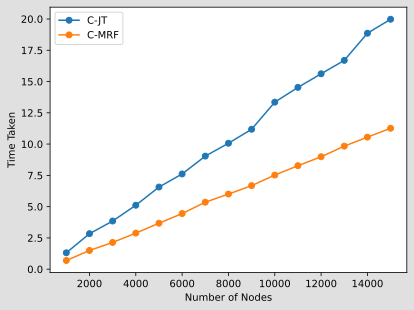

In [18]:
print(CJT_times)
print(CLBP_times)

import matplotlib.pyplot as plt

plt.plot(num_of_nodes, CJT_times_15000, marker='o', label='C-JT')
plt.plot(num_of_nodes, CMRF_times, marker='o', label='C-MRF')

plt.xlabel('Number of Nodes')
plt.ylabel('Time Taken')
#plt.title('Time Taken vs Number of Nodes')
plt.legend()

plt.show()

In [ ]:
gnb.showBN(bns[0])
mrf = MarkovRandomField.fromBN(bns[0])
gnb.showMRF(mrf)
inf_engine = gum.ShaferShenoyMRFInference(mrf)

print(mrf.nodes())

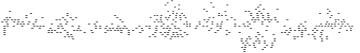

In [71]:
## Perform Shafer-Shenoy inference
#n = 1200
#num_of_clusters = int(n/40)

#high_level = create_random_bn(num_of_clusters, 3, False)
n = 10

sns, _, test_bn = create_k_subnetworks(n, 40, 4)
gnb.showBN(test_bn)

In [72]:
inf_engine = gum.ShaferShenoyInference(test_bn)
#gnb.show(inf_engine.junctionTree())
#print(inf_engine.getNumberOfThreads())

In [73]:
start = time.time()
inf_engine.addAllTargets()
inf_engine.makeInference()
end = time.time()

In [74]:
add = end - start
start = time.time()
for i in range(n*40):
    inf_engine.posterior(f'Node{i}')
end = time.time()
print(end-start)
print(add)
print(end - start + add)

0.7478947639465332
0.29189324378967285
1.039788007736206


In [11]:
shafer_shenoy_times = []
num_of_nodes = list(range(400, 401, 80))
for n in num_of_nodes:
    times = []
    for _ in range(1):
        _, _, test_bn = create_k_subnetworks(int(n/40), 40, 3)
        inf_engine = gum.ShaferShenoyInference(test_bn)
        start = time.time()
        inf_engine.makeInference()
        for i in range(n):
            print(inf_engine.posterior(f'Node{i}'))
        end = time.time()
        times.append(end-start)
        print(n)
        print(end-start)
    shafer_shenoy_times.append(np.mean(times))
print("FINISHED")


  Node0            |
0        |1        |
---------|---------|
 0.4235  | 0.5765  |


  Node1            |
0        |1        |
---------|---------|
 0.7029  | 0.2971  |


  Node2            |
0        |1        |
---------|---------|
 0.4616  | 0.5384  |


  Node3            |
0        |1        |
---------|---------|
 0.6831  | 0.3169  |


  Node4            |
0        |1        |
---------|---------|
 0.3107  | 0.6893  |


  Node5            |
0        |1        |
---------|---------|
 0.4695  | 0.5305  |


  Node6            |
0        |1        |
---------|---------|
 0.5449  | 0.4551  |


  Node7            |
0        |1        |
---------|---------|
 0.3907  | 0.6093  |


  Node8            |
0        |1        |
---------|---------|
 0.6069  | 0.3931  |


  Node9            |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node10           |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node11           |
0        |1        |
---------|-


  Node326          |
0        |1        |
---------|---------|
 0.4168  | 0.5832  |


  Node327          |
0        |1        |
---------|---------|
 0.4668  | 0.5332  |


  Node328          |
0        |1        |
---------|---------|
 0.5943  | 0.4057  |


  Node329          |
0        |1        |
---------|---------|
 0.3344  | 0.6656  |


  Node330          |
0        |1        |
---------|---------|
 0.5678  | 0.4322  |


  Node331          |
0        |1        |
---------|---------|
 0.5668  | 0.4332  |


  Node332          |
0        |1        |
---------|---------|
 0.2953  | 0.7047  |


  Node333          |
0        |1        |
---------|---------|
 0.5459  | 0.4541  |


  Node334          |
0        |1        |
---------|---------|
 0.3399  | 0.6601  |


  Node335          |
0        |1        |
---------|---------|
 0.1593  | 0.8407  |


  Node336          |
0        |1        |
---------|---------|
 0.6076  | 0.3924  |


  Node337          |
0        |1        |
---------|-

In [83]:
n = 500  # Number of nodes
m = 4  # Maximum number of parents per node

bn = create_random_bn(n, m, True)
# Perform Loopy Belief Propagation
#evidence = {'Node0': 1}

In [84]:
inf_engine = gum.LoopyBeliefPropagation(bn)
#inf_engine.setMaxTime = 100
#inf_engine.setMaxIter(2*n)
#inf_engine.setMinEpsilonRate(0.2)
start = time.time()
inf_engine.setPeriodSize(200)
#inf_engine.setEvidence(evidence)
inf_engine.makeInference()
for i in range(n):
    inf_engine.posterior(f'Node{i}')
end = time.time()

print(end - start)

10.021608352661133


In [13]:
JT_times = []
num_of_nodes = [120]
for n in num_of_nodes:
    bn = create_random_bn(n, 3, True)
    start = time.time()
    inf_engine = gum.ShaferShenoyInference(bn)
    #inf_engine.setEvidence(evidence)
    inf_engine.makeInference()
    for i in range(n):
        print(inf_engine.posterior(f'Node{i}'))
    end = time.time()
    JT_times.append(end-start)


  Node0            |
0        |1        |
---------|---------|
 0.5138  | 0.4862  |


  Node1            |
0        |1        |
---------|---------|
 0.4816  | 0.5184  |


  Node2            |
0        |1        |
---------|---------|
 0.2253  | 0.7747  |


  Node3            |
0        |1        |
---------|---------|
 0.7282  | 0.2718  |


  Node4            |
0        |1        |
---------|---------|
 0.7644  | 0.2356  |


  Node5            |
0        |1        |
---------|---------|
 0.5964  | 0.4036  |


  Node6            |
0        |1        |
---------|---------|
 0.7423  | 0.2577  |


  Node7            |
0        |1        |
---------|---------|
 0.9009  | 0.0991  |


  Node8            |
0        |1        |
---------|---------|
 0.8050  | 0.1950  |


  Node9            |
0        |1        |
---------|---------|
 0.2610  | 0.7390  |


  Node10           |
0        |1        |
---------|---------|
 0.5116  | 0.4884  |


  Node11           |
0        |1        |
---------|-

KeyboardInterrupt: 

In [ ]:
print(JT_times)

Markov Random Field Testing (Not Currently Working!)

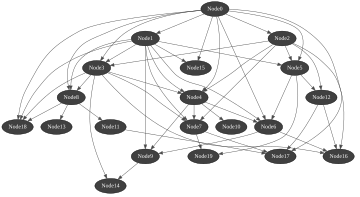

[{1, 2, 3, 4, 7}, {0, 7, 11, 12, 17}, {19, 5, 7}, {9, 4, 6, 1}, {8, 1, 3, 0}, {0, 1, 4, 5, 6}, {0, 1, 2, 5}, {0, 1, 2, 3, 4}, {0, 1, 2, 3}, {9, 3, 14}, {0, 1, 15}, {0, 1, 3, 8, 18}, {8, 11}, {0, 1}, {2, 12, 5}, {8, 13}, {2, 3, 6, 12, 16}, {10, 4}, {0, 2}, {0}]


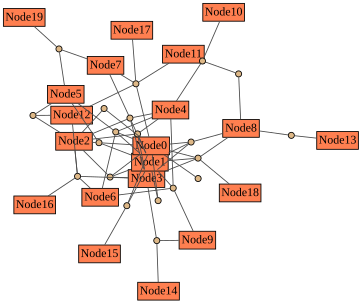

In [29]:
bn = create_random_bn(20, 4, True)
mrf = MarkovRandomField.fromBN(bn)
gnb.show(bn)
print(mrf.factors())
gnb.show(mrf)

In [38]:
print(mrf.factor({19, 5, 7}))


             ||  Node19           |
Node5 |Node7 ||0        |1        |
------|------||---------|---------|
0     |0     || 0.8620  | 0.1380  |
1     |0     || 0.0217  | 0.9783  |
0     |1     || 0.9257  | 0.0743  |
1     |1     || 0.9396  | 0.0604  |



In [16]:
bn = create_random_bn(90, 4, True)
mrf = MarkovRandomField.fromBN(bn)

In [17]:
#values = list(range(10, 200, 10))
#values = list(range(200, 201, 7))

#for n in values:
    #bn = create_random_bn(n, 4, True)

start = time.time()
inf_engine = gum.ShaferShenoyMRFInference(mrf)
# Perform Shafer-Shenoy inference
inf_engine.makeInference()
for j in range(len(mrf.nodes())):
    print(inf_engine.posterior(j))
end = time.time()
#print(n)
print(end - start)


  Node0            |
0        |1        |
---------|---------|
 0.5390  | 0.4610  |


  Node1            |
0        |1        |
---------|---------|
 0.5853  | 0.4147  |


  Node2            |
0        |1        |
---------|---------|
 0.3761  | 0.6239  |


  Node3            |
0        |1        |
---------|---------|
 0.5730  | 0.4270  |


  Node4            |
0        |1        |
---------|---------|
 0.4128  | 0.5872  |


  Node5            |
0        |1        |
---------|---------|
 0.2734  | 0.7266  |


  Node6            |
0        |1        |
---------|---------|
 0.4585  | 0.5415  |


  Node7            |
0        |1        |
---------|---------|
 0.6069  | 0.3931  |


  Node8            |
0        |1        |
---------|---------|
 0.4817  | 0.5183  |


  Node9            |
0        |1        |
---------|---------|
 0.4255  | 0.5745  |


  Node10           |
0        |1        |
---------|---------|
 0.4569  | 0.5431  |


  Node11           |
0        |1        |
---------|-

In [13]:
inf_engine = gum.ShaferShenoyInference(bn)

start = time.time()
inf_engine.makeInference()
for j in range(len(mrf.nodes())):
    print(inf_engine.posterior(j))
end = time.time()

print(end - start)


  Node0            |
0        |1        |
---------|---------|
 0.3542  | 0.6458  |


  Node1            |
0        |1        |
---------|---------|
 0.5845  | 0.4155  |


  Node2            |
0        |1        |
---------|---------|
 0.5263  | 0.4737  |


  Node3            |
0        |1        |
---------|---------|
 0.2693  | 0.7307  |


  Node4            |
0        |1        |
---------|---------|
 0.4167  | 0.5833  |


  Node5            |
0        |1        |
---------|---------|
 0.4444  | 0.5556  |


  Node6            |
0        |1        |
---------|---------|
 0.4477  | 0.5523  |


  Node7            |
0        |1        |
---------|---------|
 0.2695  | 0.7305  |


  Node8            |
0        |1        |
---------|---------|
 0.4631  | 0.5369  |


  Node9            |
0        |1        |
---------|---------|
 0.4861  | 0.5139  |


  Node10           |
0        |1        |
---------|---------|
 0.3959  | 0.6041  |


  Node11           |
0        |1        |
---------|-

This code below creates an array of Clustered BN's which holds 15 of each size of Bayesian network where the number of clusters range in size from 2 to 20.

In [ ]:
bns = np.empty((15, 19), dtype=object)
for j in range(19):
    for i in range(15):
        _, _, bns[i][j] = create_k_subnetworks(2+j , 50, 3)

In [ ]:
num_of_nodes = list(range(100, 800, 50))
average_lbp_times = []
average_jt_times = []
average_mrf_times = []

for j in range(15):
    lbp_times = []
    jt_times = []
    mrf_times = []
    for i in range(15):
        lbp_ie = gum.LoopyBeliefPropagation(bns[i][j])
        lbp_ie.setPeriodSize(200)
        jt_ie = gum.ShaferShenoyInference(bns[i][j])
        mrf = MarkovRandomField.fromBN(bns[i][j])
        mrf_ie = gum.ShaferShenoyMRFInference(mrf)
        
        start = time.time()
        lbp_ie.makeInference()
        for k in range(len(bns[i][j].nodes())):
            lbp_ie.posterior(k)
        end = time.time()
        lbp_times.append(end - start)
        
        start = time.time()
        jt_ie.makeInference()
        for k in range(len(bns[i][j].nodes())):
            jt_ie.posterior(k)
        end = time.time()
        jt_times.append(end - start)
        
        start = time.time()
        mrf_ie.makeInference()
        for k in range(len(bns[i][j].nodes())):
            mrf_ie.posterior(k)
        end = time.time()
        mrf_times.append(end - start)
    
    print(f"For network of size {(j+2) * 50}")
    print(np.mean(lbp_times))
    print(np.mean(jt_times))
    print(np.mean(mrf_times))
    
    average_lbp_times.append(np.mean(lbp_times))
    average_jt_times.append(np.mean(jt_times))
    average_mrf_times.append(np.mean(mrf_times))

For network of size 100
1.30251096089681
0.14668544133504233
0.06452738444010417
For network of size 150
1.9569541931152343
0.18844456672668458
0.08870182037353516
For network of size 200
2.6674367904663088
0.28009851773579914
0.12553566296895344
For network of size 250
3.319344679514567
0.3567193984985352
0.1675759474436442
For network of size 300
4.021577580769857
0.45379873911539714
0.20492396354675294
For network of size 350
4.7391967137654625
0.5272402922312419
0.23995447158813477
For network of size 400
5.413199345270793
0.7081705252329509
0.3289299488067627
For network of size 450
6.25179500579834
0.8514018535614014
0.39440835316975914
For network of size 500
7.248172680536906
1.303295342127482
0.5903433322906494
For network of size 550
7.924029954274496
1.4298561255137126
0.6526971340179444
For network of size 600
8.98086830774943
2.1157715479532877
0.8003341674804687
For network of size 650
9.376155185699464
2.520242675145467
1.2335134029388428
For network of size 700
10.32225

In [ ]:
for _ in range(10):
    _, _, bn = create_k_subnetworks(16, 50, 4)
    start = time.time()
    ie = gum.ShaferShenoyInference(bn)
    #ie = gum.LoopyBeliefPropagation(bn)
    #ie.setPeriodSize(200)
    ie.makeInference()
    for i in range(len(bn.nodes())):
        print(ie.posterior(i))
    end = time.time()
    print(end - start)


  Node0            |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node1            |
0        |1        |
---------|---------|
 0.3445  | 0.6555  |


  Node2            |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node3            |
0        |1        |
---------|---------|
 0.4417  | 0.5583  |


  Node4            |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node5            |
0        |1        |
---------|---------|
 0.5623  | 0.4377  |


  Node6            |
0        |1        |
---------|---------|
 0.0397  | 0.9603  |


  Node7            |
0        |1        |
---------|---------|
 0.4578  | 0.5422  |


  Node8            |
0        |1        |
---------|---------|
 0.4557  | 0.5443  |


  Node9            |
0        |1        |
---------|---------|
 0.5840  | 0.4160  |


  Node10           |
0        |1        |
---------|---------|
 0.7832  | 0.2168  |


  Node11           |
0        |1        |
---------|-


  Node126          |
0        |1        |
---------|---------|
 0.4037  | 0.5963  |


  Node127          |
0        |1        |
---------|---------|
 0.4530  | 0.5470  |


  Node128          |
0        |1        |
---------|---------|
 0.1539  | 0.8461  |


  Node129          |
0        |1        |
---------|---------|
 0.4153  | 0.5847  |


  Node130          |
0        |1        |
---------|---------|
 0.5837  | 0.4163  |


  Node131          |
0        |1        |
---------|---------|
 0.4347  | 0.5653  |


  Node132          |
0        |1        |
---------|---------|
 0.5536  | 0.4464  |


  Node133          |
0        |1        |
---------|---------|
 0.5782  | 0.4218  |


  Node134          |
0        |1        |
---------|---------|
 0.6839  | 0.3161  |


  Node135          |
0        |1        |
---------|---------|
 0.6227  | 0.3773  |


  Node136          |
0        |1        |
---------|---------|
 0.4174  | 0.5826  |


  Node137          |
0        |1        |
---------|-


  Node244          |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node245          |
0        |1        |
---------|---------|
 0.5243  | 0.4757  |


  Node246          |
0        |1        |
---------|---------|
 0.5773  | 0.4227  |


  Node247          |
0        |1        |
---------|---------|
 0.6470  | 0.3530  |


  Node248          |
0        |1        |
---------|---------|
 0.4018  | 0.5982  |


  Node249          |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node250          |
0        |1        |
---------|---------|
 0.6160  | 0.3840  |


  Node251          |
0        |1        |
---------|---------|
 0.3916  | 0.6084  |


  Node252          |
0        |1        |
---------|---------|
 0.4260  | 0.5740  |


  Node253          |
0        |1        |
---------|---------|
 1.0000  | 0.0000  |


  Node254          |
0        |1        |
---------|---------|
 0.5168  | 0.4832  |


  Node255          |
0        |1        |
---------|-


  Node377          |
0        |1        |
---------|---------|
 0.4662  | 0.5338  |


  Node378          |
0        |1        |
---------|---------|
 0.3682  | 0.6318  |


  Node379          |
0        |1        |
---------|---------|
 0.4871  | 0.5129  |


  Node380          |
0        |1        |
---------|---------|
 0.7002  | 0.2998  |


  Node381          |
0        |1        |
---------|---------|
 0.5256  | 0.4744  |


  Node382          |
0        |1        |
---------|---------|
 0.5077  | 0.4923  |


  Node383          |
0        |1        |
---------|---------|
 0.5517  | 0.4483  |


  Node384          |
0        |1        |
---------|---------|
 0.4565  | 0.5435  |


  Node385          |
0        |1        |
---------|---------|
 0.4563  | 0.5437  |


  Node386          |
0        |1        |
---------|---------|
 0.5484  | 0.4516  |


  Node387          |
0        |1        |
---------|---------|
 0.4736  | 0.5264  |


  Node388          |
0        |1        |
---------|-


  Node504          |
0        |1        |
---------|---------|
 0.5082  | 0.4918  |


  Node505          |
0        |1        |
---------|---------|
 0.6247  | 0.3753  |


  Node506          |
0        |1        |
---------|---------|
 0.5857  | 0.4143  |


  Node507          |
0        |1        |
---------|---------|
 0.5178  | 0.4822  |


  Node508          |
0        |1        |
---------|---------|
 0.4120  | 0.5880  |


  Node509          |
0        |1        |
---------|---------|
 0.5858  | 0.4142  |


  Node510          |
0        |1        |
---------|---------|
 0.4878  | 0.5122  |


  Node511          |
0        |1        |
---------|---------|
 0.5005  | 0.4995  |


  Node512          |
0        |1        |
---------|---------|
 0.3925  | 0.6075  |


  Node513          |
0        |1        |
---------|---------|
 0.2206  | 0.7794  |


  Node514          |
0        |1        |
---------|---------|
 0.7069  | 0.2931  |


  Node515          |
0        |1        |
---------|-


  Node615          |
0        |1        |
---------|---------|
 0.4832  | 0.5168  |


  Node616          |
0        |1        |
---------|---------|
 0.5211  | 0.4789  |


  Node617          |
0        |1        |
---------|---------|
 0.5186  | 0.4814  |


  Node618          |
0        |1        |
---------|---------|
 0.4672  | 0.5328  |


  Node619          |
0        |1        |
---------|---------|
 0.3529  | 0.6471  |


  Node620          |
0        |1        |
---------|---------|
 0.4196  | 0.5804  |


  Node621          |
0        |1        |
---------|---------|
 0.6149  | 0.3851  |


  Node622          |
0        |1        |
---------|---------|
 0.4137  | 0.5863  |


  Node623          |
0        |1        |
---------|---------|
 0.4437  | 0.5563  |


  Node624          |
0        |1        |
---------|---------|
 0.5207  | 0.4793  |


  Node625          |
0        |1        |
---------|---------|
 0.6804  | 0.3196  |


  Node626          |
0        |1        |
---------|-


  Node768          |
0        |1        |
---------|---------|
 0.6868  | 0.3132  |


  Node769          |
0        |1        |
---------|---------|
 0.5699  | 0.4301  |


  Node770          |
0        |1        |
---------|---------|
 0.6546  | 0.3454  |


  Node771          |
0        |1        |
---------|---------|
 0.6282  | 0.3718  |


  Node772          |
0        |1        |
---------|---------|
 0.4430  | 0.5570  |


  Node773          |
0        |1        |
---------|---------|
 0.4144  | 0.5856  |


  Node774          |
0        |1        |
---------|---------|
 0.3115  | 0.6885  |


  Node775          |
0        |1        |
---------|---------|
 0.2390  | 0.7610  |


  Node776          |
0        |1        |
---------|---------|
 0.6598  | 0.3402  |


  Node777          |
0        |1        |
---------|---------|
 0.1992  | 0.8008  |


  Node778          |
0        |1        |
---------|---------|
 0.4895  | 0.5105  |


  Node779          |
0        |1        |
---------|-

In [ ]:
bn = create_random_bn(100, 4, True)
mrf = MarkovRandomField.fromBN(bn)
start = time.time()
mrf_ie = gum.ShaferShenoyMRFInference(mrf)
mrf_ie.makeInference()
for k in range(len(bn.nodes())):
    mrf_ie.posterior(k)
end = time.time()
print(end-start)

In [20]:
bns = np.empty((20, 13), dtype=object)
for i in range(20):
    for j in range(1, 14):
        bns[i][j-1] = create_random_bn(j*10, 4, True)

In [25]:
average_lbp_times = []
average_lgs_times = []
average_mrf_times = []
for j in range(13):
    lbp_times = []
    lgs_times = []
    mrf_times = []
    for i in range(20):
        lbp_ie = gum.LoopyBeliefPropagation(bns[i][j])
        lbp_ie.setPeriodSize(200)
        lgs_ie = gum.LoopyGibbsSampling(bns[i][j])
        lgs_ie.setPeriodSize(200)
        
        start = time.time()
        lbp_ie.makeInference()
        for k in range(len(bns[i][j].nodes())):
            lbp_ie.posterior(k)
        end = time.time()
        lbp_times.append(end - start)
        
        if j <= 14: 
            start = time.time()
            lgs_ie.makeInference()
            for k in range(len(bns[i][j].nodes())):
                lgs_ie.posterior(k)
            end = time.time()
            lgs_times.append(end - start)

        """if j <= 14:
            start = time.time()
            mrf = MarkovRandomField.fromBN(bns[i][j])
            mrf_ie = gum.ShaferShenoyMRFInference(mrf)
            mrf_ie.makeInference()
            for k in range(len(bns[i][j].nodes())):
                mrf_ie.posterior(k)
            end = time.time()
            mrf_times.append(end - start)"""
    
    print(f"For network of size {(j+1) * 10}")
    print(np.mean(lbp_times))
    print(np.mean(lgs_times))
    #print(np.mean(mrf_times))
    
    average_lbp_times.append(np.mean(lbp_times))
    if j <= 14:
        average_lgs_times.append(np.mean(lgs_times))
"""    if j <= 14:
        average_mrf_times.append(np.mean(mrf_times))"""

For network of size 10
0.11989561319351197
0.049366295337677
For network of size 20
0.31064424514770506
0.11785386800765991
For network of size 30
0.4999589204788208
0.16574956178665162
For network of size 40
0.7062692403793335
0.24883553981781006
For network of size 50
0.893854296207428
0.31774383783340454
For network of size 60
1.0686793088912965
0.39648454189300536
For network of size 70
1.2914215683937074
0.548880112171173
For network of size 80
1.452834129333496
0.653851842880249
For network of size 90
1.7176123023033143
0.7857150435447693
For network of size 100
1.8241370916366577
0.8283780932426452
For network of size 110
2.091004657745361
0.9723257064819336
For network of size 120
2.362033021450043
1.1135061383247375
For network of size 130
2.512336242198944
1.2377732515335083


'    if j <= 14:\n        average_mrf_times.append(np.mean(mrf_times))'

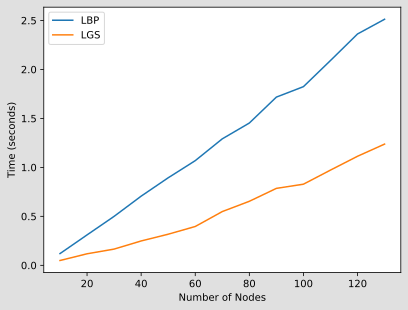

In [26]:
plt.plot(range(10, 131, 10), average_lbp_times, label=f"LBP")
plt.plot(range(10, 131, 10), average_lgs_times, label=f"LGS")

plt.legend()
plt.xlabel('Number of Nodes')
plt.ylabel('Time (seconds)')
plt.show()


In [11]:
print(average_lbp_times)
print(average_jt_times)
print(average_mrf_times)

[0.24670335451761882, 0.6406134764353434, 0.9692592302958171, 1.4106491724650065, 1.7824533621470133, 2.2686403433481854, 2.680996863047282, 3.260039488474528, 3.5632448832194012, 3.7593765258789062, 4.315444612503052]
[0.00880893071492513, 0.031726408004760745, 0.077044677734375, 0.17345511118570964, 0.37645764350891114, 0.760551643371582, 1.9436100800832112, 15.63597224553426]
[0.004978481928507487, 0.016356118520100913, 0.038790162404378256, 0.06550402641296386, 0.10889267921447754, 0.2530267874399821, 0.5180054823557536, 2.211865997314453]


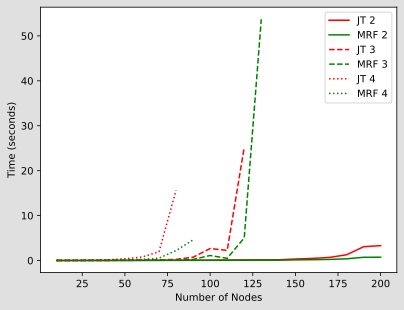

In [19]:
import matplotlib.pyplot as plt

# Data
#plt.yscale('log')
line_style = ['-', '--', ':']
graph_sizes = [2, 3, 4]

# Plotting
for i in range(len(graph_sizes)):
    plt.plot(range(10, 10 * len(average_jt_times[i]) + 1, 10), average_jt_times[i], linestyle=line_style[i], color='red', label=f"JT {graph_sizes[i]}")
    plt.plot(range(10, 10 * len(average_mrf_times[i]) + 1, 10), average_mrf_times[i], linestyle=line_style[i], color='green', label=f"MRF {graph_sizes[i]}")

plt.xlabel('Number of Nodes')
plt.ylabel('Time (seconds)')

# Adding a legend
plt.legend()

# Display the plot
plt.show()

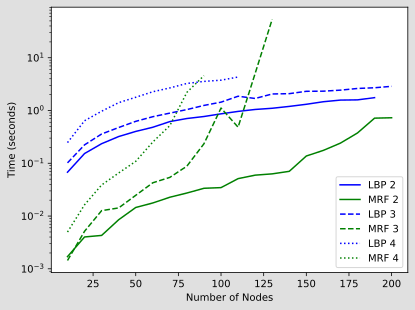

In [20]:
# Data
plt.yscale('log')
line_style = ['-', '--', ':']
graph_sizes = [2, 3, 4]

for i in range(len(graph_sizes)):
    plt.plot(range(10, 10 * len(average_lbp_times[i]) + 1, 10), average_lbp_times[i], linestyle=line_style[i], color='blue', label=f"LBP {graph_sizes[i]}")
    plt.plot(range(10, 10 * len(average_mrf_times[i]) + 1, 10), average_mrf_times[i], linestyle=line_style[i], color='green', label=f"MRF {graph_sizes[i]}")

plt.xlabel('Number of Nodes')
plt.ylabel('Time (seconds)')

# Adding a legend
plt.legend()

# Display the plot
plt.show()